In [1]:
import sys

sys.path.append("..")

%load_ext autoreload
%autoreload complete

In [2]:
from pathlib import Path
import pickle
import json
from itertools import chain, pairwise
import string

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import xarray as xr
import cf_xarray as cfxr
import cfr
import cmocean
import nc_time_axis
import regionmask
import cartopy
from distributed import Client
import scipy
import dask
import sklearn
import seaborn as sns
import pyleoclim
import xrscipy.integrate

import lmrecon
from lmrecon.io import open_mfdataset, get_base_path
from lmrecon.util import (
    get_data_path,
    subsample_ensemble,
    is_ocean_field,
    get_esgf_path
)
from lmrecon.stats import (
    area_weighted_mean,
    rmse,
    mse,
    ce,
    average_annually,
    average_seasonally,
    anomalize,
    area_weighted_rmse,
    annualize_seasonal_data,
    anomalize,
    regress_field,
    regress_scalar,
    detrend_polynomial,
    compute_correlation_significance,
    compute_sliding_window_trend
)
from lmrecon.time import convert_tuple_to_decimal_year, Season, use_tuple_time_coords, use_decimal_year_time_coords, convert_datetime_to_decimal_year, add_season_coords, format_tuple_time, shift_to_year_middle
from lmrecon.plotting import plot_field, add_subplot_headers, format_plot, get_field_label, get_field_unit, subplots_cartopy, shade_ci, shade_hdi, use_zero_ylim, use_zero_xlim, plot_hovmoeller, get_field_shorthand_label, save_plot, get_field_scaling, add_panel_label, adjust_color_lightness, set_yaxis_color
from lmrecon.grid import GLOBAL_GRID, Regridder
from lmrecon.datasets import *
from lmrecon.indices import *
from lmrecon.signal import lowpass_filter, get_spectral_nullhypothesis, compute_spectrum_multitaper, compute_spharm_spectrum_multitaper, compute_lag_correlations
from lmrecon.units import calculate_sistatistics, convert_ohc_per_ocean_area_to_total_ohc, convert_total_ohc_to_ohc_per_surface_area, convert_ohc_per_surface_area_to_total_ohc
from lmrecon.plotting_config import set_plotting_theme
from lmrecon.constants import *

In [3]:
set_plotting_theme(publication=True)

In [4]:
plot_folder_pub = Path("/Users/dstiller/dev/documents/paper1-da/figures")
plot_folder_si = Path("/Users/dstiller/dev/documents/paper1-da/supplement/figures")

# https://www.ametsoc.org/ams/publications/author-information/figure-information-for-authors/
# Text width JClim
figsize_fullwidth_inline = (5.5, 2.5)
# Text width JClim, full height
figsize_fullwidth_fullpage = (5.5, 8)
# Half text width JClim
figsize_halfwidth_inline = (3.2, 2.5)
# Over width (text + margin) JClim
figsize_overwidth_inline = (6.48, 2.5)
# Text width JClim, full height
figsize_overwidth_fullpage = (6.48, 8)

In [5]:
# client.shutdown()
# client = Client(n_workers=dask.system.CPU_COUNT, threads_per_worker=1)

In [6]:
def _merge_siconc(ds):
    if "lat" in ds.dims:
        ds["siconc"] = xr.concat([ds["siconcs"].sel(lat=slice(-90, 0)), ds["siconcn"].sel(lat=slice(0, 90))], dim="lat")
    else:
        ds["siconc"] = ds["siconcn"] + ds["siconcs"]

    ds = ds.drop_vars(["siconcn", "siconcs"])
    # Do not return, would only overwrite loop variable

def load_run(id):
    rundir = get_data_path() / f"reconstructions/{id}"

    pdb = pickle.load((rundir / "pdb_full.pkl").open("rb")) 

    posterior_regional_means = open_mfdataset(rundir / "posterior_regional_means").rename(eei="eei_direct")
    posterior_zonal_means = open_mfdataset(rundir / "posterior_zonal_means").rename(eei="eei_direct")
    posterior_mean = open_mfdataset(rundir / "posterior_mean").rename(eei="eei_direct")
    posterior_var = open_mfdataset(rundir / "posterior_var").rename(eei="eei_direct")
    posterior_indices = open_mfdataset(rundir / "posterior_indices")

    for ds in [posterior_regional_means, posterior_zonal_means, posterior_mean, posterior_var]:
        _merge_siconc(ds)
        # Cannot .rename(eei="eei_direct") here because it's not in place
        ds["eei"] = -(ds["rsut"] + ds["rlut"])

    if (rundir / "verification_annual_assimilated.nc").exists():
        verification_proxies = [
            xr.open_dataset(rundir / f"verification_{type}.nc")
            for type in [
                "seasonal_assimilated",
                "annual_assimilated",
                "seasonal_withheld",
                "annual_withheld",
            ]
        ]
        verification_proxies = [
            xr.merge([
                proxies, anomalize(proxies, (1961, 1991)).rename(dict(true="true_anoms", estimated="estimated_anoms"))
            ])
            for proxies in verification_proxies
        ]
    else:
        verification_proxies = None

    fields = list(posterior_regional_means.keys())

    return (
        fields,
        posterior_regional_means,
        posterior_zonal_means,
        posterior_mean,
        posterior_var,
        posterior_indices,
        verification_proxies,
        pdb,
    )

In [7]:
run_ids = [
    "MPI-mc",
    "CESM-mc",
    "MRI-mc",
]
# labels = ["MPI-ESM1-2-LR", "CESM2-WACCM-FV2", "MRI-ESM2-0"]
labels = ["MPI-DA", "CESM-DA", "MRI-DA"]


fields, posterior_regional_means, posterior_zonal_means, posterior_mean, posterior_var, posterior_indices, verification_proxies, pdbs = zip(*[
    load_run(id) for id in run_ids
])
posterior_global_means = [p.sel(region="global") for p in posterior_regional_means]
# Grand ensemble
posterior_regional_means_gens = xr.concat(posterior_regional_means, dim="model").rename(ens="ens_orig").stack(ens=["ens_orig", "model"])
posterior_global_means_gens = posterior_regional_means_gens.sel(region="global")
posterior_zonal_means_gens = xr.concat(posterior_zonal_means, dim="model").rename(ens="ens_orig").stack(ens=["ens_orig", "model"])
posterior_indices_gens = xr.concat(posterior_indices, dim="model").rename(ens="ens_orig").stack(ens=["ens_orig", "model"])
posterior_mean_gens = xr.concat(posterior_mean, dim="model").mean("model", skipna=True)
posterior_var_gens = xr.concat(posterior_var, dim="model").mean("model", skipna=True)
verification_proxies_gens = [xr.concat([vp[i] for vp in verification_proxies], dim="model") for i in range(4)]

pdb = cfr.ProxyDatabase(dict(chain.from_iterable(pdb.records.items() for pdb in pdbs)))
pdo_index = PDOIndex.load(get_base_path() / "datasets/temperature/ERSST5/pdo_index.pkl")

fields = fields[0]

In [11]:
def load_run_ppe(id):
    rundir = get_data_path() / f"reconstructions/{id}"
    with (rundir / "metadata.json").open("r") as f:
        metadata = json.load(f)
    obs_path = get_data_path() / metadata["obs_dataset"]

    posterior_regional_means = open_mfdataset(rundir / "posterior_regional_means").rename(eei="eei_direct")
    posterior_mean = open_mfdataset(rundir / "posterior_mean").rename(eei="eei_direct")

    with (obs_path / "metadata.json").open("r") as f:
        metadata_obs = json.load(f)
        true_dataset = get_data_path() / metadata_obs["true_dataset"]
    ds_ver= xr.open_zarr(true_dataset)
    
    ds_ver = use_decimal_year_time_coords(
        xr.align(use_tuple_time_coords(ds_ver), use_tuple_time_coords(posterior_regional_means), join="inner")
    [0])

    for ds in [posterior_regional_means, posterior_mean]:
        ds["eei"] = -(ds["rsut"] + ds["rlut"])

    return (
        ds_ver,
        posterior_regional_means,
        posterior_mean,
    )

# MIROC truth
ppe_run_ids = [
    "2025-08-25T18-11-17",
    "2025-08-25T18-00-07",
    "2025-08-25T18-12-16",
]

ppe_ver, ppe_posterior_regional_means, ppe_posterior_mean = zip(*[
    load_run_ppe(id) for id in ppe_run_ids
])
ppe_ver = ppe_ver[0]
# Grand ensemble
ppe_posterior_regional_means_gens = xr.concat(ppe_posterior_regional_means, dim="model").rename(ens="ens_orig").stack(ens=["ens_orig", "model"])
ppe_posterior_mean_gens = xr.concat(ppe_posterior_mean, dim="model").mean("model", skipna=True)

In [12]:
sims_models = []
models = ["MPI-ESM1-2-LR", "CESM2", "MRI-ESM2-0", "MIROC-ES2L"]
for model in models:
    # experiment = "historical"
    # experiment = "past2k" if model.startswith("MPI") else "past1000"
    experiment = "past2k_historical" if model.startswith("MPI") else "past1000_historical"
    sims_models.append(xr.open_zarr(get_data_path() / "cmip6" / model / experiment / "seasonal_anomalies.zarr").sel(time=slice(840, None)))
sims_models_gens = use_decimal_year_time_coords(
    xr.concat([use_tuple_time_coords(ds) for ds in sims_models], dim="model", join="inner")
)

In [13]:
ds_anna = load_anna()
ds_zanna = load_zanna()
ds_hadcrut = load_hadcrut()
ds_hadisst = load_hadisst()
ds_ersst = load_ersst()
ds_cobesst = load_cobesst()
ds_gistemp = load_gistemp()
ds_modera = load_modera()
ds_pages19 = load_pages19()
ds_cooper25 = load_cooper25()
ds_erbe = load_erbe_wfov()
ds_erbe_global_mean = load_erbe_wfov_global_mean()
ds_ceresgm = load_ceresgm()
ds_deepc = load_deepc()
ds_deepc_annual = load_deepc(True)
ds_brennan = xr.concat(
    (load_brennan22(prior).assign_coords(model=prior) for prior in ["CCSM4", "MPI"]),
    dim="model"
)
ds_dalaiden2023 = load_dalaiden2023()
ds_sic = load_cdr_sic()
ds_haden = load_haden4()
ds_wu25 = load_wu2025()
ds_gebbie19 = load_gebbie2019()
ds_cheng2017 = load_cheng2017()
ds_smith2025_eei = load_smith2025_eei()
ds_ps2004 = load_ps2004()
ds_walsh19 = load_walsh19()
ds_evolv2k = load_evolv2k().sel(time=slice(np.datetime64("0850"), None))
ds_eruptions = load_combined_eruptions()
ds_meng25 = xr.concat(
    (load_meng25(prior).assign_coords(ens=prior) for prior in ["CCSM4", "CESM1", "MPI-ESM-R"]),
    dim="ens"
)

In [14]:
eei_cam = xr.open_dataset("/Users/dstiller/data/lmrecon/datasets/radiation/restom.nc").to_dataarray().squeeze().sel(ens=[0, 4, 5]).mean("ens")
eei_cam_pif = xr.open_dataset("/Users/dstiller/data/lmrecon/datasets/radiation/restom_piforcing.nc").to_dataarray().squeeze().sel(ens=[0, 4, 5]).mean("ens")

ds_amip = anomalize(xr.open_dataset("/Users/dstiller/data/lmrecon/datasets/radiation/amip_radiation.nc"), (1961, 1990))

# PPE

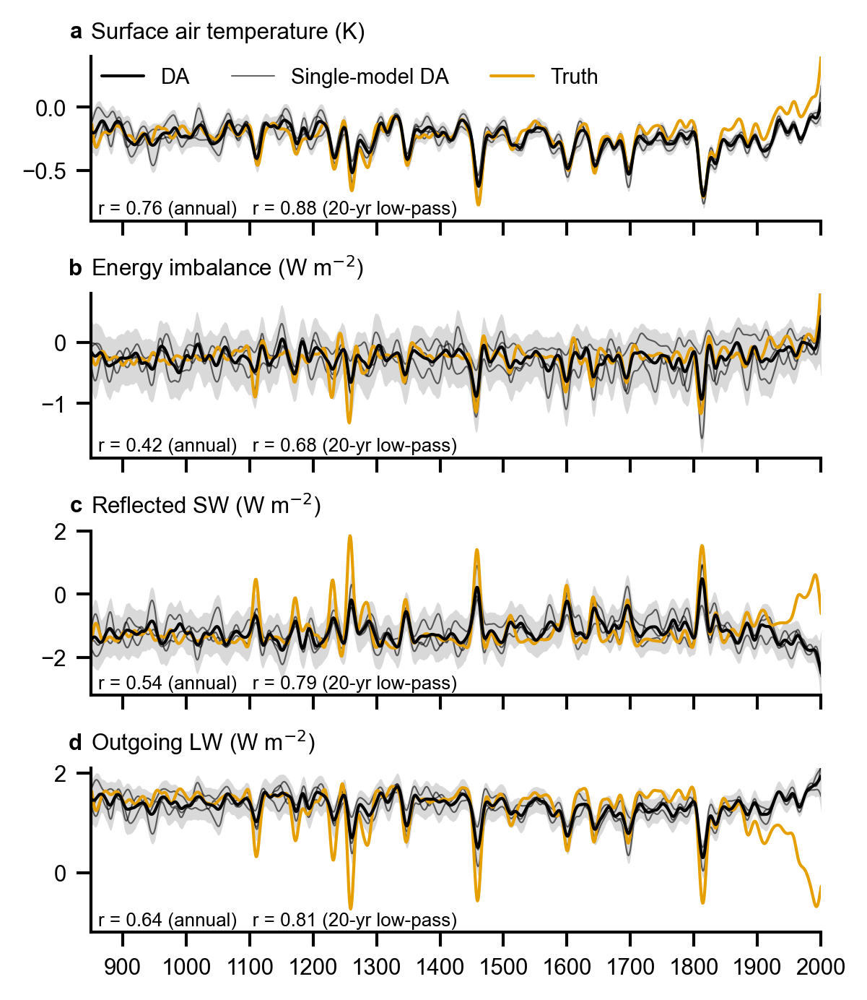

In [12]:
def plot_ppe_corr_gm():
    fields = ["tas", "eei", "rsut", "rlut"]
    smoothing_years = 20
    
    fig, axs = plt.subplots(len(fields), figsize=(figsize_overwidth_inline[0] * 1.8/3, 4.5), sharex=True)
    axs = axs if isinstance(axs, np.ndarray) else [axs]

    ens = average_annually(ppe_posterior_regional_means_gens[fields].sel(region="global"))
    ver = average_annually(area_weighted_mean(ppe_ver[fields]))
    # Match mean
    # ens = ens - ens.mean("ens").sel(time=slice(1850, 2000)).mean("time") + ver.sel(time=slice(1850, 2000)).mean("time")
    ens = ens - ens.mean("ens").sel(time=slice(850, 1850)).mean("time") + ver.sel(time=slice(850, 1850)).mean("time")

    ens_ann = ens.copy()
    ens = lowpass_filter(ens, smoothing_years)
    ver_ann = ver.copy()
    ver = lowpass_filter(ver, smoothing_years)

    for i, (field, ax) in enumerate(zip(fields, axs)):
        scaling = get_field_scaling(field)

        ax.plot(ens.time, ens[field].mean("ens") / scaling, label="DA", c="black", zorder=2)
        shade_ci(ax, ens[field] / scaling, c="black")

        for m in pd.unique(ppe_posterior_regional_means_gens.model):
            ax.plot(ens.time, ens.sel(model=m)[field].mean("ens_orig") / scaling, c="black",
                    linewidth=0.5, zorder=0.5, alpha=0.6, label="Single-model DA" if m == 0 else None)

        ax.plot(ver.time, ver[field] / scaling, label="Truth", c="C0", zorder=1)
        # ax.plot(ver_ann.time, ver_ann[field], label="Verification (Annual)", c="C1", alpha=0.3)

        # ax.spines.right.set_visible(True)
        # ax.yaxis.set_ticks_position('both')
        # ax.yaxis.set_tick_params(right=True)

        corr_ann = xr.corr(ver_ann[field].sel(time=slice(850, 1850)), ens_ann[field].mean("ens").sel(time=slice(850, 1850)), "time").compute().item()
        # p = 0 actually
        # p_corr_ann = compute_correlation_significance(ver_ann[field], median_ann[field]).compute().item()
        corr = xr.corr(ver[field].sel(time=slice(850, 1850)), ens[field].mean("ens").sel(time=slice(850, 1850)), "time").compute().item()
        ax.text(0.01, 0.02, f"r = {corr_ann:.2f} (annual)   r = {corr:.2f} (20-yr low-pass)",
                transform=ax.transAxes, verticalalignment='bottom', size="small")

        ax.set_title(get_field_label(field, True, scaling))
        add_panel_label(ax, i)

        ax.set_ylim({
            "tas": (-0.9, 0.4),
            "eei": (-1.9, 0.8),
            "rsut": (-3.2, 2.0),
            "rlut": (-1.2, 2.1),
        }[field])

    # axs[-1].set_xlabel("Year")

    axs[0].legend(ncol=3, loc="upper left")

    ax.set_xlim(850, 2000)
    ax.set_xticks(np.arange(900, 2001, 100))

    format_plot()
    save_plot(plot_folder_pub, "parts/ppe_timeseries_gm")
    plt.show()

plot_ppe_corr_gm()

[0.6789814358464515, 0.39626829230563543, 0.49675476955723935, 0.4655114733979482]


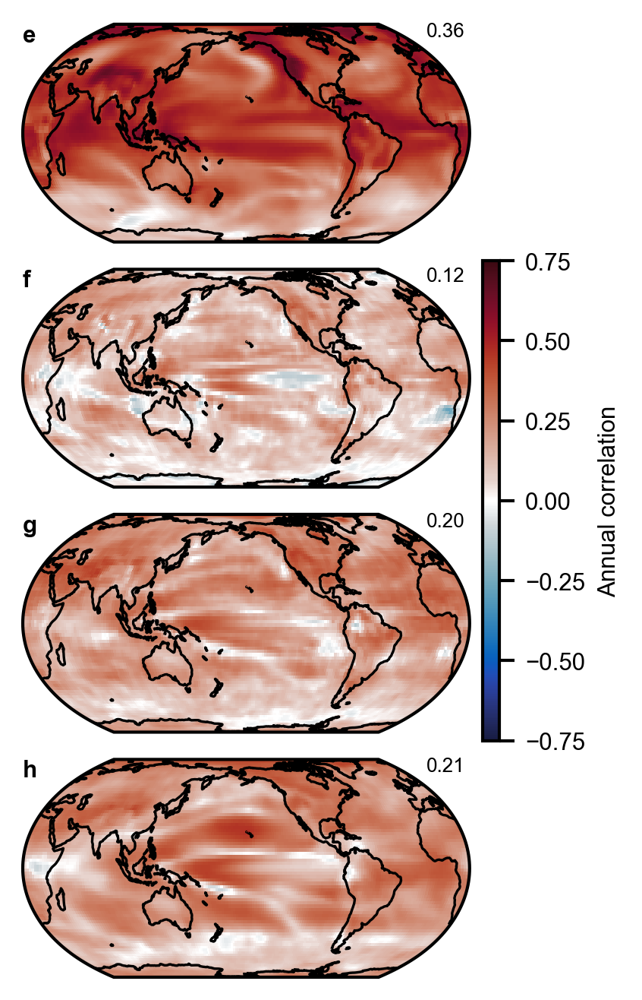

In [ ]:
def plot_ppe_corr():
    fields=["tas", "eei", "rsut", "rlut"]
    fig, axs = subplots_cartopy(len(fields), 1, figsize=(figsize_overwidth_inline[0] * 1.25/3, 4.3))

    mean = average_annually(ppe_posterior_mean_gens[fields]).sel(time=slice(850, 1850))
    ver = average_annually(ppe_ver[fields]).sel(time=slice(850, 1850))

    for field in ["eei", "rsut", "rlut"]:
        ver[field] = ver[field]

    corrs = [
        xr.corr(mean[field], ver[field], "time").compute() for field in fields
    ]
    print([np.abs(c).max().compute().item() for c in corrs])
    plot_field(axs, corrs, vmin=-0.75, vmax=0.75, extend="neither", cbar_orientation="vertical",
               cbar_kwargs={"shrink": 0.5, "pad": 0.03},
               cbar_ticks=np.arange(-0.75, 0.76, 0.25),
               cbar_label="Annual correlation", cbar_aspect=30)
    
    for i, (ax, field, corr) in enumerate(zip(axs, fields, corrs)):
        ax.text(
            0.99, 1.01, f"{area_weighted_mean(corr):.2f}",
            transform=ax.transAxes,
            ha="right", va="top",
            fontsize="small",
        )
        add_panel_label(ax, 4+i, xytext=(0, 0), ha='left', va="top")
    
    save_plot(plot_folder_pub, "parts/ppe_map_corr")

plot_ppe_corr()

# Results

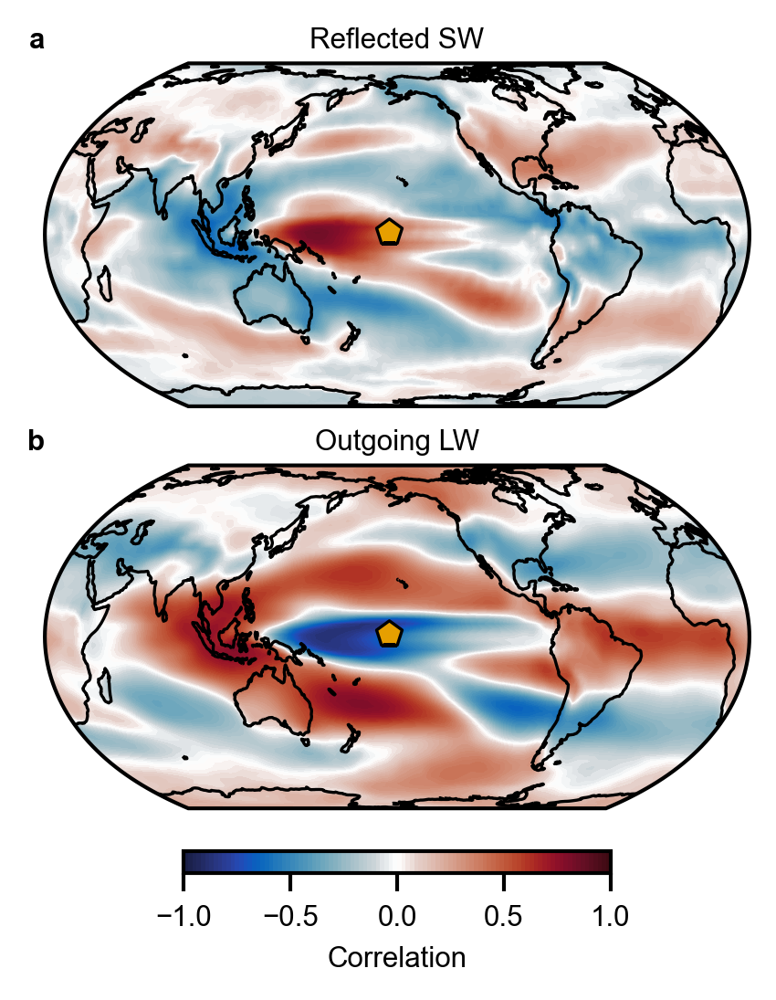

In [55]:
def plot_sst_toa_corr_example():
    fig, axs = subplots_cartopy(2, 1, figsize=(figsize_halfwidth_inline[0], figsize_halfwidth_inline[0]*1.1))

    x = average_annually(sims_models_gens.sel(time=slice(850, 1850)))
    lat = 1
    lon = 360 - 164
    corr_rsut = xr.corr(x.sel(lat=lat, lon=lon)["tas"], x["rsut"], "time").mean("model")
    corr_rlut = xr.corr(x.sel(lat=lat, lon=lon)["tas"], x["rlut"], "time").mean("model")

    plot_field(axs, [corr_rsut, corr_rlut], vmin=-1, vmax=1,
               cbar_kwargs={"shrink": 0.5}, extend="neither", cbar_label="Correlation",
               plot_method="contourf", n_level=100,
               cbar_ticks=np.arange(-1, 1.1, 0.5), cbar_aspect=20)
    
    for i, ax in enumerate(axs):
        add_panel_label(ax, i, xytext=(0, 4))
        ax.scatter(lon, lat, transform=ccrs.PlateCarree(),
                   marker="p", s=50, c="C0", edgecolor="black")
    
    axs[0].set_title(get_field_label("rsut"), loc="center", pad=4)
    axs[1].set_title(get_field_label("rlut"), loc="center", pad=4)

    save_plot(plot_folder_pub, "sst_toa_corr_example")

plot_sst_toa_corr_example()

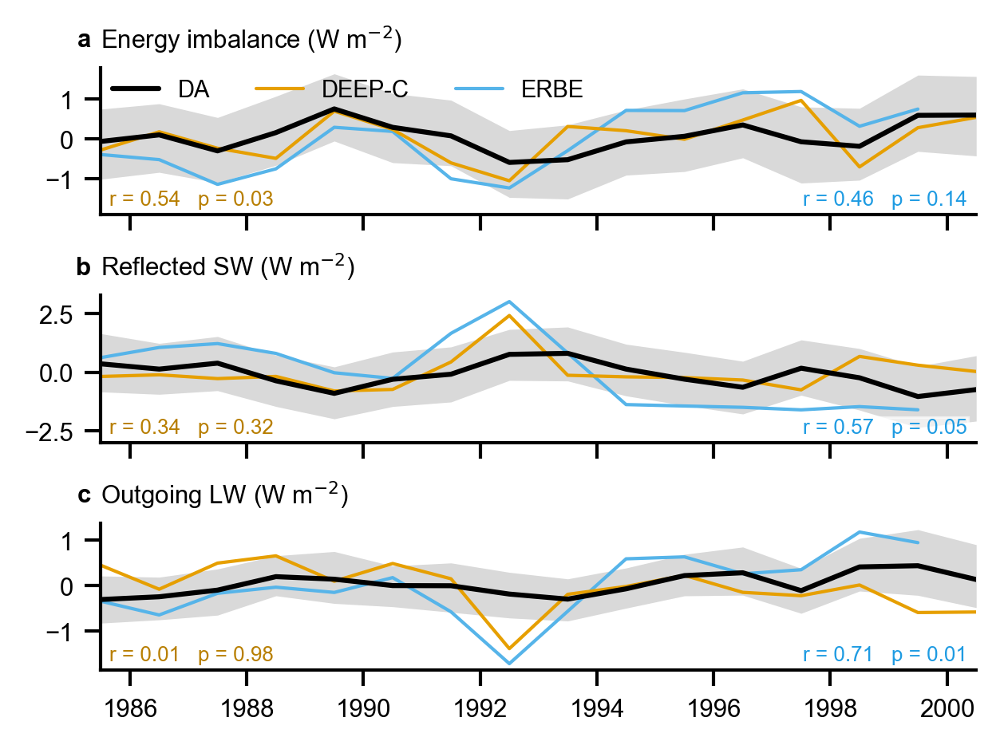

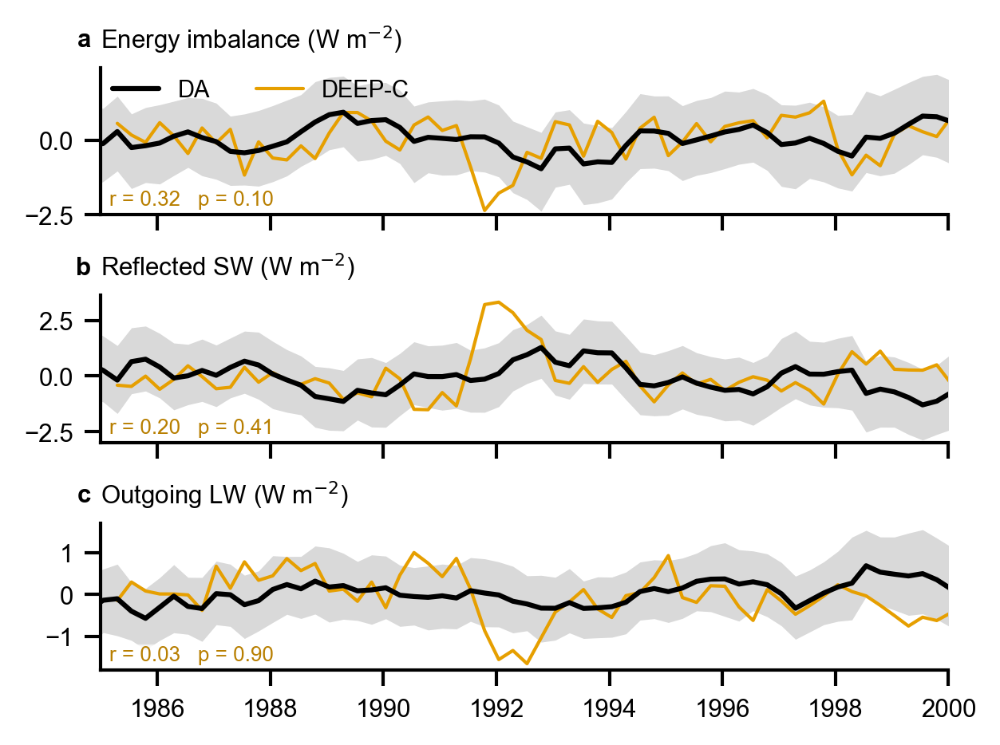

In [42]:
def plot_deepc_global_mean(seasonal=False):
    fig, axs = plt.subplots(3, 1, figsize=(figsize_overwidth_inline[0] * 1.88/3, 3.0), sharex="col")

    for i, field in enumerate(["eei", "rsut", "rlut"]):
        ds_recon = posterior_global_means_gens.sel(time=slice(1984, 2001))[field]
        if not seasonal: ds_recon = shift_to_year_middle(average_annually(ds_recon))
        ds_recon = anomalize(ds_recon, (1985, 1999))
        erbe = shift_to_year_middle(ds_erbe_global_mean[field])
        deepc = ds_deepc if seasonal else shift_to_year_middle(ds_deepc_annual)
        deepc = area_weighted_mean(deepc[field])

        ax = axs[i]
        ax.plot(ds_recon.time, ds_recon.mean("ens"), label="DA", c="black", zorder=3, lw=1.5)
        shade_ci(ax, ds_recon, c="black")
        ax.plot(deepc.time, deepc, label="DEEP-C", zorder=2)
        if not seasonal:
            ax.plot(erbe.time, erbe, label="ERBE", zorder=1)

        # for ds_recon_prior in posterior_global_means:
        #     ds_recon_prior = average_annually(ds_recon_prior).sel(time=slice(1985, 1999))[field]
        #     ds_recon_prior = anomalize(ds_recon_prior, (1985, 1999))
        #     ax.plot(ds_recon_prior.time, ds_recon_prior.mean("ens"), lw=0.5, c="black", zorder=-1)

        ax.set_title(f"{get_field_label(field, True)}")
        add_panel_label(ax, i)

        if i == 0:
            ax.legend(ncol=3, loc="upper left")

        r = xr.corr(ds_recon.mean("ens"), deepc, "time").compute().item()
        p = compute_correlation_significance(ds_recon.mean("ens"), deepc, n_surr=10000).item()
        ax.text(0.01, 0.04, f"r = {r:.2f}   p = {p:.2f}",
                transform=ax.transAxes, verticalalignment='bottom', horizontalalignment='left',
                fontsize="small", bbox=dict(facecolor="white", pad=0.1, alpha=0.6),
                color=adjust_color_lightness("C0", 0.8))

        if not seasonal:
            r = xr.corr(ds_recon.mean("ens"), erbe, "time").compute().item()
            p = compute_correlation_significance(ds_recon.mean("ens"), erbe, n_surr=10000).item()
            ax.text(0.99, 0.04, f"r = {r:.2f}   p = {p:.2f}",
                    transform=ax.transAxes, verticalalignment='bottom', horizontalalignment='right',
                    fontsize="small", bbox=dict(facecolor="white", pad=0.1, alpha=0.6),
                    color=adjust_color_lightness("C1", 0.8))

        # Make space for correlation text
        if field == "rsut":
            ax.set_ylim([-3, ax.get_ylim()[1]])
        if field == "eei":
            if seasonal:
                ax.set_ylim([-2.5, ax.get_ylim()[1]])
            else:
                ax.set_ylim([-1.9, ax.get_ylim()[1]])

    if seasonal:
        ax.set_xlim([1985, 2000])
    else:
        ax.set_xlim([1985.5, 2000.5])

    format_plot()
    if seasonal:
        save_plot(plot_folder_si, "parts/deepc_global_mean_seasonal")
    else:
        save_plot(plot_folder_pub, f"parts/deepc_global_mean")

plot_deepc_global_mean()
plot_deepc_global_mean(True)

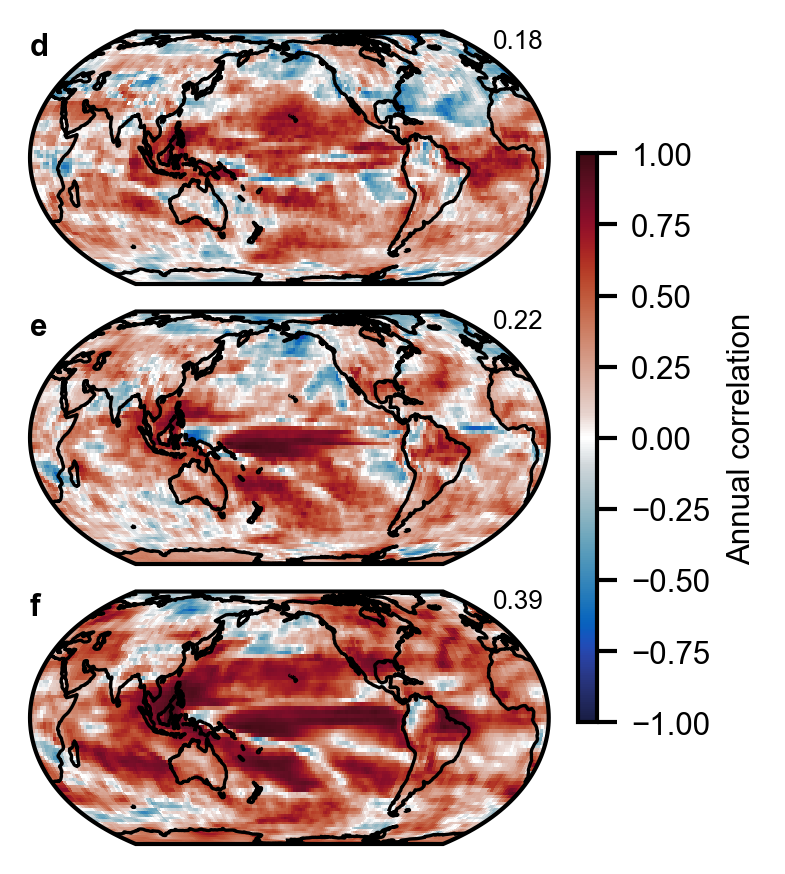

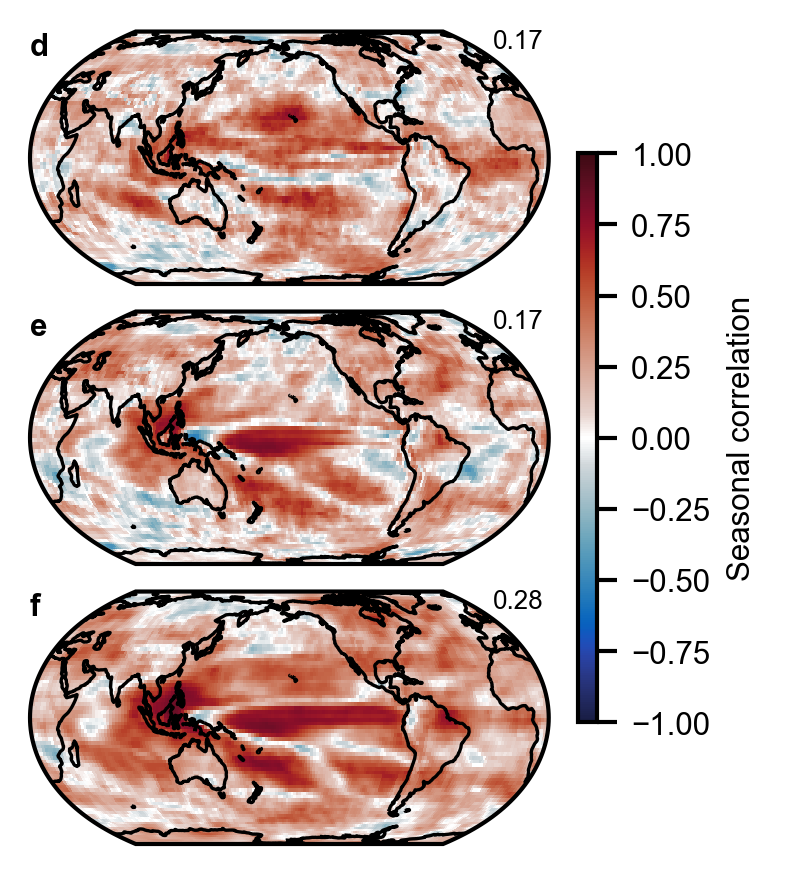

In [37]:
def plot_deepc_map(seasonal=False):
    # A bit less tall than global-mean plot because of its x labels
    fig, axs = subplots_cartopy(3, 1, figsize=(figsize_overwidth_inline[0] * 1.25/3, 2.8))

    fields = ["eei", "rsut", "rlut"]
    recon = posterior_mean_gens[fields]
    if not seasonal: recon = average_annually(recon)
    recon = anomalize(recon, (1985, 1999))
    deepc = ds_deepc if seasonal else ds_deepc_annual

    corr = recon.map(lambda x: xr.corr(deepc[x.name], x, "time")).compute()

    plot_field(axs,
               [corr[field] for field in fields],
               vmin=-1, vmax=1, extend="neither", plot_method="pcolormesh",
               cbar_label=f"{'Seasonal' if seasonal else 'Annual'} correlation",
               cbar_orientation="vertical", cbar_kwargs={"shrink": 0.7}, cbar_aspect=30)
    for i, (ax, field) in enumerate(zip(axs, fields)):
        ax.text(
            0.99, 1.01, f"{area_weighted_mean(corr[field]):.2f}",
            transform=ax.transAxes,
            ha="right", va="top",
            fontsize="small",
        )
        add_panel_label(ax, i+3, xytext=(0, 0), ha='left', va="top")

        # print(field)
        # p = compute_correlation_significance(recon[field], deepc[field], n_surr=20)
        # cs = ax.contourf(corr.lon, corr.lat, (p >= 0.05),# | (corr[field] < 0),
        #                 hatches=[None, "..."], colors="none", edgecolor="black",
        #                 transform=ccrs.PlateCarree())
        # cs._hatch_color = (0.0, 0.0, 0.0, 1.0)
    
    if seasonal:
        save_plot(plot_folder_si, "parts/deepc_map_seasonal")
    else:
        save_plot(plot_folder_pub, f"parts/deepc_map")

plot_deepc_map()
plot_deepc_map(True)

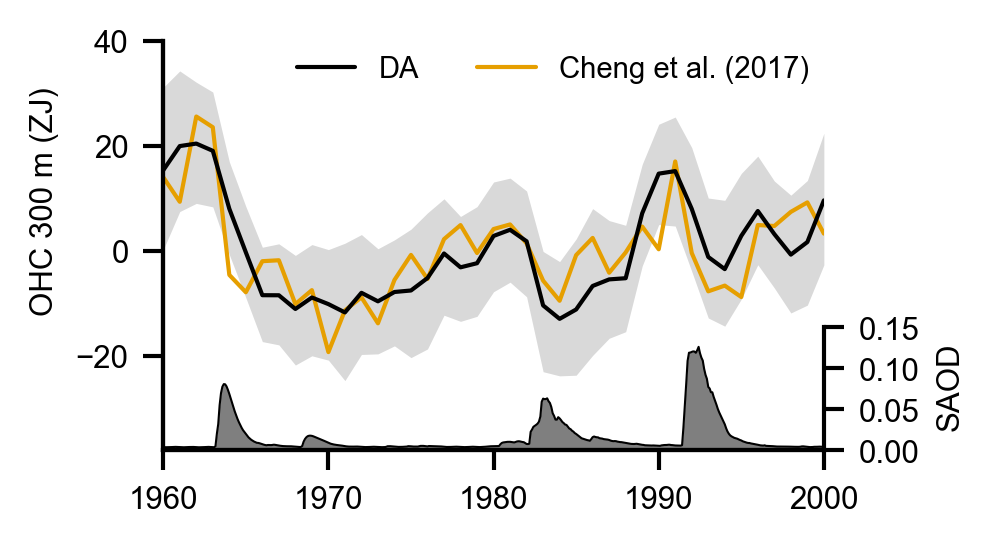

In [42]:
def plot_historical_ohc():
    fig, ax = plt.subplots(figsize=(figsize_halfwidth_inline[0], 1.7))

    scaling = 1e21
    x = convert_ohc_per_ocean_area_to_total_ohc(posterior_global_means_gens["ohc300"]) / scaling
    x = average_annually(x).sel(time=slice(1960, 2000))
    x = detrend_polynomial(x)

    cheng = convert_ohc_per_ocean_area_to_total_ohc(area_weighted_mean(ds_cheng2017["ohc300"])) / scaling
    cheng = average_annually(cheng)
    cheng = anomalize(cheng, (1961, 1991)).sel(time=slice(1960, 2000))
    cheng = detrend_polynomial(cheng)

    ax.plot(x.time, x.mean("ens"), c="black", label="DA", zorder=3)
    shade_ci(ax, x, c="black")
    ax.plot(cheng.time, cheng, label="Cheng et al. (2017)")
    plt.ylim(-38, 40)
    plt.yticks(np.arange(-20, 50, 20))
    ax.set_xlim(1960, 2000)
    ax.legend(ncol=2)
    ax.set_ylabel(get_field_label("ohc300_total", True, scaling), y=0.33, ha="left")

    ext = xr.open_dataset(get_esgf_path() / "input4MIPs/CMIP7/CMIP/uoexeter/UOEXETER-CMIP-2-2-1/atmos/mon/ext/gnz/v20250521/ext_input4MIPs_aerosolProperties_CMIP_UOEXETER-CMIP-2-2-1_gnz_175001-202312.nc")
    ext = ext.sel(wavelength=550e-9)
    dheight = ext.height_bnds.diff("bnds").squeeze()
    saod = area_weighted_mean(ext["ext"].weighted(dheight).sum("height"))
    saod = use_decimal_year_time_coords(saod).sel(time=slice(1960, 2000))

    ax2 = ax.twinx()
    ax2.plot(saod.time, saod, color="black", alpha=1, lw=0.5)
    ax2.fill_between(saod.time, 0, saod, color="black", alpha=0.5, lw=0)
    ax2.set_ylim(0, 0.50)
    ax2.spines.right.set_visible(True)
    ax2.spines.right.set_bounds((0, 0.15))
    ax2.set_yticks(np.arange(0, 0.16, 0.05))
    ax2.set_ylabel("SAOD", y=0.05, ha="left")

    save_plot(plot_folder_pub, "timeseries_historical_ohc")

plot_historical_ohc()

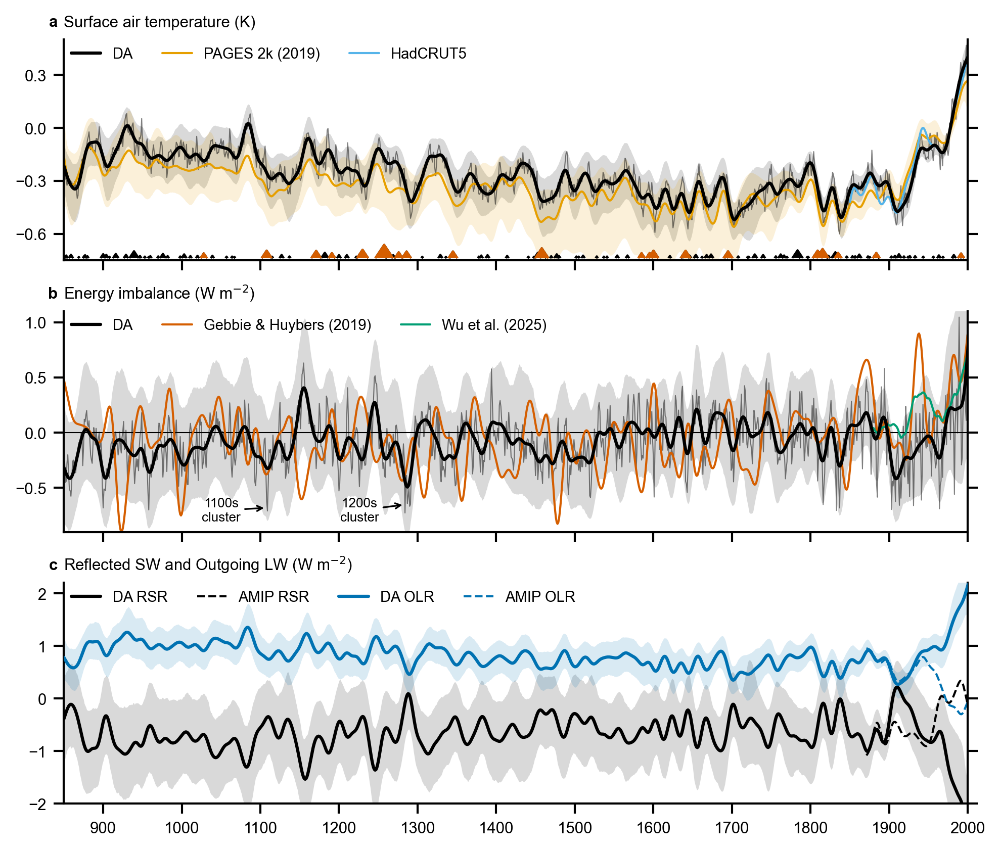

In [15]:
def plot_global_mean():
    fig, axs = plt.subplots(3, 1, figsize=(figsize_overwidth_inline[0], 5.5), sharex=True)

    ax = axs[0]
    gens = average_annually(posterior_global_means_gens["tas"])
    ax.plot(gens.time, gens.mean("ens"), linewidth=0.5, c="black", alpha=0.5)
    gens = lowpass_filter(gens, 20).sel(time=slice(850, None))
    ax.plot(gens.time, gens.mean("ens"), linewidth=1.5, c="black",
                    label="DA", zorder=3)
    shade_ci(ax, gens, c="black")

    pages = ds_pages19["tas"]
    pages = lowpass_filter(pages, 20)
    ax.plot(pages.time, pages.median("ens"), label="PAGES 2k (2019)", c="C0")
    shade_ci(ax, pages, c="C0")

    hadcrut = area_weighted_mean(ds_hadcrut["tas"])
    hadcrut = lowpass_filter(hadcrut, 20, padlen=0)
    ax.plot(hadcrut.time, hadcrut, label="HadCRUT5", c="C1")

    trans = mpl.transforms.blended_transform_factory(ax.transData, ax.transAxes)
    ax.scatter(ds_eruptions.time, 0.01 * np.ones(len(ds_eruptions.time)), transform=trans,
                s=ds_eruptions.vssi*1.2, c="black", marker=mpl.markers.CARETUPBASE)
    
    eruptions_sel = ds_eruptions.sel(time=ds_eruptions["vssi"] >= 7.5).drop_duplicates(dim="time")
    eruptions_sel = eruptions_sel.sel(time=((eruptions_sel.lat >= -30) & (eruptions_sel.lat < 30)))
    ax.scatter(eruptions_sel.time, 0.01 * np.ones(len(eruptions_sel.time)), transform=trans,
                s=eruptions_sel.vssi*1.2, c="C4", marker=mpl.markers.CARETUPBASE)

    ax.legend(ncol=3, loc="upper left")
    add_panel_label(ax, 0)
    ax.set_title(get_field_label("tas", True))
    ax.set_ylim(-0.75, 0.5)
    ax.set_yticks(np.arange(-0.6, 0.5, 0.3))





    ax = axs[1]
    gens = average_annually(posterior_global_means_gens["eei"])
    gens = anomalize(gens, (1850, 1900)) + 0.07
    ax.plot(gens.time, gens.mean("ens"), linewidth=0.5, c="black", alpha=0.5)
    gens = lowpass_filter(gens, 20).sel(time=slice(850, None))
    ax.plot(gens.time, gens.mean("ens"), linewidth=1.5, c="black", zorder=3, label="DA")
    shade_ci(ax, gens, c="black")

    gebbie19 = area_weighted_mean(ds_gebbie19["ohc"]).differentiate("time") / SECONDS_PER_YEAR * OCEAN_FRACTION / OCEAN_HEAT_UPTAKE_FRACTION
    gebbie19 = lowpass_filter(gebbie19, 20)
    ax.plot(gebbie19.time, gebbie19, label=f"Gebbie & Huybers (2019)", c="C4")

    wu25 = ds_wu25["eei"]
    ax.plot(wu25.time, wu25, label=f"Wu et al. (2025)", c="C2")
    
    ax.axhline(0, lw=0.5, c="black", zorder=-2)
    add_panel_label(ax, 1)
    ax.set_title(get_field_label("eei", True))
    ax.set_ylim(-0.9, 1.1)
    ax.legend(ncol=3, loc="upper left")

    ax.annotate('1100s\ncluster', xy=(1110, -0.68), xytext=(1110-60, -0.8),
                arrowprops=dict(arrowstyle='->', color='black', lw=0.8),
                bbox=dict(boxstyle='square,pad=0.03',fc="none", ec="none"),
                fontsize='small', ha='center')

    ax.annotate('1200s\ncluster', xy=(1286, -0.65), xytext=(1286-60, -0.8),
                arrowprops=dict(arrowstyle='->', color='black', lw=0.8),
                bbox=dict(boxstyle='square,pad=0.03',fc="none", ec="none"),
                fontsize='small', ha='center')


    ax = axs[2]
    amip = ds_amip["rsut"].mean("model")
    amip = lowpass_filter(amip, 20)

    gens = average_annually(posterior_global_means_gens["rsut"])
    gens = lowpass_filter(gens, 20).sel(time=slice(850, None))
    gens = anomalize(gens, (1871, 1900)) + amip.sel(time=slice(1871, 1900)).mean("time")

    ax.plot(gens.time, gens.mean("ens"), linewidth=1.5, label="DA RSR", c="black", zorder=3)
    ax.plot(amip.time, amip, label="AMIP RSR", c="black", ls="--")
    shade_ci(ax, gens, c="black")

    amip = ds_amip["rlut"].mean("model")
    amip = lowpass_filter(amip, 20)

    gens = average_annually(posterior_global_means_gens["rlut"])
    gens = lowpass_filter(gens, 20).sel(time=slice(850, None))
    gens = anomalize(gens, (1871, 1900)) + amip.sel(time=slice(1871, 1900)).mean("time")

    ax.plot(gens.time, gens.mean("ens"), linewidth=1.5, c="C3", label="DA OLR", zorder=3)
    ax.plot(amip.time, amip, label="AMIP OLR", c="C3", ls="--")
    shade_ci(ax, gens, c="C3")


    add_panel_label(ax, 2)
    ax.set_title(f"Reflected SW and Outgoing LW ({get_field_unit('rlut')})")
    ax.legend(ncol=4, loc="upper left")
    ax.set_ylim(-2.0, 2.2)

    # ax.set_xlabel("Year")
    ax.set_xlim(850, 2000)
    ax.set_xticks(np.arange(900, 2001, 100))

    for ax in axs:
        ax.spines.right.set_visible(True)
        ax.yaxis.set_ticks_position('both')
        ax.yaxis.set_tick_params(right=True)

    format_plot()
    save_plot(plot_folder_pub, "timeseries_gm")
    plt.show()

plot_global_mean()

In [48]:
gens = average_annually(posterior_global_means_gens["eei"]).mean("ens")
gens = gens.sel(time=slice(850, 1850))
gens_trends = compute_sliding_window_trend(gens, 24).compute() * 10
gens_trends.max().compute()

<xarray.DataArray 'polyfit_coefficients' ()> Size: 8B
array(0.3742013)
Coordinates:
    degree   int64 8B 1

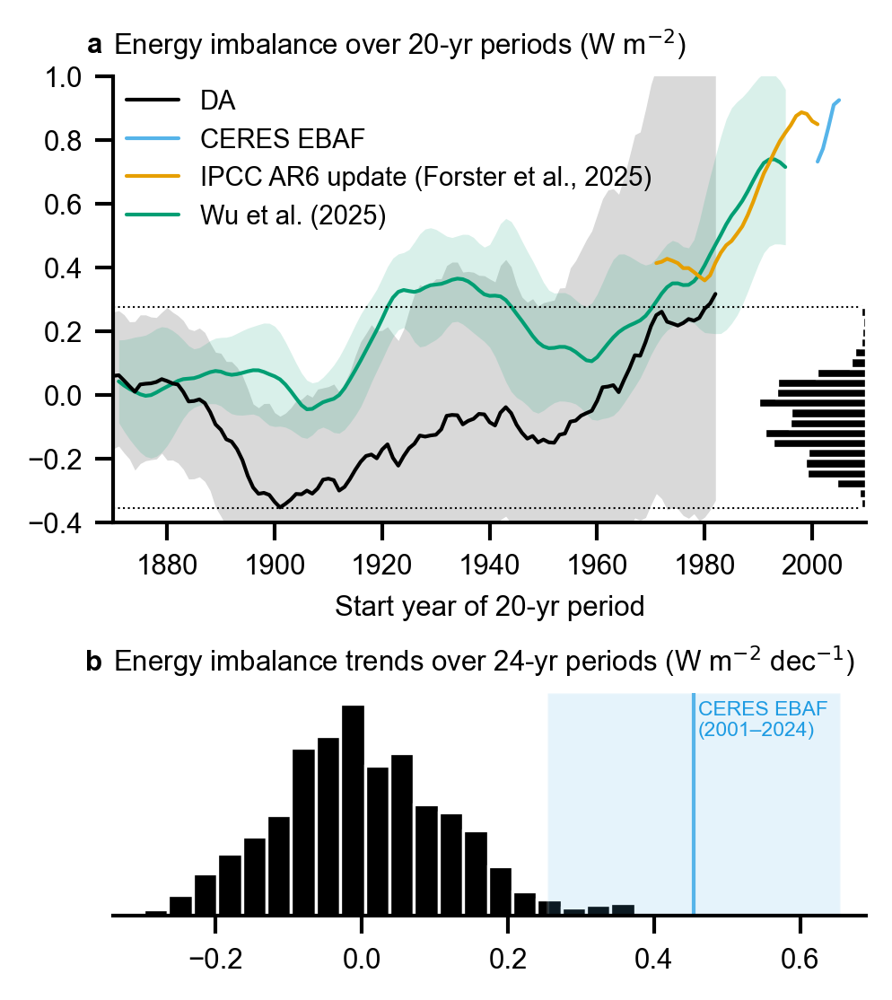

In [16]:
def plot_historical_eei():
    fig, axs = plt.subplots(2, 1, figsize=(figsize_halfwidth_inline[0], 3.6), height_ratios=[2, 1])
    fig.subplots_adjust(hspace=-30)

    ax_dist = axs[0].inset_axes([0.85, 0, 0.15, 1])

    ax = axs[0]
    x = average_annually(posterior_global_means_gens["eei"])
    x = anomalize(x, (1850, 1900)) + 0.07
    x = x.sel(time=slice(1870, None))
    x = x.rolling(time=20).mean().shift(time=-19)
    ax.plot(x.time, x.mean("ens"), c="black", label="DA", zorder=3)
    shade_ci(ax, x, c="black")

    ceres = average_annually(ds_ceresgm["eei"]).rolling(time=20).mean().shift(time=-19)
    ax.plot(ceres.time, ceres, c="C1", label="CERES EBAF")

    x = convert_total_ohc_to_ohc_per_surface_area(ds_smith2025_eei["ehc"]).rolling(time=20).construct("window").shift(time=-19).dropna("time")
    smith = x.polyfit("window", 1)["polyfit_coefficients"].sel(degree=1) / SECONDS_PER_YEAR
    ax.plot(smith.time, smith, c="C0", label="IPCC AR6 update (Forster et al., 2025)", zorder=3)

    wu25 = ds_wu25.shift(time=-9)
    ax.plot(wu25.time, wu25["eei"], c="C2", label="Wu et al. (2025)")
    # Convert 1-sigma to 5th-95th percentile range (i.e., very likely range)
    # See https://github.com/chrisroadmap/ar6/blob/main/notebooks/350_chapter7_box7.2_fig1.ipynb
    NINETY_TO_ONESIGMA = scipy.stats.norm.ppf(0.95)
    ax.fill_between(wu25.time, wu25["eei"] - NINETY_TO_ONESIGMA * wu25["eei_stde"],
                    wu25["eei"] + NINETY_TO_ONESIGMA * wu25["eei_stde"],
                    fc="C2", alpha=0.15, lw=0)

    ax.legend()
    ax.set_title(f"Energy imbalance over 20-yr periods ({get_field_unit("eei")})")
    ax.set_ylim(-0.4, 1.0)
    ax.set_yticks(np.arange(-0.4, 1.1, 0.2))
    ax.set_xlim(1870, 2010)
    ax.set_xlabel("Start year of 20-yr period")
    add_panel_label(ax, 0)

    ax = ax_dist
    x = average_annually(posterior_global_means_gens["eei"]).mean("ens")
    x = anomalize(x, (1850, 1900)) + 0.07
    x = x.sel(time=slice(850, 1850))
    x = x.rolling(time=20).mean().dropna("time")
    hist_n, hist_bins, _ = ax.hist(x.values, orientation="horizontal", bins=20, density=True, facecolor="black")
    ax.set_xticks([])
    ax.set_yticks([])
    sns.despine(ax=ax, left=True, bottom=True)
    ax.set_ylim(-0.4, 1.0)
    ax.patch.set_alpha(0)
    ax.invert_xaxis()

    ax = axs[0]
    # ax.pcolormesh([1880, 2020], hist_bins, np.atleast_2d(hist_n).T,
    #                 cmap=mpl.colors.LinearSegmentedColormap.from_list("", ["#FFFD", "#000A"]), zorder=-1)
    ax.axhline(x.min(), c="black", ls=":", lw=0.5)
    ax.axhline(x.max(), c="black", ls=":", lw=0.5)


    ax = axs[1]
    gens = average_annually(posterior_global_means_gens["eei"]).mean("ens")
    gens = gens.sel(time=slice(850, 1850))
    gens_trends = compute_sliding_window_trend(gens, 24).compute() * 10

    ceres_trend = compute_sliding_window_trend(average_annually(ds_ceresgm["eei"]), 24).compute().item() * 10

    transform = mpl.transforms.blended_transform_factory(ax.transData, ax.transAxes)
    ax.hist(gens_trends.values, bins=20, fc="black")
    ax.axvline(ceres_trend, c="C1")
    # 0.2 W/m2/dec is uncertainty from Raghuraman (2021)
    ax.axvspan(ceres_trend-0.2, ceres_trend+0.2, fc="C1", alpha=0.15)
    ax.text(0.46, 0.81, "CERES EBAF\n(2001–2024)", transform=transform,
            c=adjust_color_lightness("C1", 0.8), size=5.5)
    ax.set_yticks([])
    ax.set_xlim(-0.34, 0.69)
    sns.despine(ax=ax, left=True)

    ax.set_title("Energy imbalance trends over 24-yr periods (" + get_field_unit("eei") + r" dec$^{-1}$)")
    add_panel_label(ax, 1)

    
    save_plot(plot_folder_pub, "timeseries_historical_eei")

plot_historical_eei()

99.94884072580646
99.76310483870968


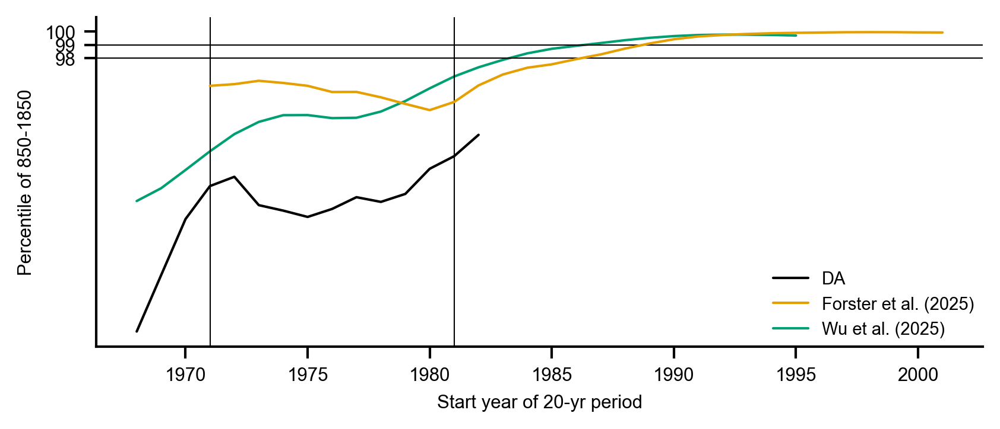

In [69]:
def check_eei_percentile():
    fig, ax = plt.subplots()

    x = average_annually(posterior_global_means_gens["eei"])
    # x = anomalize(x, (1600, 1900))
    x = anomalize(x, (1850, 1900)) + 0.07
    x = x.rolling(time=20).mean().dropna("time").shift(time=-19)
    baseline = x.sel(time=slice(850, 1850)).drop_vars("ens").stack(x=["time", "ens"])
    test = x.sel(time=slice(1968, None)).mean("ens")
    percentiles = test.copy(data=scipy.stats.percentileofscore(baseline.values, test.values))

    ax.plot(percentiles.time, percentiles, label="DA", c="black")

    x = convert_total_ohc_to_ohc_per_surface_area(ds_smith2025_eei["ehc"]).rolling(time=20).construct("window").shift(time=-19).dropna("time")
    test = x.polyfit("window", 1)["polyfit_coefficients"].sel(degree=1) / SECONDS_PER_YEAR
    percentiles = test.copy(data=scipy.stats.percentileofscore(baseline.values, test.values))
    ax.plot(percentiles.time, percentiles, label="Forster et al. (2025)", c="C0", zorder=3)
    print(percentiles.max().item())

    test = ds_wu25["eei"].sel(time=slice(1968, None)).shift(time=-9).dropna("time")
    percentiles = test.copy(data=scipy.stats.percentileofscore(baseline.values, test.values))
    ax.plot(percentiles.time, percentiles, label="Wu et al. (2025)", c="C2")
    print(percentiles.max().item())

    for pct in [98, 99]:
        ax.axhline(pct, c="black", lw=0.5)
    
    ax.axvline(1971, c="black", lw=0.5)
    ax.axvline(1981, c="black", lw=0.5)

    ax.set_ylabel("Percentile of 850-1850")
    ax.set_xlabel("Start year of 20-yr period")
    ax.legend()
    ax.set_yticks([98, 99, 100])

check_eei_percentile()

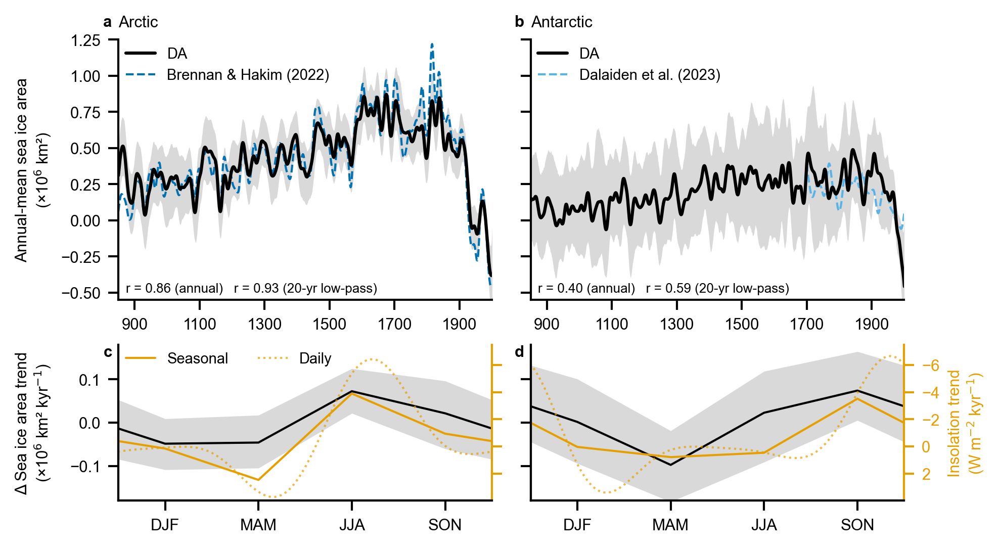

In [16]:
def plot_siarea():
    fig, axs = plt.subplots(2, 2, figsize=(figsize_overwidth_inline[0], 3.5), sharex="row", sharey="row", height_ratios=[2, 1.2])

    for i, field in enumerate(["siarean", "siareas"]):
        ax = axs[0, i]
        gens = average_annually(posterior_indices_gens[field] / 1e6)
        gens = anomalize(gens, (1961, 1991))
        gens_lp = lowpass_filter(gens, 20).sel(time=slice(850, None)).sel(time=slice(850, 2001))
        gens = gens.sel(time=slice(850, 2001))
        ax.plot(gens_lp.time, gens_lp.mean("ens"), linewidth=1.5, c="black", label="DA", zorder=3)

        shade_ci(ax, gens_lp, c="black")

        if field == "siarean":
            brennan = ds_brennan[field].mean(["model", "ens"]) / 1e6
            brennan_lp = lowpass_filter(brennan, 20).sel(time=slice(850, 2001))
            brennan = brennan.sel(time=slice(850, 2001))
            ax.plot(brennan_lp.time, brennan_lp, label="Brennan & Hakim (2022)", c="C3", ls="--")

            corr = xr.corr(brennan_lp, gens_lp.mean("ens"), "time").compute().item()
            corr_ann = xr.corr(brennan, gens.mean("ens"), "time").compute().item()
            ax.text(0.02, 0.02, f"r = {corr_ann:.2f} (annual)   r = {corr:.2f} (20-yr low-pass)",
                transform=ax.transAxes, verticalalignment='bottom', size="small")
        
        if field == "siareas":
            dalaiden = ds_dalaiden2023["siareas"] / 1e6
            dalaiden = anomalize(dalaiden, (1961, 1991))
            dalaiden_lp = lowpass_filter(dalaiden, 20)
            ax.plot(dalaiden_lp.time, dalaiden_lp, label="Dalaiden et al. (2023)", c="C1", ls="--")

            corr = xr.corr(dalaiden_lp, gens_lp.mean("ens"), "time").compute().item()
            corr_ann = xr.corr(dalaiden, gens.mean("ens"), "time").compute().item()
            ax.text(0.02, 0.02, f"r = {corr_ann:.2f} (annual)   r = {corr:.2f} (20-yr low-pass)",
                transform=ax.transAxes, verticalalignment='bottom', size="small")

        ax = axs[1, i]
        x = posterior_indices_gens.sel(time=slice(850, 1850))[field] / 1e6
        siarea_trend = use_tuple_time_coords(x).groupby("season").apply(
            lambda y: y.polyfit("year", deg=1)["polyfit_coefficients"].sel(degree=1) * 1e3
        ).compute().sel(season=[Season.SON, Season.DJF, Season.MAM, Season.JJA, Season.SON, Season.DJF]).assign_coords(season=[-1, 0, 1, 2, 3, 4])
        siarea_trend_ann = average_annually(x).polyfit("time", deg=1)["polyfit_coefficients"].sel(degree=1).compute() * 1e3
        siarea_trend -= siarea_trend_ann

        from climlab.solar.orbital import OrbitalTable
        from climlab.solar.insolation import daily_insolation
        Q = daily_insolation(
            lat=xr.DataArray(np.arange(-90, 91, 1), dims="lat", coords=dict(lat=np.arange(-90, 91, 1))),
            day=np.arange(-366, 366*2),
            # Reference date is 1950
            orb=OrbitalTable.interp(kyear=[(850 - 1950) / 1000, (1850 - 1950) / 1000])
        ).diff("kyear").squeeze("kyear")  # W/m2/kyr

        if field == "siarean":
            insolation_trend_daily = area_weighted_mean(Q.sel(lat=slice(60, None))).compute()
        else:
            insolation_trend_daily = area_weighted_mean(Q.sel(lat=slice(None, -60))).compute()

        insolation_trend_seasonal = a = xr.concat([
            insolation_trend_daily.sel(day=slice(-31, 31+28)).mean("day").assign_coords(season=Season.DJF),
            insolation_trend_daily.sel(day=slice(31+28, 31+28+31+30+31)).mean("day").assign_coords(season=Season.MAM),
            insolation_trend_daily.sel(day=slice(31+28+31+30+31, 31+28+31+30+31+30+31+31)).mean("day").assign_coords(season=Season.JJA),
            insolation_trend_daily.sel(day=slice(31+28+31+30+31+30+31+31, 31+28+31+30+31+30+31+31+30+31+30)).mean("day").assign_coords(season=Season.SON),
        ], dim="season").sel(season=[Season.SON, Season.DJF, Season.MAM, Season.JJA, Season.SON, Season.DJF]).assign_coords(season=[-1, 0, 1, 2, 3, 4])

        ax.plot(siarea_trend.season, siarea_trend.mean("ens"), c="black")
        shade_ci(ax, siarea_trend, x_dim="season", c="black")

        ax2 = ax.twinx()
        ax2.plot(insolation_trend_seasonal.season, insolation_trend_seasonal, label="Seasonal", c="C0")
        ax2.plot((insolation_trend_daily.day / 365.24 - 0.5/12) * 4, insolation_trend_daily, label="Daily", c="C0", alpha=0.7, ls=":")
        ax2.set_ylim(-7.5, 4)
        ax2.set_yticks([2, 0, -2, -4, -6])
        ax2.invert_yaxis()
        set_yaxis_color(ax2, "C0")
        sns.despine(ax=ax2, right=False)
        if i == 0:
            ax2.set_yticklabels([])
            ax2.legend(ncol=2)

        # ax.set_xlabel("Year")
        add_panel_label(axs[0, i], i)
        add_panel_label(axs[1, i], i+2, va="top", xytext=(-3, 0))

    axs[0, 0].set_title("Arctic")
    axs[0, 0].legend(loc="upper left")
    axs[0, 1].legend(loc="upper left")
    axs[0, 0].set_ylabel(f"Annual-mean sea ice area\n({get_field_unit(field, 1e6)})")
    axs[0, 0].set_ylim(-0.55, 1.25)
    axs[0, 0].set_xlim(850, 2000)
    axs[0, 0].set_xticks(np.arange(900, 2001, 200))

    axs[0, 1].set_title("Antarctic")
    axs[1, 1].legend(loc="upper center", ncol=4)
    axs[1, 0].set_ylabel(f"Δ Sea ice area trend\n({get_field_unit(field, 1e6)}" + r" kyr$^{-1}$)")
    axs[1, 0].set_xticks([0, 1, 2, 3], ["DJF", "MAM", "JJA", "SON"])
    axs[1, 0].set_xlim(-0.5, 3.5)
    axs[1, 0].set_ylim(-0.18, 0.18)
    ax2.set_ylabel(f"Insolation trend\n({get_field_unit("rsdt")}" + r" kyr$^{-1}$)")

    format_plot()
    save_plot(plot_folder_pub, "timeseries_siarea")

plot_siarea()

In [44]:
def calculate_siarea_numbers(field):
    print(field)
    x = (posterior_indices_gens[field] / 1e6).mean("ens")
    x = average_annually(x)

    trend = x.sel(time=slice(850, 1850)).polyfit("time", deg=1)["polyfit_coefficients"].sel(degree=1).compute() * 1e3
    print("850-1850 trend:", f"{trend:.2f} e6 km2/kyr")

    diffv1 = (x.sel(time=slice(1845, 1855)).mean("time") - x.sel(time=slice(1990, 2000)).mean("time")).compute()
    x = lowpass_filter(x, 20)
    diffv2 = (x.sel(time=1850) - x.sel(time=2000))
    print("1850-2000 difference:", f"{diffv1:.2f} e6 km2  or ", f"{diffv2:.2f} e6 km2")

calculate_siarea_numbers("siarean")
calculate_siarea_numbers("siareas")

siarean
850-1850 trend: 0.54 e6 km2/kyr
1850-2000 difference: 0.93 e6 km2  or  0.95 e6 km2
siareas
850-1850 trend: 0.29 e6 km2/kyr
1850-2000 difference: 0.75 e6 km2  or  0.87 e6 km2


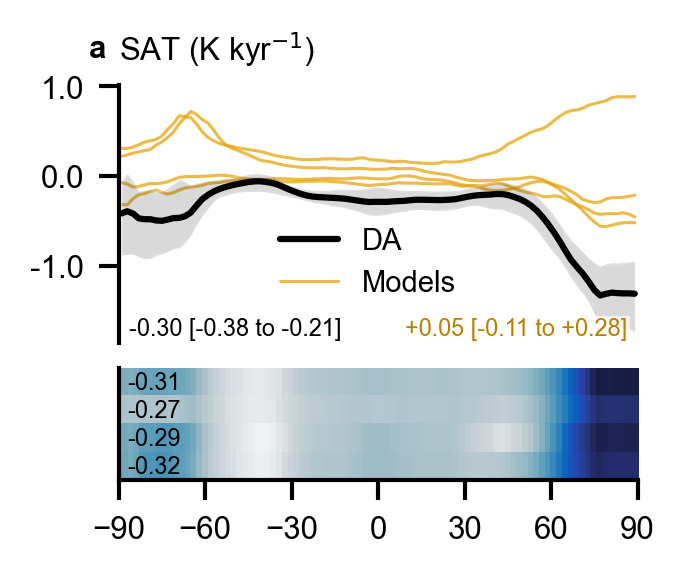

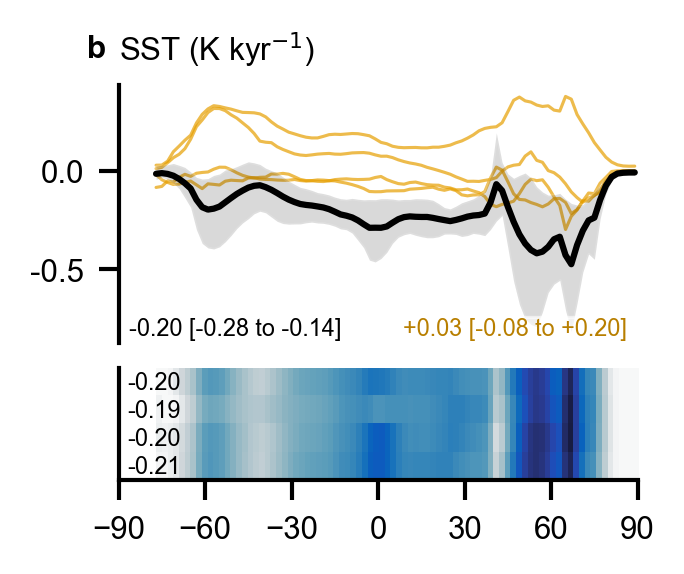

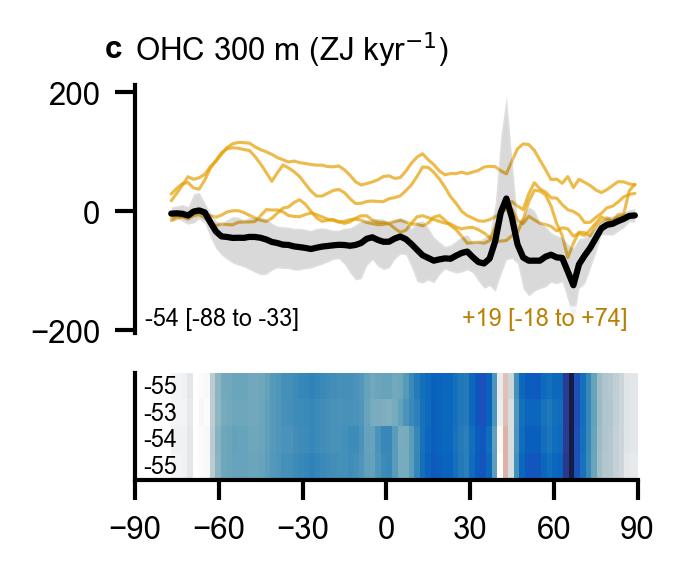

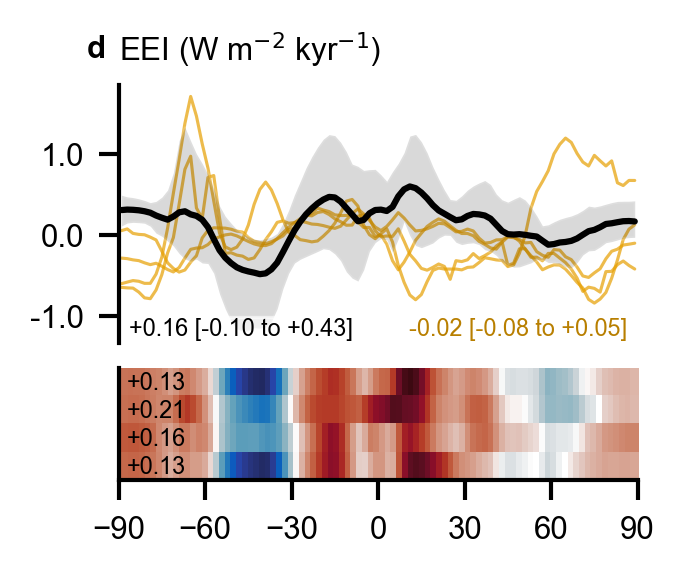

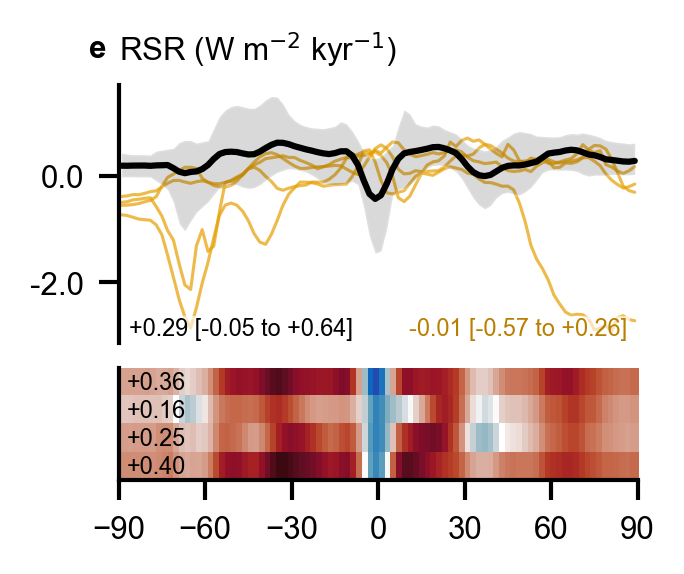

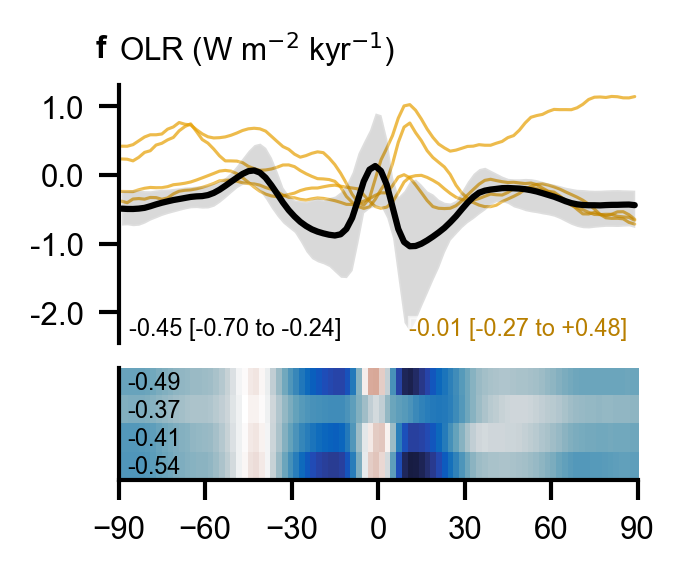

In [491]:
def plot_seasonal_latitudinal_trend(i, field):
    ci = 0.90

    fig, axs = plt.subplots(2, 1, height_ratios=[2.3, 1], sharex=True,
                            figsize=(figsize_overwidth_inline[0] / 3, 1.8))
    # Between small and x-small
    from matplotlib.font_manager import FontManager
    fontsize = 0.75 * FontManager.get_default_size()

    scaling = get_field_scaling(field)
    unit = get_field_unit(field, scaling)
    axs[0].set_title(f"{get_field_shorthand_label(field, add_units=False)} ({unit}" + r" kyr$^{-1}$)")
    # Rendered pdf has different offset from notebook png
    add_panel_label(axs[0], i, xytext=(-3, 6.7))

    x = posterior_zonal_means_gens.sel(time=slice(850, 1850))
    x["ohc300_total"] = convert_ohc_per_ocean_area_to_total_ohc(x["ohc300"])
    x = subsample_ensemble(x[field] / scaling, 400).compute()

    trend = use_tuple_time_coords(x.mean("ens")).groupby("season").apply(
        lambda y: y.polyfit("year", deg=1)["polyfit_coefficients"].sel(degree=1) * 1e3
    ).compute()  # unit/kyr
    trend_ann = x.polyfit("time", deg=1)["polyfit_coefficients"].sel(degree=1).compute() * 1e3  # unit/kyr

    model = sims_models_gens.mean("lon").sel(time=slice(850, 1850))
    model["ohc300_total"] = convert_ohc_per_ocean_area_to_total_ohc(model["ohc300"])
    model_trend = (model[field]/scaling).polyfit("time", deg=1)["polyfit_coefficients"].sel(degree=1).compute() * 1e3  # unit/kyr
    model_trend_globalmean = area_weighted_mean(model_trend)
    model_trend_globalmean_lower = model_trend_globalmean.min()
    model_trend_globalmean_upper = model_trend_globalmean.max()

    x = posterior_global_means_gens.sel(time=slice(850, 1850))
    x["ohc300_total"] = convert_ohc_per_ocean_area_to_total_ohc(x["ohc300"])
    x = x[field] / scaling
    # Use full ensemble for global means

    trend_globalmean = use_tuple_time_coords(x.mean("ens")).groupby("season").apply(
        lambda y: y.polyfit("year", deg=1)["polyfit_coefficients"].sel(degree=1) * 1e3
    ).compute()  # unit/kyr
    trend_globalmean_ann = x.polyfit("time", deg=1)["polyfit_coefficients"].sel(degree=1).compute() * 1e3
    trend_globalmean_lower = trend_globalmean_ann.quantile((1 - ci) / 2, "ens")
    trend_globalmean_upper = trend_globalmean_ann.quantile(1-(1 - ci) / 2, "ens")

    ## Annual
    axs[0].plot(trend_ann.lat, trend_ann.mean("ens"), c="black", lw=1.5,
                label="DA" if field == "tas" else None)

    for model in model.model:
        axs[0].plot(model_trend.lat, model_trend.sel(model=model), lw=0.75, c="C0", alpha=0.7,
                    label="Models" if model == 0 and field == "tas" else None, zorder=-1)
    
    if field == "tas":
        axs[0].legend(loc='lower center', bbox_to_anchor=(0.48, 0.12))
    
    shade_ci(axs[0], trend_ann, x_dim="lat", c="black")
    # axs[0].set_ylabel("Annual")
    # axs[0].grid(axis='y', which='major', linewidth=1.0)
    axs[0].tick_params(axis='x', which='major', top=False, bottom=False, direction='in')
    if trend_ann.max() < 10:
        axs[0].yaxis.set_major_formatter(mpl.ticker.FormatStrFormatter('%.1f'))
    if field == "ohc300_total":
        text = f"{trend_globalmean_ann.mean('ens'):+.0f} [{trend_globalmean_lower:+.0f} to {trend_globalmean_upper:+.0f}]"
    else:
        text = f"{trend_globalmean_ann.mean('ens'):+.2f} [{trend_globalmean_lower:+.2f} to {trend_globalmean_upper:+.2f}]"
    axs[0].text(0.02, 0.01, text,
            transform=axs[0].transAxes, verticalalignment='bottom', horizontalalignment='left',
            fontsize=fontsize, bbox=dict(facecolor="white", pad=0.1, alpha=0.6))
    if field == "ohc300_total":
        text = f"{model_trend_globalmean.mean('model'):+.0f} [{model_trend_globalmean_lower:+.0f} to {model_trend_globalmean_upper:+.0f}]"
    else:
        text = f"{model_trend_globalmean.mean('model'):+.2f} [{model_trend_globalmean_lower:+.2f} to {model_trend_globalmean_upper:+.2f}]"
    axs[0].text(0.98, 0.01, text,
            transform=axs[0].transAxes, verticalalignment='bottom', horizontalalignment='right',
            fontsize=fontsize, bbox=dict(facecolor="white", pad=0.1, alpha=0.6), c=adjust_color_lightness("C0", 0.8))
    sns.despine(ax=axs[0], bottom=True)

    ## Seasonal
    vmax = np.abs(trend).max().compute()
    values = trend.transpose("season", "lat").values
    # Repeat pole pixel to fill gap
    values = np.hstack([values[:, [0]], values, values[:, [-1]]])
    axs[1].imshow(values,
                  extent=[trend.lat[0] - 2, trend.lat[-1] + 2, 0, 4], aspect=3,
                  cmap="balancew", vmin=-vmax, vmax=vmax)
    # plt.colorbar(axs[1].images[0], ax=axs[1],
    #                     orientation='horizontal', fraction=0.35, aspect=45)
    # axs[1].set_xlabel("Latitude (°)")
    # axs[1].set_yticks([0.5, 1.5, 2.5, 3.5], reversed(Season.to_str_list(trend.season.values)))
    axs[1].set_yticks([])
    axs[1].set_aspect("auto")
    axs[1].set_xticks(np.arange(-90, 91, 30))
    axs[1].set_xlim([-90, 90])

    for y, season in zip(reversed([0.5, 1.5, 2.5, 3.5]), trend.season.values):
        if field == "ohc300_total":
            text = f"{trend_globalmean.sel(season=season).item():+.0f}"
        else:
            text = f"{trend_globalmean.sel(season=season).item():+.2f}"
        axs[1].text(-87, y, text,
                    fontsize=fontsize, #bbox=dict(facecolor="white", pad=0.1, alpha=0.6),
                    verticalalignment="center")
    
    save_plot(plot_folder_pub / "parts", f"trend_zm_{field}")

# def plot_zonal_mean_trends():
#     fig = plt.figure(figsize=(figsize_overwidth_inline[0], figsize_overwidth_inline[1] * 2))
#     subfigs = fig.subfigures(2, 3)

#     for i, (field, subfig) in enumerate(zip(["tas", "tos", "ohc300", "rsut", "rlut", "eei"][:1], subfigs.flat)):
#         plot_seasonal_latitudinal_trend(subfig, field, i)
    
#     save_plot(plot_folder_pub, "trend_zm_panels")

plot_seasonal_latitudinal_trend(0, "tas")
plot_seasonal_latitudinal_trend(1, "tos")
plot_seasonal_latitudinal_trend(2, "ohc300_total")
plot_seasonal_latitudinal_trend(3, "eei")
plot_seasonal_latitudinal_trend(4, "rsut")
plot_seasonal_latitudinal_trend(5, "rlut")

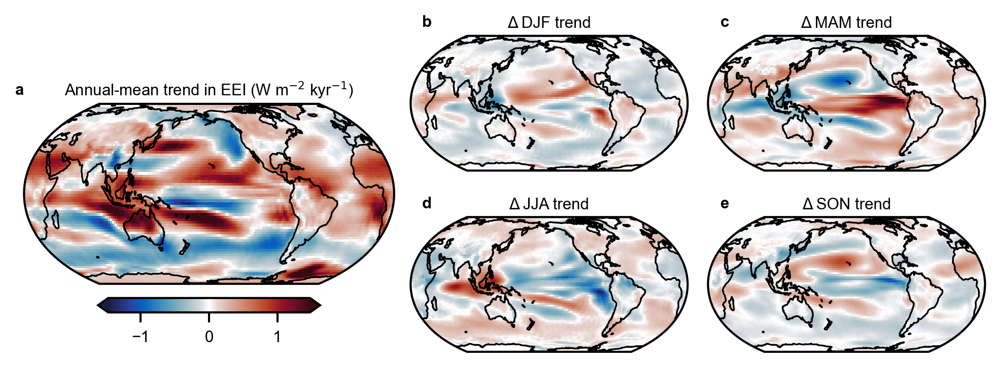

In [81]:
def plot_lm_trend_distribution(i, field, departures=True, supplement=True):
    fig = plt.figure(figsize=(figsize_overwidth_inline[0], 2.3))
    gs = mpl.gridspec.GridSpec(2, 3, figure=fig, width_ratios=[1.3, 1, 1])
    ax_big = fig.add_subplot(gs[:, 0], projection=ccrs.EqualEarth(central_longitude=200))
    axs = np.array([
        [ax_big, fig.add_subplot(gs[0, 1], projection=ccrs.EqualEarth(central_longitude=200)), fig.add_subplot(gs[0, 2], projection=ccrs.EqualEarth(central_longitude=200))],
        [None, fig.add_subplot(gs[1, 1], projection=ccrs.EqualEarth(central_longitude=200)), fig.add_subplot(gs[1, 2], projection=ccrs.EqualEarth(central_longitude=200))]
    ])

    x = posterior_mean_gens.sel(time=slice(850, 1850))[field]

    trend_ann = x.polyfit("time", deg=1)["polyfit_coefficients"].sel(degree=1).compute() * 1e3  # unit/kyr
    trend = use_tuple_time_coords(x).groupby("season").apply(
        lambda y: y.polyfit("year", deg=1)["polyfit_coefficients"].sel(degree=1) * 1e3
    ).compute()  # unit/kyr
    vmax = np.nanpercentile(np.abs(trend_ann), 95 if field == "tas" else 99)

    if departures:
        trend -= trend_ann

    import mpl_toolkits.axes_grid1.inset_locator
    cax = mpl_toolkits.axes_grid1.inset_locator.inset_axes(ax_big, width="60%", height="8%",
                        bbox_to_anchor=(0, -0.2, 1, 1), bbox_transform=ax_big.transAxes, loc="lower center")
    plot_field(ax_big, trend_ann, vmin=-vmax, vmax=vmax,
               colorbar=True, shade_land=is_ocean_field(field), cbar_kwargs={"shrink": 0.8},
               cbar_cax=cax,
               )
    plot_field(axs[:, 1:].flatten(), [
            trend.sel(season=Season.DJF), trend.sel(season=Season.MAM),
            trend.sel(season=Season.JJA), trend.sel(season=Season.SON),
        ], vmin=-vmax, vmax=vmax, colorbar=False,
        shade_land=is_ocean_field(field))
    cax = fig.axes[-1]
    # Force integer cbar ticks so all figures have the same width
    cax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(integer=True))
    
    ax_big.set_title(f"Annual-mean trend in {get_field_shorthand_label(field, add_units=False)} ({get_field_unit(field)}" + " kyr$^{-1}$)", loc="center", pad=4)
    prefix = "Δ" if departures else ""
    axs[0, 1].set_title(f"{prefix} DJF trend", loc="center", pad=4)
    axs[0, 2].set_title(f"{prefix} MAM trend", loc="center", pad=4)
    axs[1, 1].set_title(f"{prefix} JJA trend", loc="center", pad=4)
    axs[1, 2].set_title(f"{prefix} SON trend", loc="center", pad=4)

    if i:
        add_panel_label(ax_big, i, xytext=(0, 4.5))
    else:
        add_panel_label(ax_big, 0, xytext=(0, 4.5))
        add_panel_label(axs[0, 1], 1, xytext=(10, 4.5))
        add_panel_label(axs[0, 2], 2, xytext=(10, 4.5))
        add_panel_label(axs[1, 1], 3, xytext=(10, 4.5))
        add_panel_label(axs[1, 2], 4, xytext=(10, 4.5))
    
    if supplement:
        save_plot(plot_folder_si, f"parts/lm_trend_map_{field}", bbox_inches=None)
    else:
        save_plot(plot_folder_pub, f"lm_trend_map_{field}", bbox_inches=None)

plot_lm_trend_distribution(None, "eei", supplement=False)

<xarray.DataArray 'time' (time: 19)> Size: 152B
[19 values with dtype=object]
Coordinates:
  * time     (time) object 152B MultiIndex
  * year     (time) int64 152B 1028 1108 1171 1191 1230 ... 1809 1815 1835 1883
  * season   (time) object 152B Season.DJF Season.DJF ... Season.DJF Season.JJA
    region   <U6 24B 'global'
tas -0.152133971452713 0.059234797954559326
ohc300_total -21.815732955932617 1.90253484249115
rsut -0.6578035354614258 0.7141924500465393
eei -0.37205633521080017 0.37413114309310913


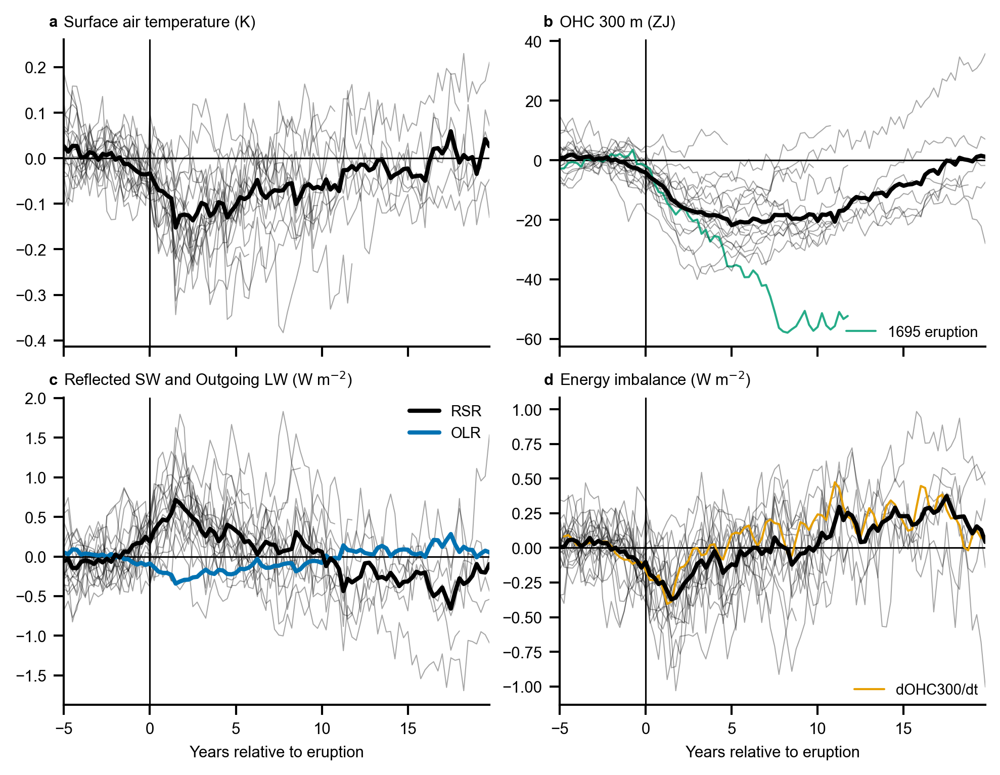

In [82]:
def plot_volcano_composite(vssi_min=7.5, lat_max=30, n_before=20, n_after=80, n_climo=20):
    eruptions = use_tuple_time_coords(ds_evolv2k.sel(time=ds_evolv2k["vssi"] >= vssi_min), True).drop_duplicates(dim="time")
    eruptions = eruptions.sel(time=((eruptions.lat >= -lat_max) & (eruptions.lat < lat_max)))

    eruptions_trim = use_tuple_time_coords(ds_evolv2k.sel(time=ds_evolv2k["vssi"] > 1), True).drop_duplicates(dim="time")

    recon = posterior_global_means_gens.mean("ens")
    recon["ddtohc300"] = recon["ohc300"].differentiate("time") / SECONDS_PER_YEAR * OCEAN_FRACTION
    recon["ohc300_total"] = convert_ohc_per_ocean_area_to_total_ohc(recon["ohc300"])
    recon = use_tuple_time_coords(recon)

    eruption_times, eruptions = xr.align(recon.time, eruptions, join="inner")
    recon_sel = []
    for i, eruption_time in enumerate(eruption_times):
        idx = recon.get_index("time").get_loc(eruption_time.item())
        # Trim if there is another eruption within the window
        if i == len(eruption_times) - 1:
            eruption_time_next = None
        else:
            eruption_time_next = use_decimal_year_time_coords(eruptions_trim).sel(
                    time=use_decimal_year_time_coords(eruption_time).time+0.05, method="backfill").time

        recon_eruption = use_decimal_year_time_coords(
            recon.isel(time=slice(idx-n_before, idx+n_after+1))
        ).sel(time=slice(None, eruption_time_next)).isel(time=slice(None, -1))
        climo = recon.isel(time=slice(idx-n_climo, idx)).groupby("season").mean("time").compute()
        recon_sel.append(
            (add_season_coords(recon_eruption).groupby("season") - climo)
            .assign_coords(eruption=i, time=np.arange(-n_before, -n_before + len(recon_eruption.time)))
        )
    recon_sel = xr.concat(recon_sel, dim="eruption")
    print(eruption_times)

    fig, axs = plt.subplots(2, 2, figsize=(figsize_overwidth_inline[0], 5), sharex=True)

    for i, (field, ax) in enumerate(zip(["tas", "ohc300_total", "rsut", "eei"], axs.flat)):
        scaling = get_field_scaling(field)

        ax.axvline(0, c="black", zorder=-3, lw=0.75)
        # ax.axvline(1, c="black")
        # ax.axvline(2, c="black")
        # ax.axvline(3, c="black")
        # ax.axvline(4, c="black")
        ax.axhline(0, c="black", zorder=-3, lw=0.75)

        for eruption in recon_sel.eruption:
            c = "black"
            lw = 0.5
            alpha = 0.35
            label = None
            legend = False
            if field == "ohc300_total":
                if eruption_times.isel(time=eruption).item() == (1695, Season.DJF):
                    c = "C2"
                    lw = 1
                    alpha = 0.85
                    label = "1695 eruption"
                    legend = True
                # elif eruption_times.isel(time=eruption).item() == (1815, Season.MAM):
                #     c = "C2"
                #     lw = 1
                #     alpha = 0.85
                #     label = "1815 eruption (Tambora)"
                #     legend = True
            ax.plot(recon_sel.time / 4, recon_sel[field].sel(eruption=eruption) / scaling,
                    lw=lw, c=c, alpha=alpha, label=label)
            if legend:
                ax.legend()
        
        if field == "eei":
            ax.plot(recon_sel.time / 4, recon_sel["ddtohc300"].mean("eruption").compute().rolling(time=3, center=True).mean(),
                    c="C0", label="dOHC300/dt")
            ax.legend()

        print(field, (recon_sel[field].mean("eruption") / scaling).min().compute().item(),
                (recon_sel[field].mean("eruption") / scaling).max().compute().item())
        if field == "rsut":
            ax.plot(recon_sel.time / 4, recon_sel["rsut"].mean("eruption") / scaling,
                    c="black", lw=2, label="RSR", zorder=5)
            ax.plot(recon_sel.time / 4, recon_sel["rlut"].mean("eruption") / scaling,
                    c="C3", lw=2, label="OLR")
            ax.legend()
        else:
            ax.plot(recon_sel.time / 4, recon_sel[field].mean("eruption") / scaling,
                    c="black", lw=2)

        ax.set_xlim(-n_before/4, (n_after-1)/4)
        if field == "rsut":
            ax.set_title(f"Reflected SW and Outgoing LW ({get_field_unit(field, scaling)})")
        else:
            ax.set_title(f"{get_field_label(field, True, scaling)}")
        add_panel_label(ax, i)
    
    # EEI same limits as RSUT
    # axs[1, 1].set_ylim(axs[1, 0].get_ylim())

    for ax in axs[1, :]:
        ax.set_xlabel("Years relative to eruption")
    
    format_plot()
    save_plot(plot_folder_pub, "composite_volcano")

    # return recon_sel

plot_volcano_composite()

In [627]:
def find_decade_with_lowest_eei():
    x = average_annually(posterior_global_means_gens["eei"].mean("ens"))
    x = anomalize(x, (1850, 1900))
    x = x.rolling(time=10).mean()
    # x.plot.hist(bins=50)
    decade_end = int(x.idxmin().compute().item())
    print(decade_end - 9, "-", decade_end)

find_decade_with_lowest_eei()

1283 - 1292


# Supplemental

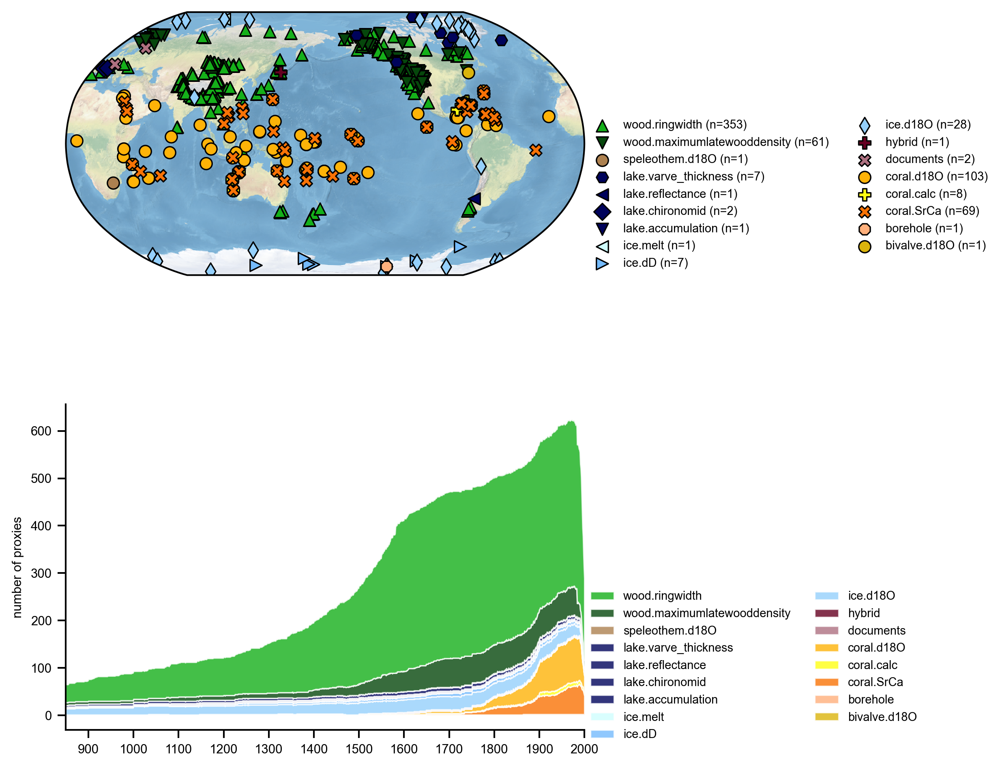

In [47]:
def plot_pdb():
    fig, axs = pdb.plot(
        plot_count=True,
        plot_xticks=np.arange(900, 2001, 100),
        plot_timespan=(850, 2000),
        figsize=figsize_fullwidth_fullpage,
        lgd_ncol=2,
    )
    axs["count"].set_xlabel(None)
    save_plot(plot_folder_si, "proxy_network")

plot_pdb()

MPI-ESM1-2-LR past2k tas 54.6%
MPI-ESM1-2-LR past2k rsut 22.2%
MPI-ESM1-2-LR past2k rlut 37.4%
CESM2-WACCM-FV2 past1000 tas 65.9%
CESM2-WACCM-FV2 past1000 rsut 43.9%
CESM2-WACCM-FV2 past1000 rlut 58.4%
MRI-ESM2-0 past1000 tas 59.4%
MRI-ESM2-0 past1000 rsut 37.3%
MRI-ESM2-0 past1000 rlut 48.5%


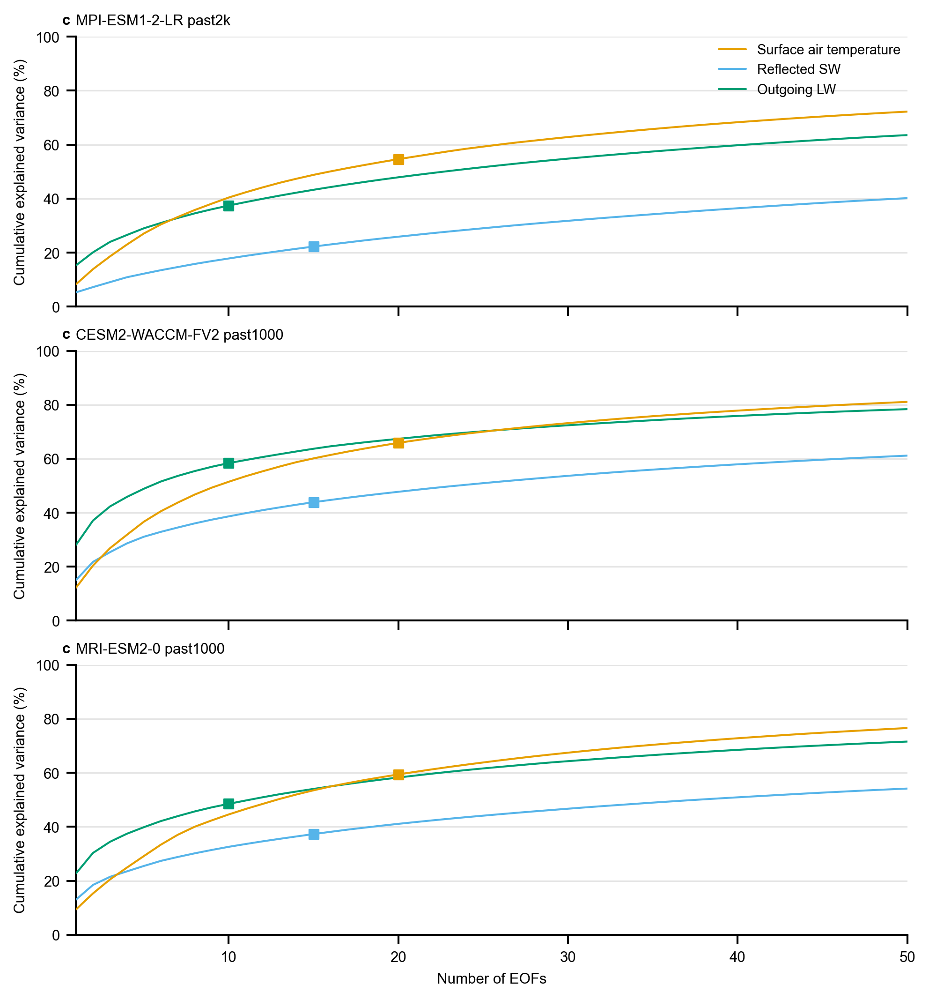

In [55]:
def plot_pc_spectra():
    from lmrecon.mapper import PhysicalSpaceForecastSpaceMapper

    fig, axs = plt.subplots(3, 1, figsize=(figsize_overwidth_inline[0], 7), sharex=True, sharey=True)

    for i, (ax, model, mapper_id) in enumerate(zip(axs, ["MPI-ESM1-2-LR past2k", "CESM2-WACCM-FV2 past1000", 'MRI-ESM2-0 past1000'],
                                    ["2025-02-17T17-45-16", "2025-02-17T17-51-54", "2025-02-17T18-37-45"])):
        mapper = PhysicalSpaceForecastSpaceMapper.load(
            get_data_path() / "mapper" / mapper_id / "mapper.pkl"
        )
        for i, f in enumerate(["tas", "rsut", "rlut"]):
        # for f in ["tas", "tos", "rsut", "rlut", "eei", "ohc300", "siconcn"]:
            zorder = -1 if f == "ohc300" else 10 - i
            retained = dict(tas=20, tos=20, rsut=15, rlut=10, eei=30, ohc300=15, siconcn=10)[f]
            eof = mapper.eofs_individual[f]
            cumulative = np.cumsum(eof.variance_per_mode) * 100 / eof.total_variance
            ax.plot(np.arange(1, eof.rank+1), cumulative,
                    label=get_field_label(f), zorder=zorder)
            ax.scatter(retained, cumulative[retained-1], marker="s", zorder=zorder)
            print(model, f, f"{cumulative[retained-1]:.1f}%")
        
        ax.set_ylabel("Cumulative explained variance (%)")
        ax.set_title(model)
        ax.yaxis.grid(True, which="major", alpha=0.5)
        add_panel_label(ax, i)
    
    axs[0].legend()
    ax.set_xlim(1, 50)
    ax.set_ylim(0, 100)
    ax.set_xlabel("Number of EOFs")

    save_plot(plot_folder_si, "pc_spectra")

plot_pc_spectra()

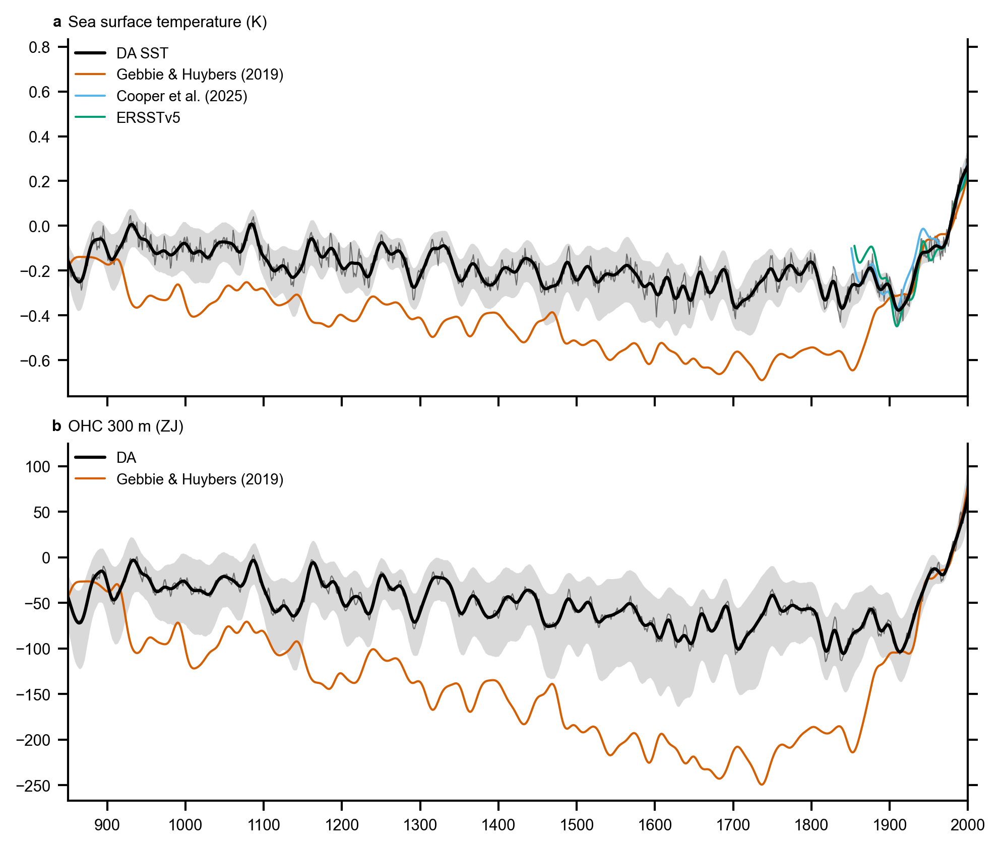

In [158]:
def plot_global_mean_supplement():
    fig, axs = plt.subplots(2, 1, figsize=(figsize_overwidth_inline[0], 5.5), sharex=True)

    # ax.axhline(0, c="black", lw=0.5, alpha=0.2)

    ax = axs[0]
    field = "tos"

    gens = average_annually(posterior_global_means_gens[field])
    ax.plot(gens.time, gens.mean("ens"), linewidth=0.5, c="black", alpha=0.5)
    gens = lowpass_filter(gens, 20).sel(time=slice(850, None))
    ax.plot(gens.time, gens.mean("ens"), linewidth=1.5, c="black", label="DA SST", zorder=3)
    shade_ci(ax, lowpass_filter(gens, 20), c="black")

    gebbie = area_weighted_mean(ds_gebbie19["tos"]).compute()
    gebbie = anomalize(gebbie, (1961, 1990))
    gebbie = lowpass_filter(gebbie, 20)
    ax.plot(gebbie.time, gebbie, c="C4", label=f"Gebbie & Huybers (2019)")

    cooper = average_annually(area_weighted_mean(ds_cooper25["tos"]))
    cooper = anomalize(cooper, (1961, 1990))
    cooper = lowpass_filter(cooper, 20)
    ax.plot(cooper.time, cooper, c="C1", label=f"Cooper et al. (2025)")

    ersst = average_annually(area_weighted_mean(ds_ersst["tos"]))
    ersst = anomalize(ersst, (1961, 1990))
    ersst = lowpass_filter(ersst, 20)
    ax.plot(ersst.time, ersst, c="C2", label=f"ERSSTv5")

    # ax.set_ylim(-0.55, 0.33)
    ax.set_title(get_field_label(field, True))
    add_panel_label(ax, 0)


    ax = axs[1]
    field = "ohc300_total"

    scaling = get_field_scaling(field)

    gens = average_annually(posterior_global_means_gens)
    gens["ohc300_total"] = convert_ohc_per_ocean_area_to_total_ohc(gens["ohc300"])
    gens = gens[field] / scaling
    ax.plot(gens.time, gens.mean("ens"), linewidth=0.5, c="black", alpha=0.5)
    gens = lowpass_filter(gens, 20).sel(time=slice(850, None))
    ax.plot(gens.time, gens.mean("ens"), linewidth=1.5, c="black", label="DA", zorder=3)
    shade_ci(ax, lowpass_filter(gens, 20), c="black")

    gebbie = convert_ohc_per_ocean_area_to_total_ohc(area_weighted_mean(ds_gebbie19["ohc300"])).compute()
    gebbie = anomalize(gebbie, (1961, 1990))
    gebbie = lowpass_filter(gebbie, 20) / scaling
    ax.plot(gebbie.time, gebbie, c="C4", label=f"Gebbie & Huybers (2019)")

    # ax.set_ylim(-180, 80)
    ax.set_title(get_field_label(field, True, scaling))
    add_panel_label(ax, 1)

    # ax.set_xlabel("Year")
    ax.set_xlim(850, 2000)
    ax.set_xticks(np.arange(900, 2001, 100))

    for ax in axs:
        ax.legend(loc="upper left")
        ax.spines.right.set_visible(True)
        ax.yaxis.set_ticks_position('both')
        ax.yaxis.set_tick_params(right=True)

    format_plot()
    save_plot(plot_folder_si, "timeseries_gm_supplement")
    plt.show()

plot_global_mean_supplement()

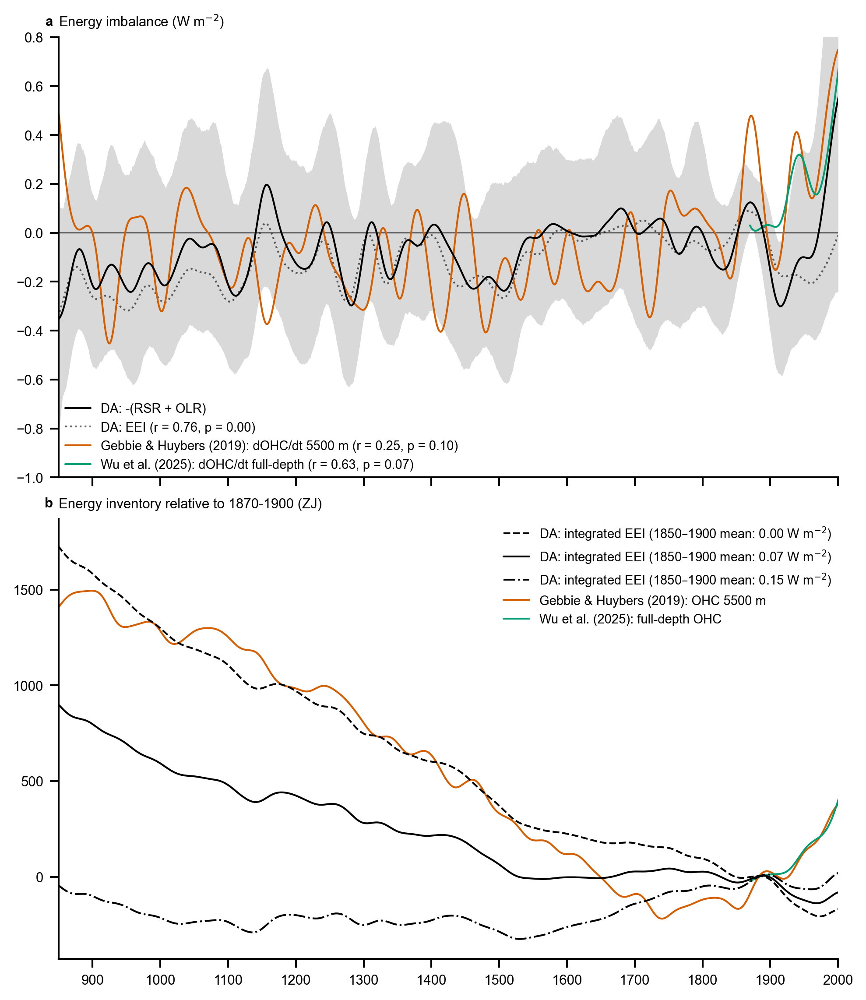

In [15]:
def plot_global_energy_budget():
    fig, axs = plt.subplots(2, 1, figsize=(figsize_overwidth_inline[0], 7.5), sharex=True)

    ax = axs[0]
    field = "eei"
    recon = average_annually(posterior_global_means_gens["eei"])
    # # Conversion of very likely range to std like https://github.com/chrisroadmap/ar6/blob/main/src/ar6/constants/__init__.py
    # recon = anomalize(recon, (1850, 1900)) + 0.2 + xr.DataArray(np.random.default_rng(15612).normal(scale=0.2 / scipy.stats.norm.ppf(0.95), size=len(recon.ens)), dims=["ens"])
    recon = anomalize(recon, (1850, 1900)) + 0.07
    recon = lowpass_filter(recon, 50)
    ax.plot(recon.time, recon.mean("ens"), label="DA: -(RSR + OLR)", c="black", zorder=3)
    shade_ci(ax, recon, c="black")

    recon3 = average_annually(posterior_global_means_gens["eei_direct"]).mean("ens")
    recon3 = anomalize(recon3, (1850, 1900)) + 0.07
    recon3 = lowpass_filter(recon3, 50)
    r = xr.corr(recon3, recon.mean("ens"), "time").compute().item()
    p = compute_correlation_significance(recon3, recon.mean("ens")).item()
    ax.plot(recon3.time, recon3, label=f"DA: EEI (r = {r:.2f}, p = {p:.2f})", c="black", alpha=0.6, ls=":")

    # cam = anomalize(eei_cam, (1850, 1900)) + 0.2
    # cam = lowpass_filter(cam, 50)
    # r = xr.corr(cam, recon.mean("ens"), "time").compute().item()
    # ax.plot(cam.time, cam, label=f"CAM AMIP simulation: direct reconstruction (r = {r:.2f})", c="C2", alpha=0.6)

    gebbie19 = area_weighted_mean(ds_gebbie19["ohc"]).differentiate("time") / SECONDS_PER_YEAR * OCEAN_FRACTION / OCEAN_HEAT_UPTAKE_FRACTION
    gebbie19 = lowpass_filter(gebbie19, 50)
    r = xr.corr(gebbie19, recon.mean("ens"), "time").compute().item()
    p = compute_correlation_significance(gebbie19, recon.mean("ens")).item()
    ax.plot(gebbie19.time, gebbie19, label=f"Gebbie & Huybers (2019): dOHC/dt 5500 m (r = {r:.2f}, p = {p:.2f})", c="C4")

    # Calculate EEI ourselves instead of using given one so we can use 50-yr windows
    wu25 = convert_total_ohc_to_ohc_per_surface_area(ds_wu25["ohc2000"].mean("ens")).differentiate("time") / SECONDS_PER_YEAR / OCEAN_HEAT_UPTAKE_FRACTION
    wu25 = wu25 + ds_wu25["ddtohc2000-6000"]
    wu25 = lowpass_filter(wu25, 50)
    # wu25 = lowpass_filter(wu25.dropna("time"), 50)
    r = xr.corr(wu25, recon.mean("ens"), "time").compute().item()
    p = compute_correlation_significance(wu25, recon.mean("ens")).item()
    ax.plot(wu25.time, wu25, label=f"Wu et al. (2025): dOHC/dt full-depth (r = {r:.2f}, p = {p:.2f})", c="C2")

    ax.axhline(0, c="black", lw=0.5, zorder=-2)

    ax.set_ylim(-1.0, 0.8)
    ax.set_title(get_field_label(field, True))
    ax.legend(loc="lower left")
    add_panel_label(ax, 0)



    ax = axs[1]
    field = "ohc_total"
    scaling = get_field_scaling(field)

    for offset, ls in zip([0.00, 0.07, 0.15], ["--", "-", "-."]):
        recon = average_annually(posterior_global_means_gens["eei"].mean("ens"))
        recon = anomalize(recon, (1850, 1900)) + offset
        recon = convert_ohc_per_ocean_area_to_total_ohc(xrscipy.integrate.cumulative_trapezoid(recon.compute(), "time") * SECONDS_PER_YEAR) / scaling
        recon = anomalize(recon, (1870, 1900))
        recon = lowpass_filter(recon, 50)
        ax.plot(recon.time, recon, c="black", zorder=3, ls=ls,
                label=f"DA: integrated EEI (1850–1900 mean: {offset:.2f} " + r"W m$^{-2}$)")

    # recon2 = average_annually(posterior_global_means_gens["ohc300"])
    # recon2 = convert_ohc_per_ocean_area_to_total_ohc(recon2) / scaling
    # recon2 = anomalize(recon2, (1870, 1900))
    # recon2 = lowpass_filter(recon2, 50)
    # ax.plot(recon2.time, recon2.mean("ens"), label="DA: direct reconstruction of OHC 300 m", c="black", ls=":")
    # shade_ci(ax, recon2, c="black")

    gebbie19 = convert_ohc_per_ocean_area_to_total_ohc(area_weighted_mean(ds_gebbie19["ohc"])) / OCEAN_HEAT_UPTAKE_FRACTION
    gebbie19 = anomalize(gebbie19, (1870, 1900))
    gebbie19 = lowpass_filter(gebbie19, 50) / scaling
    ax.plot(gebbie19.time, gebbie19, label="Gebbie & Huybers (2019): OHC 5500 m", c="C4")

    wu25 = (
        ds_wu25["ohc2000"].mean("ens") +
        convert_ohc_per_surface_area_to_total_ohc(xrscipy.integrate.cumulative_trapezoid(ds_wu25["ddtohc2000-6000"], "time") * SECONDS_PER_YEAR)
    ) / OCEAN_HEAT_UPTAKE_FRACTION
    wu25 = anomalize(wu25, (1870, 1900))
    wu25 = lowpass_filter(wu25, 50) / scaling
    ax.plot(wu25.time,wu25, label="Wu et al. (2025): full-depth OHC", c="C2")

    # zanna19 = ds_zanna["ohc"] / OCEAN_HEAT_UPTAKE_FRACTION
    # zanna19 = anomalize(zanna19, (1870, 1900))
    # zanna19 = lowpass_filter(zanna19, 50) / scaling
    # ax.plot(zanna19.time, zanna19, label="Zanna et al. (2019): full-depth OHC", c="C1")

    ax.set_title("Energy inventory relative to 1870-1900 (ZJ)")
    add_panel_label(ax, 1)
    ax.legend(loc="upper right")
    
    ax.set_xlim(850, 2000)
    ax.set_xticks(np.arange(900, 2001, 100))

    format_plot()
    save_plot(plot_folder_si, "timeseries_global_energy_budget")
    plt.show()

plot_global_energy_budget()

In [51]:
def find_maximum_eei_offset():
    recon = average_annually(posterior_global_means_gens["eei"])
    recon = anomalize(recon, (1850, 1900))
    recon = recon.sel(time=slice(850, 1850))
    integrated = xrscipy.integrate.trapezoid(recon.compute(), "time") * SECONDS_PER_YEAR  # J/m2
    offset = -integrated / ((1850 - 850) * SECONDS_PER_YEAR)
    print(f"{offset.mean("ens").item():.2f} W/m2 [{offset.quantile(0.05, "ens").item():.2f}, {offset.quantile(0.95, "ens").item():.2f}]")

find_maximum_eei_offset()

0.15 W/m2 [-0.13, 0.37]


In [52]:
def find_best_eei_offset():
    recon = average_annually(posterior_global_means_gens["eei"])
    recon = anomalize(recon, (1850, 1900))
    # Target: 1600-1900 mean of zero
    recon = -recon.sel(time=slice(1600, 1900)).mean("time").compute()
    # Use IPCC very likely range (90% CI)
    print(f"{recon.mean("ens").item():.2f} W/m2 [{recon.quantile(0.05, "ens").item():.2f}, {recon.quantile(0.95, "ens").item():.2f}]")

find_best_eei_offset()

0.07 W/m2 [-0.14, 0.28]


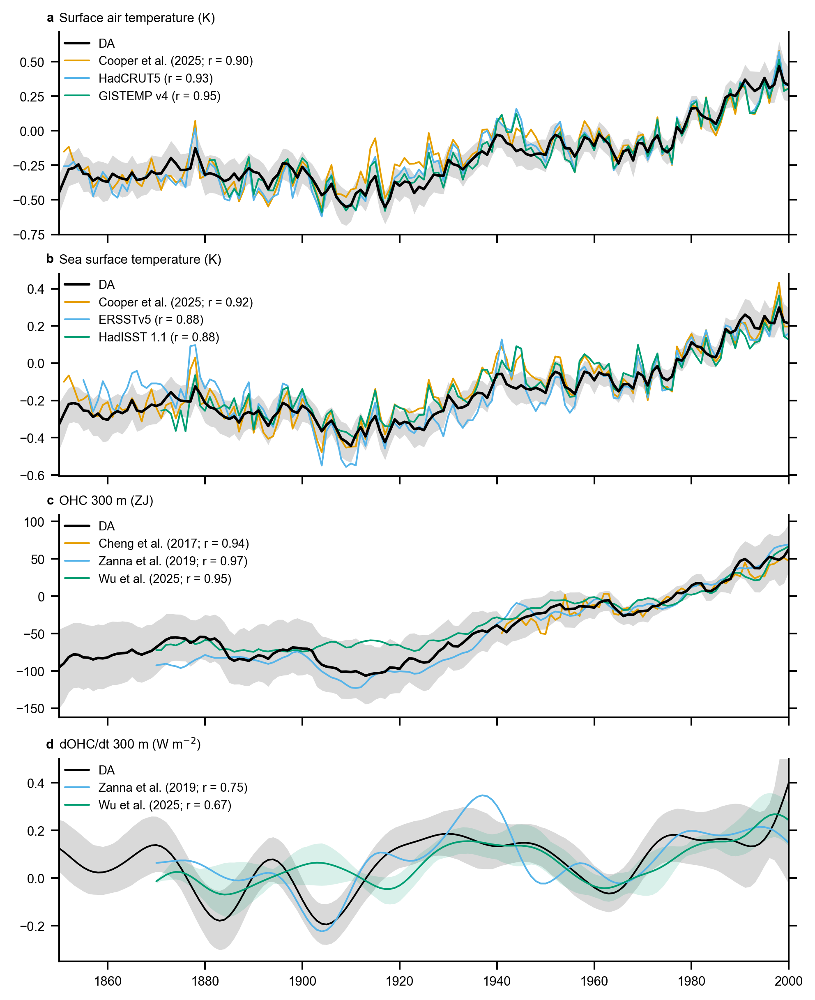

In [44]:
def plot_global_mean_instrumental():
    fig, axs = plt.subplots(4, 1, figsize=(figsize_overwidth_inline[0], 8), sharex=True)

    year_start = 1850
    year_end = 2000

    for i, (field, ax) in enumerate(zip(["tas", "tos", "ohc300_total"], axs[:-1])):
        scaling = get_field_scaling(field)

        gens = average_annually(posterior_global_means_gens)
        gens["ohc300_total"] = convert_ohc_per_ocean_area_to_total_ohc(gens["ohc300"])
        gens = gens[field]
        gens = gens.sel(time=slice(year_start, year_end)) / scaling
        ax.plot(gens.time, gens.mean("ens"), linewidth=1.5, c="black", label="DA", zorder=3)

        shade_ci(ax, gens, c="black")

        if field == "tas":
            cooper = average_annually(area_weighted_mean(ds_cooper25["tas"])).sel(time=slice(year_start, year_end))
            corr = xr.corr(cooper, gens.mean("ens"), "time").compute().item()
            ax.plot(cooper.time, cooper, label=f"Cooper et al. (2025; r = {corr:.2f})")
            hadcrut = average_annually(area_weighted_mean(ds_hadcrut["tas"])).sel(time=slice(year_start, year_end))
            corr = xr.corr(hadcrut, gens.mean("ens"), "time").compute().item()
            ax.plot(hadcrut.time, hadcrut, label=f"HadCRUT5 (r = {corr:.2f})")
            gistemp = average_annually(area_weighted_mean(ds_gistemp["tas"])).sel(time=slice(year_start, year_end))
            corr = xr.corr(gistemp, gens.mean("ens"), "time").compute().item()
            ax.plot(gistemp.time, gistemp, label=f"GISTEMP v4 (r = {corr:.2f})")
        if field == "tos":
            cooper = average_annually(area_weighted_mean(ds_cooper25["tos"])).sel(time=slice(year_start, year_end))
            corr = xr.corr(cooper, gens.mean("ens"), "time").compute().item()
            ax.plot(cooper.time, cooper, label=f"Cooper et al. (2025; r = {corr:.2f})")
            ersst = average_annually(area_weighted_mean(ds_ersst["tos"])).sel(time=slice(year_start, year_end))
            corr = xr.corr(ersst, gens.mean("ens"), "time").compute().item()
            ax.plot(ersst.time, ersst, label=f"ERSSTv5 (r = {corr:.2f})")
            hadisst = average_annually(area_weighted_mean(ds_hadisst["tos"])).sel(time=slice(year_start, year_end))
            corr = xr.corr(ersst, gens.mean("ens"), "time").compute().item()
            ax.plot(hadisst.time, hadisst, label=f"HadISST 1.1 (r = {corr:.2f})")
        if field == "ohc300_total":
            cheng = average_annually(convert_ohc_per_ocean_area_to_total_ohc(area_weighted_mean(ds_cheng2017["ohc300"]))).sel(time=slice(year_start, year_end)) / scaling
            corr = xr.corr(cheng, gens.mean("ens"), "time").compute().item()
            ax.plot(cheng.time, cheng, label=f"Cheng et al. (2017; r = {corr:.2f})")
            
            zanna = ds_zanna["ohc300"].sel(time=slice(year_start, year_end)) / scaling
            corr = xr.corr(zanna, gens.mean("ens"), "time").compute().item()
            ax.plot(zanna.time, zanna, label=f"Zanna et al. (2019; r = {corr:.2f})")

            wu = convert_ohc_per_ocean_area_to_total_ohc(area_weighted_mean(ds_wu25["ohc300"])).mean("ens").sel(time=slice(year_start, year_end)) / scaling
            corr = xr.corr(wu, gens.mean("ens"), "time").compute().item()
            ax.plot(wu.time, wu, label=f"Wu et al. (2025; r = {corr:.2f})")

        ax.set_title(get_field_label(field, True, scaling=scaling))
        ax.legend(loc="upper left")

        ax.spines.right.set_visible(True)
        ax.yaxis.set_ticks_position('both')
        ax.yaxis.set_tick_params(right=True)

        add_panel_label(ax, i)

    ax = axs[-1]
    field = "ddtohc300"

    gens = posterior_global_means_gens["ohc300"] * OCEAN_FRACTION
    gens = average_annually(gens)
    # gens = subsample_ensemble(gens, 200)
    gens = gens.differentiate("time") / SECONDS_PER_YEAR
    gens = lowpass_filter(gens, 20)
    gens = gens.sel(time=slice(year_start, year_end))
    ax.plot(gens.time, gens.mean("ens"), c="black", label="DA")
    shade_ci(ax, gens, c="black")

    zanna = convert_total_ohc_to_ohc_per_surface_area(ds_zanna["ohc300"])
    zanna = zanna.differentiate("time") / SECONDS_PER_YEAR
    zanna = lowpass_filter(zanna, 20)
    zanna = zanna.sel(time=slice(year_start, year_end))
    corr = xr.corr(zanna, gens.mean("ens"), "time").compute().item()
    ax.plot(zanna.time, zanna, label=f"Zanna et al. (2019; r = {corr:.2f})", c="C1")

    wu = area_weighted_mean(ds_wu25["ohc300"]) * OCEAN_FRACTION
    wu = wu.differentiate("time") / SECONDS_PER_YEAR
    wu = lowpass_filter(wu, 20)
    wu = wu.sel(time=slice(year_start, year_end))
    corr = xr.corr(wu.mean("ens"), gens.mean("ens"), "time").compute().item()
    ax.plot(wu.time, wu.mean("ens"), label=f"Wu et al. (2025; r = {corr:.2f})", c="C2")
    shade_ci(ax, wu, c="C2")

    ax.set_title(f"dOHC/dt 300 m ({get_field_unit("eei")})")
    ax.legend(loc="upper left")
    ax.spines.right.set_visible(True)
    ax.yaxis.set_ticks_position('both')
    ax.yaxis.set_tick_params(right=True)
    add_panel_label(ax, 3)
    ax.set_ylim(-0.35, 0.5)

    ax = axs[-1]
    ax.set_xlim(year_start, year_end)

    format_plot()
    save_plot(plot_folder_si, "timeseries_gm_instrumental")
    plt.show()

plot_global_mean_instrumental()

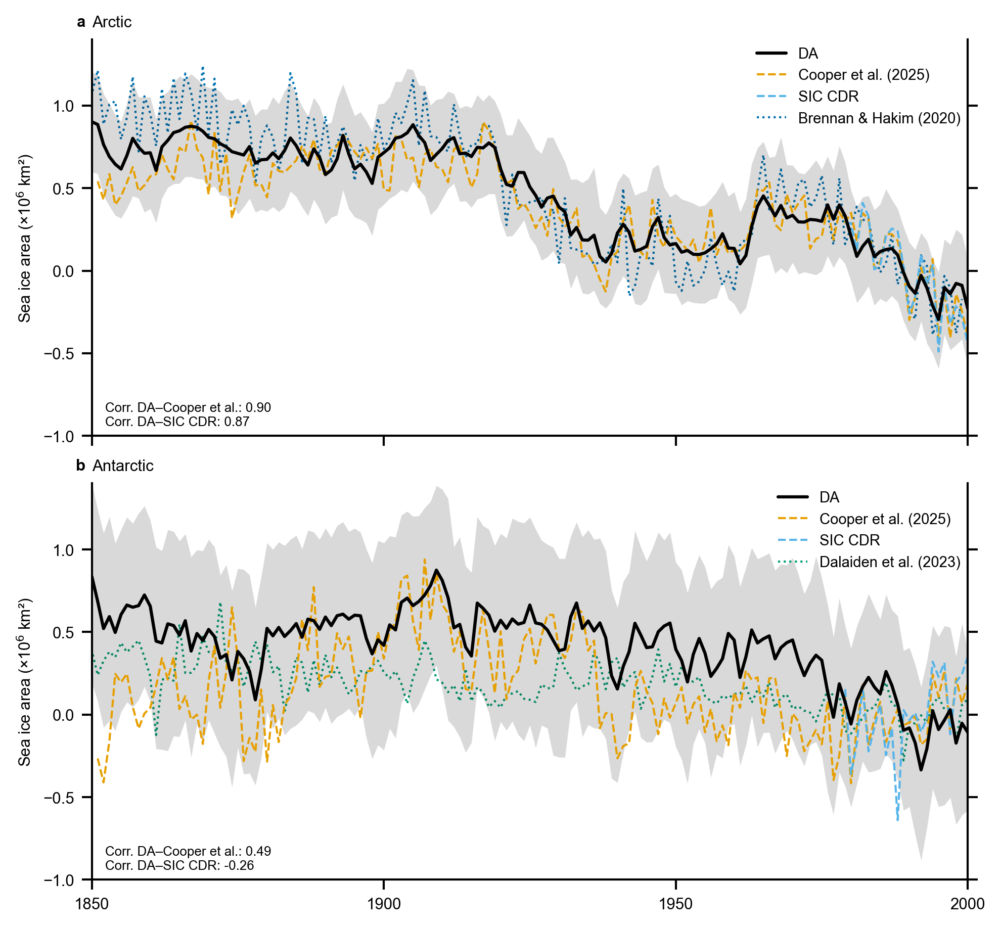

In [24]:
def plot_siarea_annual():
    fig, axs = plt.subplots(2, 1, figsize=(figsize_overwidth_inline[0], 6),
                            sharex=True, sharey=True)

    # ax.axhline(0, c="black", lw=0.5, alpha=0.2)

    for i, (field, ax) in enumerate(zip(["siarean", "siareas"], axs)):
        gens = posterior_indices_gens[field] / 1e6
        gens = anomalize(gens, (1979, 2001)).sel(time=slice(1850, 2001))
        gens = average_annually(gens)
        ax.plot(gens.time, gens.mean("ens"), linewidth=1.5, c="black",
                label="DA", zorder=3)

        shade_ci(ax, gens, c="black")
        
        cooper = ds_cooper25[field] / 1e6
        cooper = anomalize(cooper, (1979, 2001))
        cooper = average_annually(cooper)
        ax.plot(cooper.time, cooper, label="Cooper et al. (2025)",
                c="C0", ls="--")

        nsidc = ds_sic[field] / 1e6
        nsidc = anomalize(nsidc, (1979, 2001))
        nsidc = average_annually(nsidc)
        ax.plot(nsidc.time, nsidc, label="SIC CDR",
                c="C1", ls="--")

        if field == "siarean":
            brennan = ds_brennan[field].mean(["model", "ens"]) / 1e6
            brennan = anomalize(brennan, (1979, 2001))
            ax.plot(brennan.time, brennan, label="Brennan & Hakim (2020)",
                c="C3", ls=":", zorder=-3)

        if field == "siareas":
            dalaiden = ds_dalaiden2023[field] / 1e6
            dalaiden = anomalize(dalaiden, (1979, 2001))
            dalaiden = average_annually(dalaiden)
            ax.plot(dalaiden.time, dalaiden, label="Dalaiden et al. (2023)",
                c="C2", ls=":", zorder=-3)

        add_panel_label(ax, i)
        ax.set_ylabel(f"Sea ice area ({get_field_unit(field, 1e6)})")

        corr_cooper = xr.corr(gens.mean("ens"), cooper, "time").compute().item()
        corr_nsidc = xr.corr(gens.mean("ens"), nsidc, "time").compute().item()
        ax.text(
                0.015, 0.02, f"Corr. DA–Cooper et al.: {corr_cooper:.2f}\nCorr. DA–SIC CDR: {corr_nsidc:.2f}",
                transform=ax.transAxes,
                verticalalignment='bottom',
                horizontalalignment='left',
                fontsize="small",
        )

        ax.spines.right.set_visible(True)
        ax.yaxis.set_ticks_position('both')
        ax.yaxis.set_tick_params(right=True)

    axs[0].set_title("Arctic")
    axs[1].set_title("Antarctic")

    axs[0].legend(loc="upper right")
    axs[1].legend(loc="upper right")
    ax.set_xlim(1850, 2000)
    ax.set_ylim(-1, 1.4)
    ax.set_xticks(np.arange(1850, 2001, 50))

    format_plot()
    save_plot(plot_folder_si, "timeseries_siarea_annual")

plot_siarea_annual()

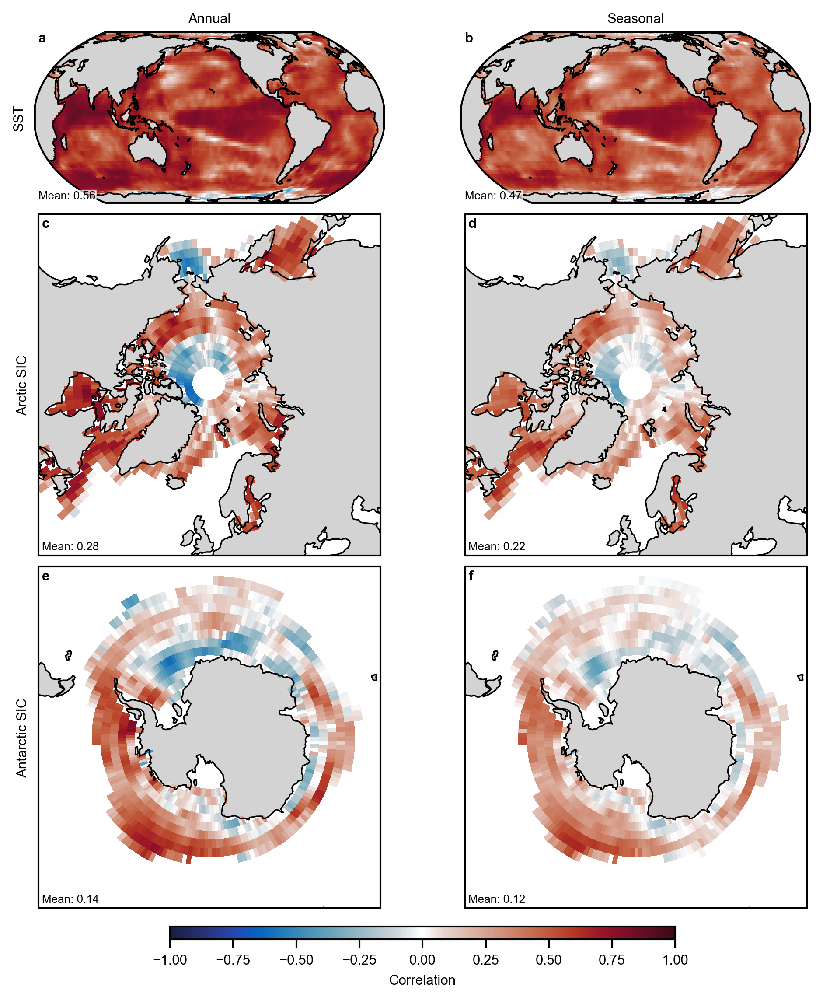

In [50]:
def plot_sst_sic_corr_map():
    def _mean(ax, da):
        ax.text(0.01, 0.01, f"Mean: {area_weighted_mean(da).compute().item():.2f}",
                transform=ax.transAxes, verticalalignment='bottom', horizontalalignment='left',
                fontsize="small", bbox=dict(facecolor="white", pad=0.1, alpha=0.6))

    fig = plt.figure(figsize=(figsize_overwidth_inline[0], 7.5))
    gs = fig.add_gridspec(3, 2, height_ratios=[1, 2, 2])
    axs = np.empty((3, 2), dtype=object)

    axs[0, 0] = fig.add_subplot(gs[0, 0], projection=ccrs.EqualEarth(central_longitude=200))
    axs[0, 1] = fig.add_subplot(gs[0, 1], projection=ccrs.EqualEarth(central_longitude=200))
    axs[1, 0] = fig.add_subplot(gs[1, 0], projection=ccrs.NorthPolarStereo())
    axs[1, 1] = fig.add_subplot(gs[1, 1], projection=ccrs.NorthPolarStereo())
    axs[2, 0] = fig.add_subplot(gs[2, 0], projection=ccrs.SouthPolarStereo())
    axs[2, 1] = fig.add_subplot(gs[2, 1], projection=ccrs.SouthPolarStereo())

    for ax in axs[1, :]:
        ax.set_extent([0, 360, 50, 90], ccrs.PlateCarree())
    for ax in axs[2, :]:
        ax.set_extent([0, 360, -90, -50], ccrs.PlateCarree())

    recon_siconc = anomalize(xr.concat([
        posterior_mean_gens["siconcs"].sel(lat=slice(-90, 0)), posterior_mean_gens["siconcn"].sel(lat=slice(0, 90))
        ], dim="lat"), (1979, 2001))
    recon_sst = posterior_mean_gens["tos"]
    hadisst = ds_hadisst["tos"]
    cdr = anomalize(ds_sic["siconc"], (1979, 2001))
    cdr = cdr.where(cdr.lat <= 85)

    recon_siconc_ann = average_annually(recon_siconc)
    recon_sst_ann = average_annually(recon_sst)
    hadisst_ann = average_annually(hadisst)
    cdr_ann = average_annually(cdr)

    corr = xr.corr(recon_sst, hadisst, "time").compute()
    corr_ann = xr.corr(recon_sst_ann, hadisst_ann, "time").compute()
    plot_field(
        axs[0, :], [corr_ann, corr],
        vmin=-1, vmax=1, shade_land=True, colorbar=False)
    _mean(axs[0, 0], corr_ann)
    _mean(axs[0, 1], corr)
    add_panel_label(axs[0, 0], 0, xytext=(2, 0), ha='left', va="top")
    add_panel_label(axs[0, 1], 1, xytext=(2, 0), ha='left', va="top")

    corr = xr.corr(recon_siconc, cdr, "time").compute()
    corr_ann = xr.corr(recon_siconc_ann, cdr_ann, "time").compute()
    plot_field(
        axs[1, :], [corr_ann, corr],
        vmin=-1, vmax=1, shade_land=True, colorbar=False)
    _mean(axs[1, 0], corr_ann.sel(lat=slice(0, 90)))
    _mean(axs[1, 1], corr.sel(lat=slice(0, 90)))
    add_panel_label(axs[1, 0], 2, xytext=(2, -2), ha='left', va="top")
    add_panel_label(axs[1, 1], 3, xytext=(2, -2), ha='left', va="top")

    corr = xr.corr(recon_siconc, cdr, "time").compute()
    corr_ann = xr.corr(recon_siconc_ann, cdr_ann, "time").compute()
    plot_field(
        axs[2, :], [corr_ann, corr],
        vmin=-1, vmax=1, shade_land=True, colorbar=True, extend="neither",
        cbar_kwargs={"shrink": 0.6}, cbar_label="Correlation")
    _mean(axs[2, 0], corr_ann.sel(lat=slice(-90, 0)))
    _mean(axs[2, 1], corr.sel(lat=slice(-90, 0)))
    add_panel_label(axs[2, 0], 4, xytext=(2, -2), ha='left', va="top")
    add_panel_label(axs[2, 1], 5, xytext=(2, -2), ha='left', va="top")
            
    add_subplot_headers(["SST", "Arctic SIC", "Antarctic SIC"], ["Annual", "Seasonal"],
                        fontweight="regular", fontsize="medium", col_pad=5)

    save_plot(plot_folder_si, "sst_sic_corr_map")

plot_sst_sic_corr_map()

<xarray.DataArray 'time' (time: 19)> Size: 152B
[19 values with dtype=object]
Coordinates:
  * time     (time) object 152B MultiIndex
  * year     (time) int64 152B 1028 1108 1171 1191 1230 ... 1809 1815 1835 1883
  * season   (time) object 152B Season.DJF Season.DJF ... Season.DJF Season.JJA
    region   <U6 24B 'global'
nhsummertas -0.2212118812983719
nino34_index -0.35064569115638733
siarean -0.03984478861093521
siareas -0.056293785572052


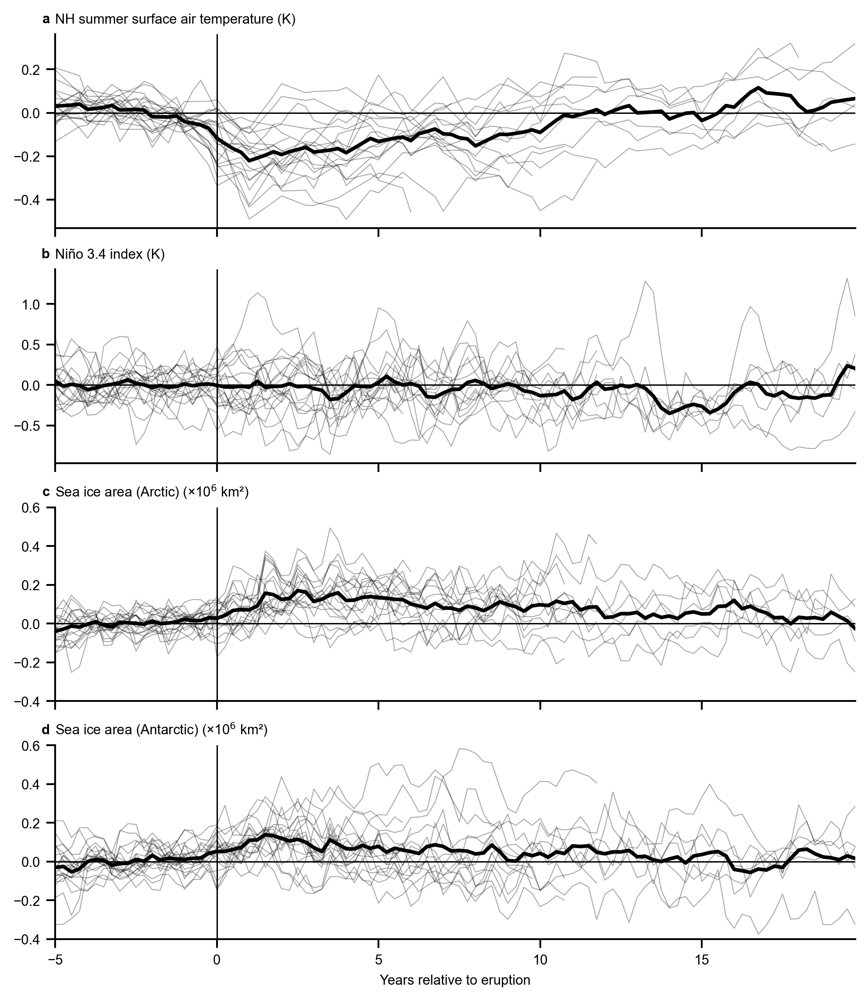

In [214]:
def plot_volcano_composite_supplement(vssi_min=7.5, lat_max=30, n_before=20, n_after=80, n_climo=20):
    eruptions = use_tuple_time_coords(ds_evolv2k.sel(time=ds_evolv2k["vssi"] >= vssi_min), True).drop_duplicates(dim="time")
    eruptions = eruptions.sel(time=((eruptions.lat >= -lat_max) & (eruptions.lat < lat_max)))

    eruptions_trim = use_tuple_time_coords(ds_evolv2k.sel(time=ds_evolv2k["vssi"] > 1), True).drop_duplicates(dim="time")

    recon = xr.merge([posterior_global_means_gens, posterior_indices_gens]).mean("ens")
    recon["nhsummertas"] = use_tuple_time_coords(
        posterior_regional_means_gens
    )["tas"].sel(region="NH", season=Season.JJA).rename(year="time").mean("ens").compute().interp_like(recon)
    recon = use_tuple_time_coords(recon)

    eruption_times, eruptions = xr.align(recon.time, eruptions, join="inner")
    recon_sel = []
    for i, eruption_time in enumerate(eruption_times):
        idx = recon.get_index("time").get_loc(eruption_time.item())
        # Trim if there is another eruption within the window
        if i == len(eruption_times) - 1:
            eruption_time_next = None
        else:
            eruption_time_next = use_decimal_year_time_coords(eruptions_trim).sel(
                    time=use_decimal_year_time_coords(eruption_time).time+0.05, method="backfill").time

        recon_eruption = use_decimal_year_time_coords(
            recon.isel(time=slice(idx-n_before, idx+n_after+1))
        ).sel(time=slice(None, eruption_time_next)).isel(time=slice(None, -1))
        climo = recon.isel(time=slice(idx-n_climo, idx)).groupby("season").mean("time").compute()
        recon_sel.append(
            (add_season_coords(recon_eruption).groupby("season") - climo)
            .assign_coords(eruption=i, time=np.arange(-n_before, -n_before + len(recon_eruption.time)))
        )
    recon_sel = xr.concat(recon_sel, dim="eruption")
    print(eruption_times)

    fig, axs = plt.subplots(4, 1, figsize=(figsize_overwidth_inline[0], 7.5), sharex=True)

    for i, (field, ax) in enumerate(zip(["nhsummertas", "nino34_index", "siarean", "siareas"], axs.flat)):
        scaling = get_field_scaling(field)

        ax.axvline(0, c="black", zorder=-3, lw=0.75)
        # ax.axvline(1, c="black")
        # ax.axvline(2, c="black")
        # ax.axvline(3, c="black")
        # ax.axvline(4, c="black")
        ax.axhline(0, c="black", zorder=-3, lw=0.75)

        for eruption in recon_sel.eruption:
            c = "black"
            lw = 0.5
            alpha = 0.35
            ax.plot(recon_sel.time / 4, recon_sel[field].sel(eruption=eruption) / scaling,
                    lw=lw, c=c, alpha=alpha)

        print(field, (recon_sel[field].mean("eruption") / scaling).min().compute().item())
        ax.plot(recon_sel.time / 4, recon_sel[field].mean("eruption") / scaling,
                c="black", lw=2)

        ax.set_xlim(-n_before/4, (n_after-1)/4)
        if field == "nhsummertas":
            ax.set_title("NH summer surface air temperature (K)")
        else:
            ax.set_title(f"{get_field_label(field, True, scaling)}")
        add_panel_label(ax, i)
        if field.startswith("siarea"):
            ax.set_ylim([-0.4, 0.6])

    axs[-1].set_xlabel("Years relative to eruption")
    
    format_plot()
    save_plot(plot_folder_si, "composite_volcano_supplement")

plot_volcano_composite_supplement()

<xarray.DataArray 'time' (time: 19)> Size: 152B
[19 values with dtype=object]
Coordinates:
  * time     (time) object 152B MultiIndex
  * year     (time) int64 152B 1028 1108 1171 1191 1230 ... 1809 1815 1835 1883
  * season   (time) object 152B Season.DJF Season.DJF ... Season.DJF Season.JJA
tas -0.5697135964264808 0.10557312557657725
ohc300_total -61.122243161029 6.891707111254155
rsut -0.6757235267644592 7.004816606469699
eei -3.5951402909692187 0.6255129323278109


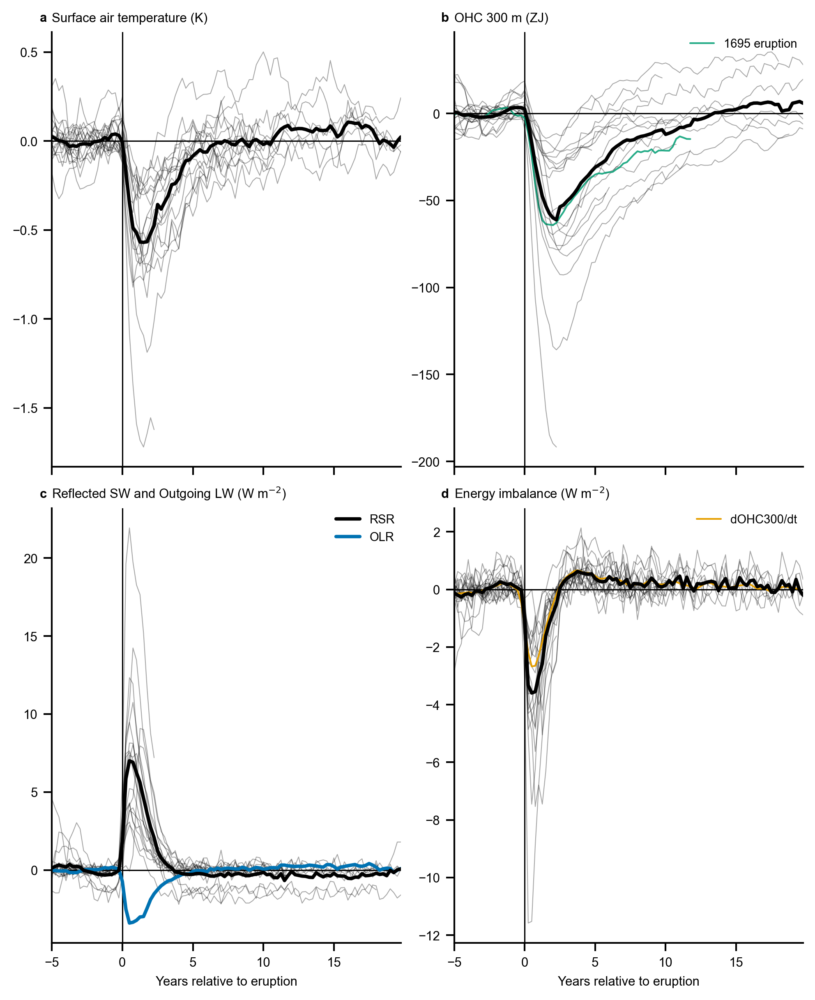

In [217]:
def plot_volcano_composite_models(vssi_min=7.5, lat_max=30, n_before=20, n_after=80, n_climo=20):
    eruptions = use_tuple_time_coords(ds_evolv2k.sel(time=ds_evolv2k["vssi"] >= vssi_min), True).drop_duplicates(dim="time")
    eruptions = eruptions.sel(time=((eruptions.lat >= -lat_max) & (eruptions.lat < lat_max)))

    eruptions_trim = use_tuple_time_coords(ds_evolv2k.sel(time=ds_evolv2k["vssi"] > 1), True).drop_duplicates(dim="time")

    recon = area_weighted_mean(sims_models_gens.mean("model")[["ohc300", "tas", "rsut", "rlut", "eei"]])
    recon["ddtohc300"] = recon["ohc300"].differentiate("time") / SECONDS_PER_YEAR * OCEAN_FRACTION
    recon["ohc300_total"] = convert_ohc_per_ocean_area_to_total_ohc(recon["ohc300"])
    recon = use_tuple_time_coords(recon)

    eruption_times, eruptions = xr.align(recon.time, eruptions, join="inner")
    recon_sel = []
    for i, eruption_time in enumerate(eruption_times):
        idx = recon.get_index("time").get_loc(eruption_time.item())
        # Trim if there is another eruption within the window
        if i == len(eruption_times) - 1:
            eruption_time_next = None
        else:
            eruption_time_next = use_decimal_year_time_coords(eruptions_trim).sel(
                    time=use_decimal_year_time_coords(eruption_time).time+0.05, method="backfill").time

        recon_eruption = use_decimal_year_time_coords(
            recon.isel(time=slice(idx-n_before, idx+n_after+1))
        ).sel(time=slice(None, eruption_time_next)).isel(time=slice(None, -1))
        climo = recon.isel(time=slice(idx-n_climo, idx)).groupby("season").mean("time").compute()
        recon_sel.append(
            (add_season_coords(recon_eruption).groupby("season") - climo)
            .assign_coords(eruption=i, time=np.arange(-n_before, -n_before + len(recon_eruption.time)))
        )
    recon_sel = xr.concat(recon_sel, dim="eruption")
    print(eruption_times)

    fig, axs = plt.subplots(2, 2, figsize=(figsize_overwidth_inline[0], 8), sharex=True)

    for i, (field, ax) in enumerate(zip(["tas", "ohc300_total", "rsut", "eei"], axs.flat)):
        scaling = get_field_scaling(field)

        ax.axvline(0, c="black", zorder=-3, lw=0.75)
        # ax.axvline(1, c="black")
        # ax.axvline(2, c="black")
        # ax.axvline(3, c="black")
        # ax.axvline(4, c="black")
        ax.axhline(0, c="black", zorder=-3, lw=0.75)

        for eruption in recon_sel.eruption:
            c = "black"
            lw = 0.5
            alpha = 0.35
            label = None
            legend = False
            if field == "ohc300_total":
                if eruption_times.isel(time=eruption).item() == (1695, Season.DJF):
                    c = "C2"
                    lw = 1
                    alpha = 0.85
                    label = "1695 eruption"
                    legend = True
                # elif eruption_times.isel(time=eruption).item() == (1815, Season.MAM):
                #     c = "C2"
                #     lw = 1
                #     alpha = 0.85
                #     label = "1815 eruption (Tambora)"
                #     legend = True
            ax.plot(recon_sel.time / 4, recon_sel[field].sel(eruption=eruption) / scaling,
                    lw=lw, c=c, alpha=alpha, label=label)
            if legend:
                ax.legend()
        
        if field == "eei":
            ax.plot(recon_sel.time / 4, recon_sel["ddtohc300"].mean("eruption").compute().rolling(time=3, center=True).mean(),
                    c="C0", label="dOHC300/dt")
            ax.legend()

        print(field, (recon_sel[field].mean("eruption") / scaling).min().compute().item(),
                (recon_sel[field].mean("eruption") / scaling).max().compute().item())
        if field == "rsut":
            ax.plot(recon_sel.time / 4, recon_sel["rsut"].mean("eruption") / scaling,
                    c="black", lw=2, label="RSR", zorder=5)
            ax.plot(recon_sel.time / 4, recon_sel["rlut"].mean("eruption") / scaling,
                    c="C3", lw=2, label="OLR")
            ax.legend()
        else:
            ax.plot(recon_sel.time / 4, recon_sel[field].mean("eruption") / scaling,
                    c="black", lw=2)

        ax.set_xlim(-n_before/4, (n_after-1)/4)
        if field == "rsut":
            ax.set_title(f"Reflected SW and Outgoing LW ({get_field_unit(field, scaling)})")
        else:
            ax.set_title(f"{get_field_label(field, True, scaling)}")
        add_panel_label(ax, i)
    
    # EEI same limits as RSUT
    # axs[1, 1].set_ylim(axs[1, 0].get_ylim())

    for ax in axs[1, :]:
        ax.set_xlabel("Years relative to eruption")
    
    format_plot()
    save_plot(plot_folder_si, "composite_volcano_models")

plot_volcano_composite_models()

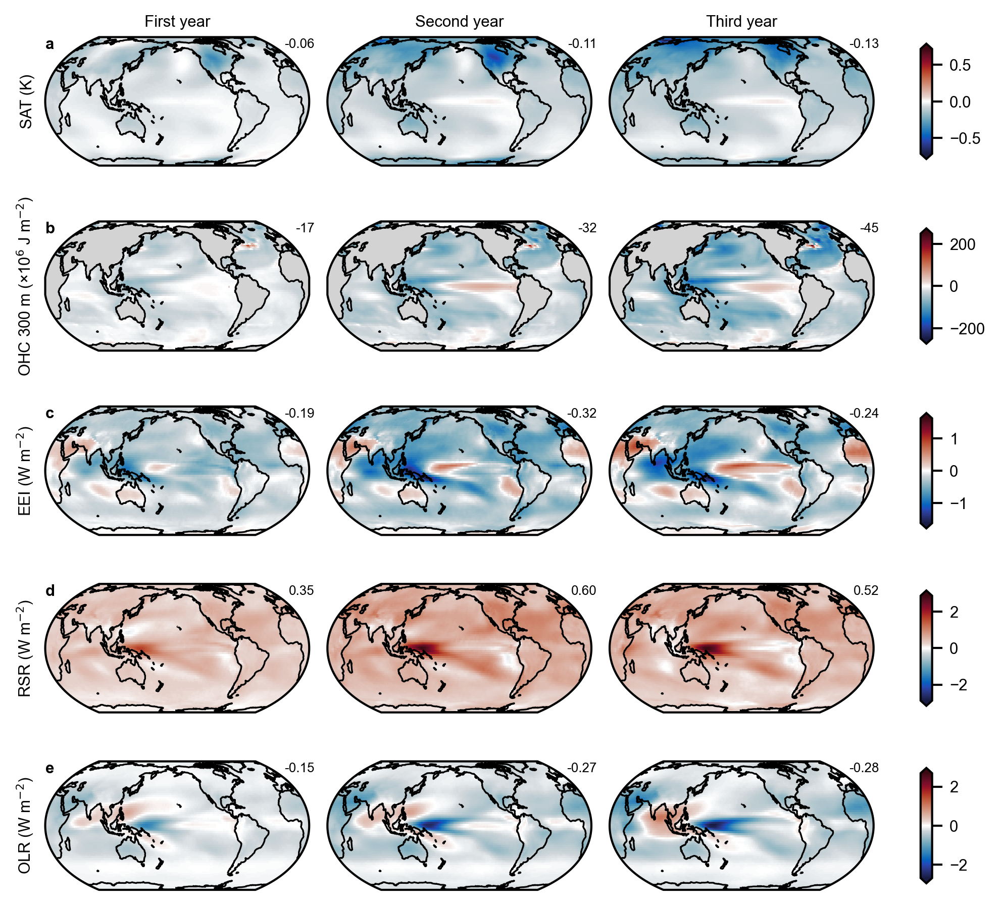

In [216]:
def plot_volcanic_composite_map_annual(vssi_min=7.5, lat_max=30, n_climo=20):
    eruptions = use_tuple_time_coords(ds_evolv2k.sel(time=ds_evolv2k["vssi"] >= vssi_min), True).drop_duplicates(dim="time").sel(time=slice(850, None))
    eruptions = eruptions.sel(time=((eruptions.lat >= -lat_max) & (eruptions.lat < lat_max)))

    eruptions_trim = use_tuple_time_coords(ds_evolv2k.sel(time=ds_evolv2k["vssi"] > 1), True).drop_duplicates(dim="time")

    recon = use_tuple_time_coords(posterior_mean_gens)

    eruption_times, eruptions = xr.align(recon.time, eruptions, join="inner")
    recon_sel = []
    n_after_yr = 3
    for i, eruption_time in enumerate(eruption_times):
        idx = recon.get_index("time").get_loc(eruption_time.item())
        # Trim if there is another eruption within the window
        if i == len(eruption_times) - 1:
            eruption_time_next = None
        else:
            eruption_time_next = use_decimal_year_time_coords(eruptions_trim).sel(
                    time=use_decimal_year_time_coords(eruption_time).time+0.05, method="backfill").time

        recon_eruption = use_decimal_year_time_coords(
            recon.isel(time=slice(idx, idx+n_after_yr*4+1))
        ).sel(time=slice(None, eruption_time_next)).isel(time=slice(None, -1)).compute()
        climo = recon.isel(time=slice(idx-n_climo, idx)).groupby("season").mean("time").compute()
        recon_sel.append(
            (add_season_coords(recon_eruption).groupby("season") - climo)
            .assign_coords(eruption=i, time=np.arange(len(recon_eruption.time)))
        )
    recon_sel = xr.concat(recon_sel, dim="eruption").mean("eruption")

    fields = ["tas", "ohc300", "eei", "rsut", "rlut"]
    recon_sel = recon_sel.groupby_bins(group="time", bins=np.arange(0, n_after_yr+1)*4, right=False).mean()
    assert len(recon_sel.time_bins) == n_after_yr

    fig, axs = subplots_cartopy(len(fields), n_after_yr, figsize=(figsize_overwidth_inline[0], 6))
    for i, field in enumerate(fields):
        scaling = get_field_scaling(field)
        times = [recon_sel[field].sel(time_bins=time) / scaling for time in recon_sel.time_bins]
        plot_field(axs[i, :], times, cbar_orientation="vertical", cbar_kwargs={"shrink": 0.7},
                   shade_land=is_ocean_field(field), cbar_aspect=10)
        for j, time in enumerate(times):
            label = f"{area_weighted_mean(time):.0f}" if field == "ohc300" else f"{area_weighted_mean(time):.2f}"
            axs[i, j].text(
                1.02, 0.99, label,
                transform=axs[i, j].transAxes,
                ha="right", va="top",
                fontsize="small",
            )
        add_panel_label(axs[i, 0], i, xytext=(0, 0), ha='left', va="top")

    add_subplot_headers(
        [get_field_shorthand_label(field, True, get_field_scaling(field)) for field in fields],
        ["First year", "Second year", "Third year"],
        fontweight="regular", fontsize="medium", col_pad=5
    )
    save_plot(plot_folder_si, "composite_volcano_map")

plot_volcanic_composite_map_annual()

-35.17266845703125
1138.5416666666667
-61.971771240234375
1293.0416666666667


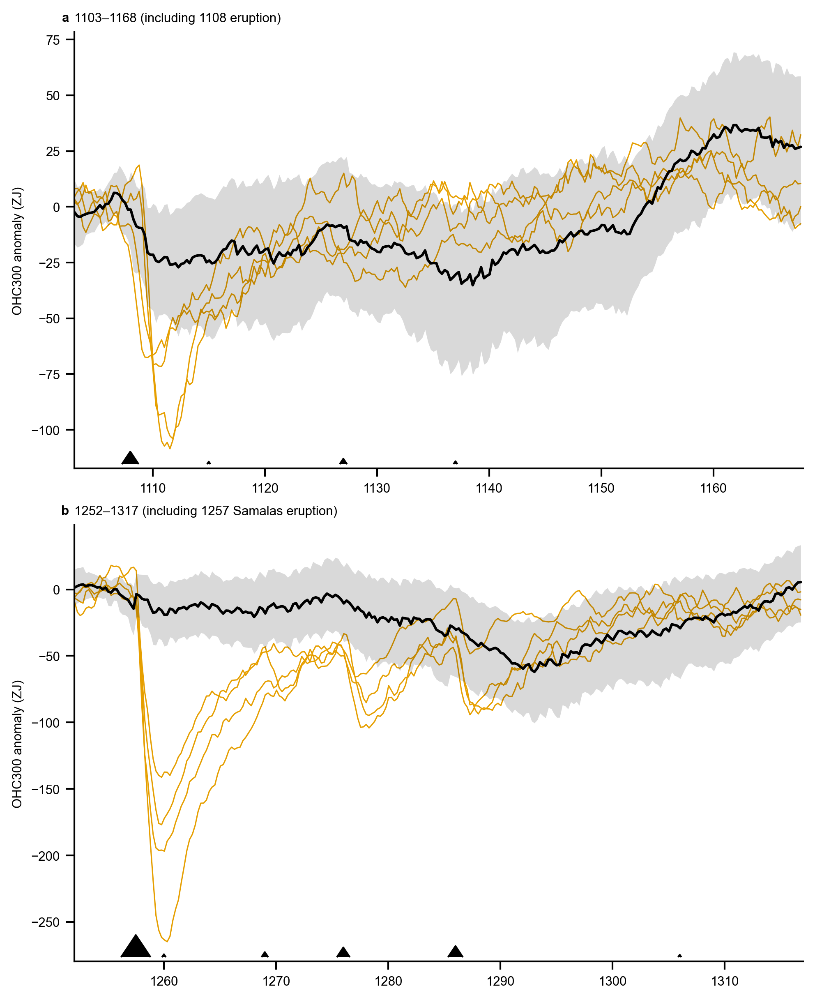

In [24]:
def plot_eruption_ohc_examples():
    fig, axs = plt.subplots(2, 1, figsize=(figsize_overwidth_inline[0], 8))

    ax = axs[0]
    x = convert_ohc_per_ocean_area_to_total_ohc(posterior_global_means_gens["ohc300"]) / 1e21
    start = 1103
    x = anomalize(x, (start, start+5))
    x = x.sel(time=slice(start, start + 65))
    print(x.mean("ens").min().compute().item())
    print(x.mean("ens").idxmin().compute().item())
    ax.plot(x.time, x.mean("ens"), c="black", label="DA", lw=1.5)
    shade_ci(ax, x, c="black")

    for i, x in enumerate(sims_models):
        x = area_weighted_mean(x["ohc300"])
        x = convert_ohc_per_ocean_area_to_total_ohc(x) / 1e21
        x = anomalize(x, (start, start+5))
        x = x.sel(time=slice(start, start + 65))
        ax.plot(x.time, x, c="C0", zorder=-1, lw=0.75, label="Models" if i==0 else None)

    trans = mpl.transforms.blended_transform_factory(
                ax.transData, ax.transAxes)
    ax.scatter(ds_eruptions.time, 0.01 * np.ones(len(ds_eruptions.time)), transform=trans,
                s=ds_eruptions.vssi*5, c="black", marker=mpl.markers.CARETUPBASE)

    ax.set_xlim(start, start + 65)
    # ax.set_ylim(-100, 50)
    ax.set_ylabel("OHC300 anomaly (ZJ)")
    ax.set_title(f"{start}–{start+65} (including 1108 eruption)")
    add_panel_label(ax, 0)

    ax = axs[1]
    x = convert_ohc_per_ocean_area_to_total_ohc(posterior_global_means_gens["ohc300"]) / 1e21
    start = 1252
    x = anomalize(x, (start, start+5))
    x = x.sel(time=slice(start, start + 65))
    print(x.mean("ens").min().compute().item())
    print(x.mean("ens").idxmin().compute().item())
    ax.plot(x.time, x.mean("ens"), c="black", label="DA", lw=1.5)
    shade_ci(ax, x, c="black")

    for i, x in enumerate(sims_models):
        x = area_weighted_mean(x["ohc300"])
        x = convert_ohc_per_ocean_area_to_total_ohc(x) / 1e21
        x = anomalize(x, (start, start+5))
        x = x.sel(time=slice(start, start + 65))
        ax.plot(x.time, x, c="C0", zorder=-1, lw=0.75, label="Models" if i==0 else None)

    trans = mpl.transforms.blended_transform_factory(
                ax.transData, ax.transAxes)
    ax.scatter(ds_eruptions.time, 0.01 * np.ones(len(ds_eruptions.time)), transform=trans,
                s=ds_eruptions.vssi*5, c="black", marker=mpl.markers.CARETUPBASE)

    ax.set_xlim(start, start + 65)
    # ax.set_ylim(-100, 50)
    ax.set_ylabel("OHC300 anomaly (ZJ)")
    ax.set_title(f"{start}–{start+65} (including 1257 Samalas eruption)")
    add_panel_label(ax, 1)

    save_plot(plot_folder_si, "eruption_ohc_examples")

plot_eruption_ohc_examples()

-54.87015151977539
1704.7916666666667
-58.13838577270508
1818.7916666666667


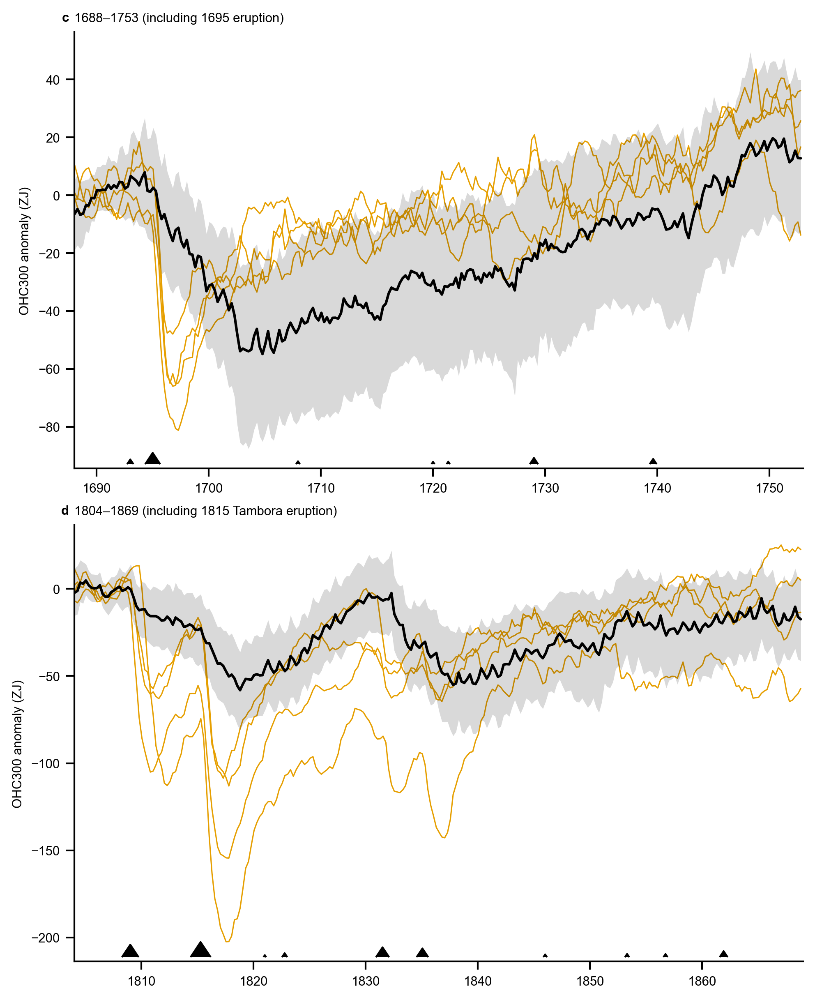

In [22]:
def plot_eruption_ohc_examples2():
    fig, axs = plt.subplots(2, 1, figsize=(figsize_overwidth_inline[0], 8))

    ax = axs[0]
    x = convert_ohc_per_ocean_area_to_total_ohc(posterior_global_means_gens["ohc300"]) / 1e21
    start = 1688
    x = anomalize(x, (start, start+5))
    x = x.sel(time=slice(start, start + 65))
    print(x.mean("ens").min().compute().item())
    print(x.mean("ens").idxmin().compute().item())
    ax.plot(x.time, x.mean("ens"), c="black", lw=1.5)
    shade_ci(ax, x, c="black")

    for i, x in enumerate(sims_models):
        x = area_weighted_mean(x["ohc300"])
        x = convert_ohc_per_ocean_area_to_total_ohc(x) / 1e21
        x = anomalize(x, (start, start+5))
        x = x.sel(time=slice(start, start + 65))
        ax.plot(x.time, x, c="C0", zorder=-1, lw=0.75)

    trans = mpl.transforms.blended_transform_factory(
                ax.transData, ax.transAxes)
    ax.scatter(ds_eruptions.time, 0.01 * np.ones(len(ds_eruptions.time)), transform=trans,
                s=ds_eruptions.vssi*5, c="black", marker=mpl.markers.CARETUPBASE)

    ax.set_xlim(start, start + 65)
    # ax.set_ylim(-100, 50)
    ax.set_ylabel("OHC300 anomaly (ZJ)")
    ax.set_title(f"{start}–{start+65} (including 1695 eruption)")
    ax.legend()
    add_panel_label(ax, 2)

    ax = axs[1]
    x = convert_ohc_per_ocean_area_to_total_ohc(posterior_global_means_gens["ohc300"]) / 1e21
    start = 1804
    x = anomalize(x, (start, start+5))
    x = x.sel(time=slice(start, start + 65))
    print(x.mean("ens").min().compute().item())
    print(x.mean("ens").idxmin().compute().item())
    ax.plot(x.time, x.mean("ens"), c="black", lw=1.5)
    shade_ci(ax, x, c="black")

    for i, x in enumerate(sims_models):
        x = area_weighted_mean(x["ohc300"])
        x = convert_ohc_per_ocean_area_to_total_ohc(x) / 1e21
        x = anomalize(x, (start, start+5))
        x = x.sel(time=slice(start, start + 65))
        ax.plot(x.time, x, c="C0", zorder=-1, lw=0.75)

    trans = mpl.transforms.blended_transform_factory(
                ax.transData, ax.transAxes)
    ax.scatter(ds_eruptions.time, 0.01 * np.ones(len(ds_eruptions.time)), transform=trans,
                s=ds_eruptions.vssi*5, c="black", marker=mpl.markers.CARETUPBASE)

    ax.set_xlim(start, start + 65)
    # ax.set_ylim(-100, 50)
    ax.set_ylabel("OHC300 anomaly (ZJ)")
    ax.set_title(f"{start}–{start+65} (including 1815 Tambora eruption)")
    add_panel_label(ax, 3)

    save_plot(plot_folder_si, "eruption_ohc_examples2")

plot_eruption_ohc_examples2()

In [83]:
def calculate_aa():
    trend_global = area_weighted_mean(posterior_zonal_means_gens["tas"]).sel(time=slice(850, 1850)).mean("ens").polyfit("time", 1)["polyfit_coefficients"].sel(degree=1).compute()
    trend_arctic = area_weighted_mean(posterior_zonal_means_gens["tas"].sel(lat=slice(66.5, None))).sel(time=slice(850, 1850)).mean("ens").polyfit("time", 1)["polyfit_coefficients"].sel(degree=1).compute()
    print("AA of ens mean:", (trend_arctic / trend_global).item())

    trend_global = area_weighted_mean(posterior_zonal_means_gens["tas"]).sel(time=slice(850, 1850)).polyfit("time", 1)["polyfit_coefficients"].sel(degree=1).compute()
    trend_arctic = area_weighted_mean(posterior_zonal_means_gens["tas"].sel(lat=slice(66.5, None))).sel(time=slice(850, 1850)).polyfit("time", 1)["polyfit_coefficients"].sel(degree=1).compute()
    print("Ens mean of AA:", (trend_arctic / trend_global).mean("ens").item())

calculate_aa()

AA of ens mean: 3.928614552212339
Ens mean of AA: 3.9864735195286802


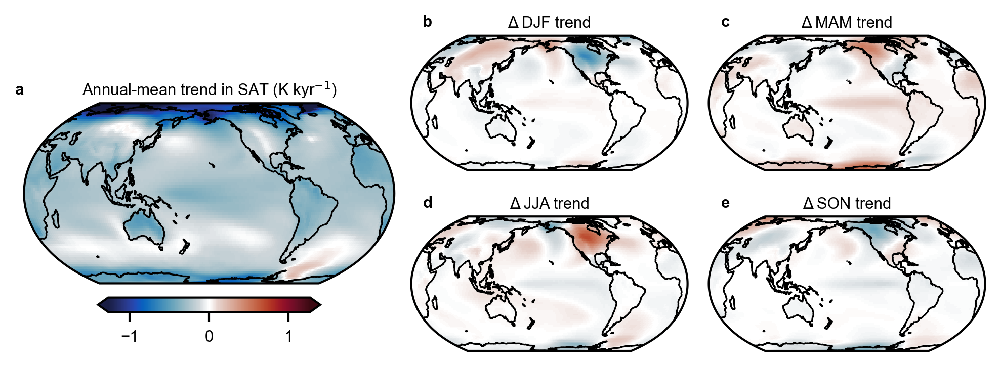

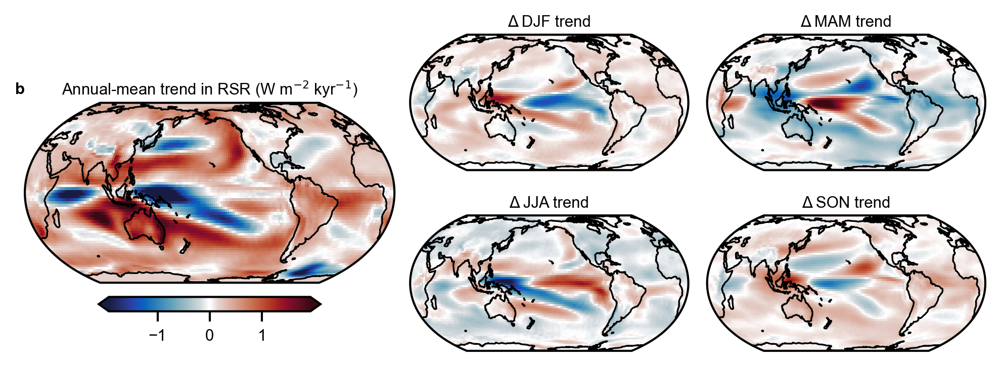

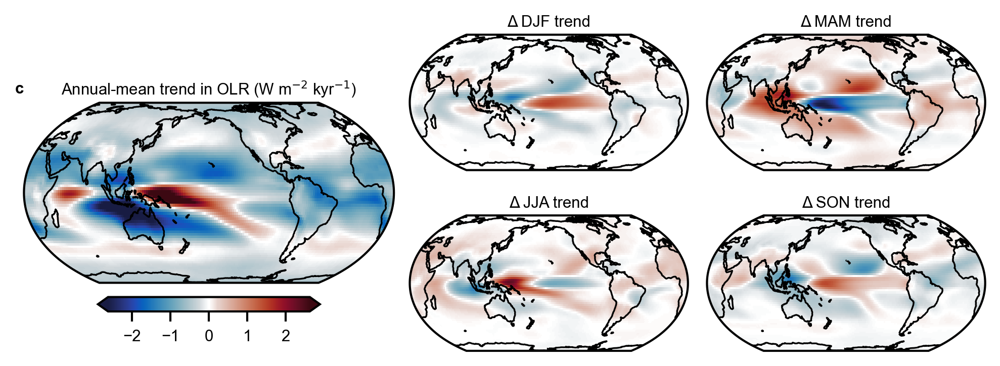

In [15]:
plot_lm_trend_distribution(0, "tas")
plot_lm_trend_distribution(1, "rsut")
plot_lm_trend_distribution(2, "rlut")

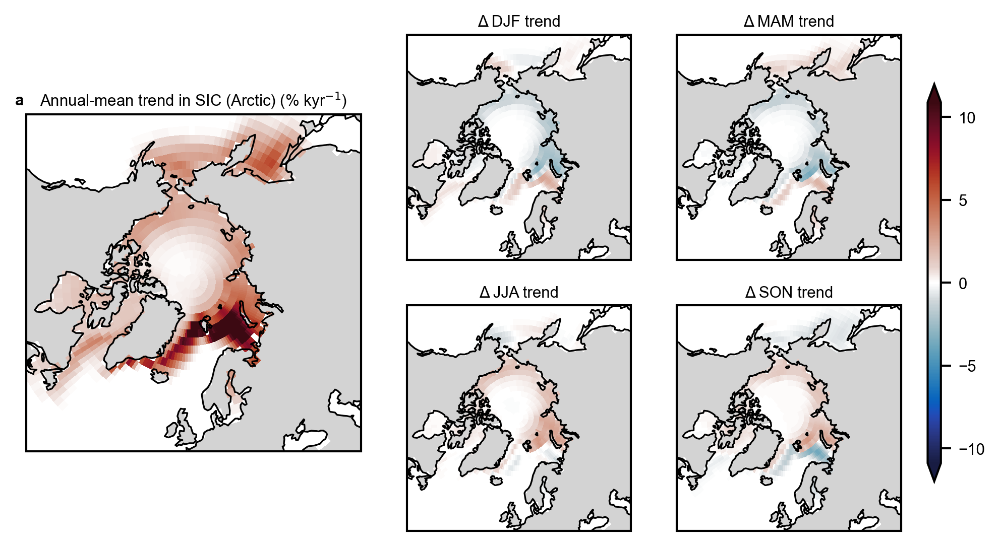

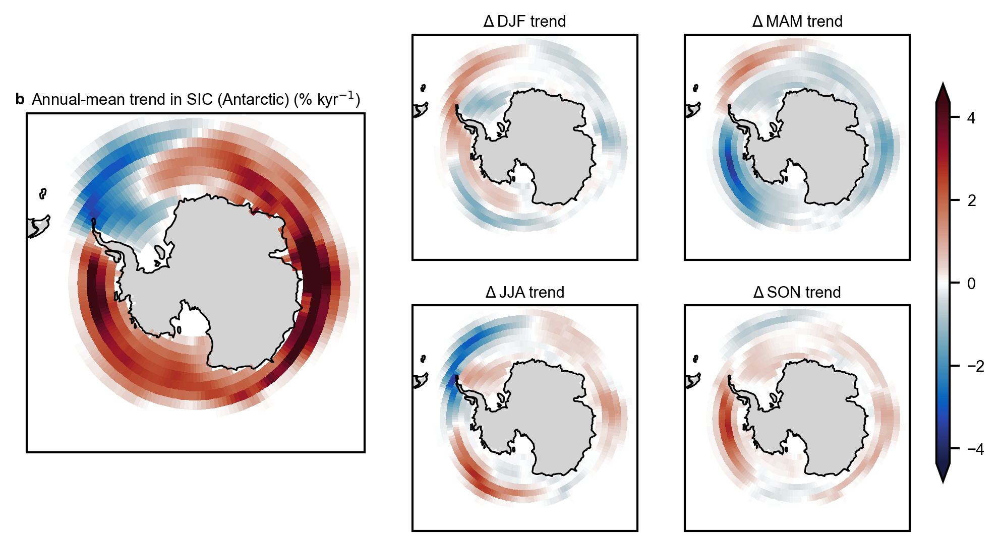

In [294]:
def plot_lm_trend_distribution_siconc(i, field, departures=True):
    fig = plt.figure(figsize=(figsize_overwidth_inline[0], 3.5))
    gs = mpl.gridspec.GridSpec(2, 3, figure=fig, width_ratios=[1.3, 1, 1])

    if field == "siconcn":
        ax_big = fig.add_subplot(gs[:, 0], projection=ccrs.NorthPolarStereo())
        axs = np.array([
            [ax_big, fig.add_subplot(gs[0, 1], projection=ccrs.NorthPolarStereo()), fig.add_subplot(gs[0, 2], projection=ccrs.NorthPolarStereo())],
            [None, fig.add_subplot(gs[1, 1], projection=ccrs.NorthPolarStereo()), fig.add_subplot(gs[1, 2], projection=ccrs.NorthPolarStereo())]
        ])
        for ax in axs.flat:
            if ax is None: continue
            ax.set_extent([0, 360, 49, 90], crs=ccrs.PlateCarree())
    elif field == "siconcs":
        ax_big = fig.add_subplot(gs[:, 0], projection=ccrs.SouthPolarStereo())
        axs = np.array([
            [ax_big, fig.add_subplot(gs[0, 1], projection=ccrs.SouthPolarStereo()), fig.add_subplot(gs[0, 2], projection=ccrs.SouthPolarStereo())],
            [None, fig.add_subplot(gs[1, 1], projection=ccrs.SouthPolarStereo()), fig.add_subplot(gs[1, 2], projection=ccrs.SouthPolarStereo())]
        ])
        for ax in axs.flat:
            if ax is None: continue
            ax.set_extent([0, 360, -90, -53], crs=ccrs.PlateCarree())

    scaling = get_field_scaling(field)
    x = posterior_mean_gens.sel(time=slice(850, 1850))[field] / scaling

    trend_ann = x.polyfit("time", deg=1)["polyfit_coefficients"].sel(degree=1).compute() * 1e3  # unit/kyr
    trend = use_tuple_time_coords(x).groupby("season").apply(
        lambda y: y.polyfit("year", deg=1)["polyfit_coefficients"].sel(degree=1) * 1e3
    ).compute()  # unit/kyr
    vmax = np.nanpercentile(np.abs(trend_ann), 99)

    if departures:
        trend -= trend_ann

    cbar_ticks = np.arange(-10, 11, 5) if field == "siconcn" else np.arange(-4, 5, 2)

    plot_field(ax_big, trend_ann, vmin=-vmax, vmax=vmax,
               colorbar=False, shade_land=is_ocean_field(field))
    plot_field(axs[:, 1:].flatten(), [
            trend.sel(season=Season.DJF), trend.sel(season=Season.MAM),
            trend.sel(season=Season.JJA), trend.sel(season=Season.SON),
        ], vmin=-vmax, vmax=vmax, cbar_aspect=30, cbar_kwargs={"shrink": 0.8}, cbar_orientation="vertical",
        shade_land=is_ocean_field(field), cbar_ticks=cbar_ticks)
    
    ax_big.set_title(f"Annual-mean trend in {get_field_shorthand_label(field, add_units=False)} ({get_field_unit(field, scaling)}" + " kyr$^{-1}$)", loc="center", pad=4)
    prefix = "Δ" if departures else ""
    axs[0, 1].set_title(f"{prefix} DJF trend", loc="center", pad=4)
    axs[0, 2].set_title(f"{prefix} MAM trend", loc="center", pad=4)
    axs[1, 1].set_title(f"{prefix} JJA trend", loc="center", pad=4)
    axs[1, 2].set_title(f"{prefix} SON trend", loc="center", pad=4)

    add_panel_label(ax_big, i, xytext=(-1, 4.5))
    save_plot(plot_folder_si, f"parts/lm_trend_map_{field}")

plot_lm_trend_distribution_siconc(0, "siconcn")
plot_lm_trend_distribution_siconc(1, "siconcs")

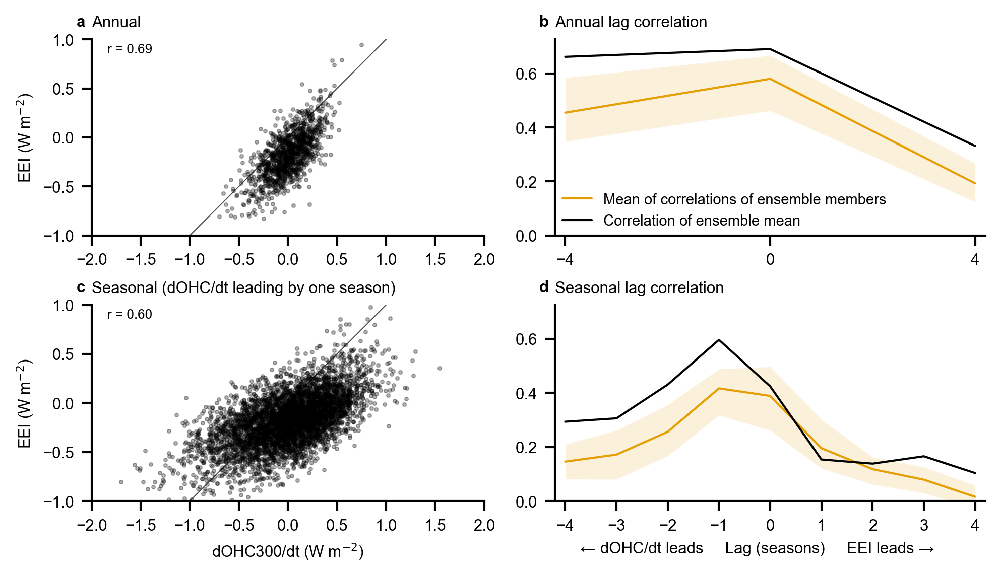

In [ ]:
def plot_ohc_eei_scatter():
    c = "black"

    fig, axs = plt.subplots(2, 2, figsize=(figsize_overwidth_inline[0], 3.7), sharey="col")

    x = average_annually(posterior_global_means_gens)
    # J/m^2 -> (J/yr)/m^2 -> (J/s)/m^2 = W/m^2
    x["ddtohc300"] = x["ohc300"].differentiate("time") / SECONDS_PER_YEAR * OCEAN_FRACTION
    x_mean = x.mean("ens")

    corrs = compute_lag_correlations(x["ddtohc300"], x["eei"], 1)
    corrs = corrs.assign_coords(lag=corrs.lag*4)
    corrs_mean = compute_lag_correlations(x_mean["ddtohc300"], x_mean["eei"], 1)
    corrs_mean = corrs_mean.assign_coords(lag=corrs_mean.lag*4)
    max_lag = corrs_mean.idxmax()
    max_corr = corrs_mean.sel(lag=max_lag)

    ax = axs[0, 0]
    ax.scatter(x_mean["ddtohc300"], x_mean["eei"], s=3, c=c,
               edgecolors=c, alpha=0.3, linewidths=0.5)
    ax.set_aspect("equal")
    ax.plot([-3, 3], [-3, 3], c="black", zorder=-1, lw=0.5, alpha=0.7)
    ax.set_xlim(-2, 2)
    ax.set_ylim(-1, 1)
    ax.set_ylabel(f"EEI ({get_field_unit('eei')})")
    ax.set_title("Annual")
    add_panel_label(ax, "a")
    ax.text(
        0.04, 0.98, f"r = {max_corr.compute().item():.2f}",
        transform=ax.transAxes,
        ha="left", va="top",
        fontsize="small"
    )

    ax = axs[0, 1]
    add_panel_label(ax, "b")
    ax.plot(corrs.lag, corrs.mean("ens"), c="C0", label="Mean of correlations of ensemble members")
    ax.plot(corrs_mean.lag, corrs_mean, c=c, label="Correlation of ensemble mean")
    shade_ci(ax, corrs, x_dim="lag", c="C0")
    # ax.scatter(max_lag, max_corr, c=c)
    ax.set_xlim(-4 * 1.05, 4 * 1.05)
    ax.set_xticks(np.arange(-4, 5, 4))
    ax.set_title("Annual lag correlation")
    ax.legend()

    x = posterior_global_means_gens.copy()
    x["ddtohc300"] = x["ohc300"].differentiate("time") / SECONDS_PER_YEAR * OCEAN_FRACTION
    x_mean = x.mean("ens")

    corrs = compute_lag_correlations(x["ddtohc300"], x["eei"], 1)
    corrs = corrs.assign_coords(lag=corrs.lag*4)
    corrs_mean = compute_lag_correlations(x_mean["ddtohc300"], x_mean["eei"], 1)
    
    corrs_mean = corrs_mean.assign_coords(lag=corrs_mean.lag*4)
    max_lag = corrs_mean.idxmax()
    max_corr = corrs_mean.sel(lag=max_lag)

    ax = axs[1, 0]
    ax.scatter(x_mean["ddtohc300"].values[:-1], x_mean["eei"].values[1:], s=3, c=c,
               edgecolors=c, alpha=0.3, linewidths=0.5)
    # print(x_mean["ddtohc300"].std("time").compute())
    # print(x_mean["eei"].std("time").compute())
    ax.set_aspect("equal")
    ax.plot([-3, 3], [-3, 3], c="black", zorder=-1, lw=0.5, alpha=0.7)
    ax.set_xlim(-2, 2)
    ax.set_ylim(-1, 1)
    ax.set_ylabel(f"EEI ({get_field_unit('eei')})")
    ax.set_xlabel(f"dOHC300/dt ({get_field_unit('eei')})")
    ax.set_title("Seasonal (dOHC/dt leading by one season)")
    add_panel_label(ax, "c")
    ax.text(
        0.04, 0.98, f"r = {max_corr.compute().item():.2f}",
        transform=ax.transAxes,
        ha="left", va="top",
        fontsize="small"
    )

    ax = axs[1, 1]
    add_panel_label(ax, "d")
    ax.plot(corrs.lag, corrs.mean("ens"), c="C0")
    ax.plot(corrs_mean.lag, corrs_mean, c=c)
    shade_ci(ax, corrs, x_dim="lag", c="C0")
    # ax.scatter(max_lag, max_corr, c=c)
    use_zero_ylim(ax)
    ax.set_xlim(-4 * 1.05, 4 * 1.05)
    ax.set_xticks(np.arange(-4, 5, 1))
    ax.set_title("Seasonal lag correlation")
    ax.set_xlabel("← dOHC/dt leads     Lag (seasons)     EEI leads →      ")

    save_plot(plot_folder_si, "parts/ohc_eei_scatter")

plot_ohc_eei_scatter()

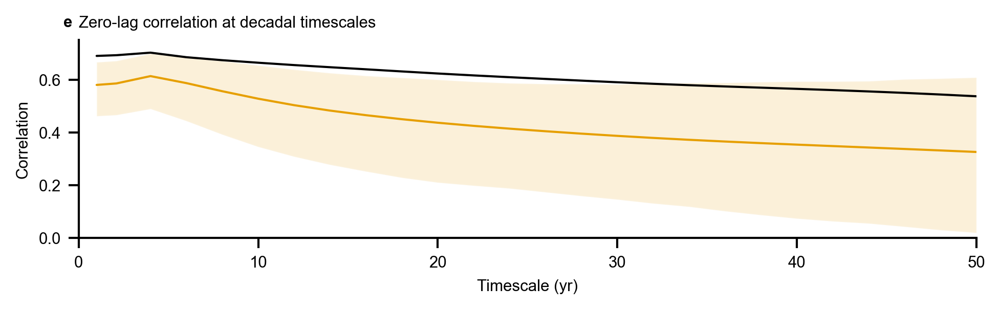

In [501]:
def plot_ohc_eei_timescales():
    x = average_annually(posterior_global_means_gens)
    x["ddtohc300"] = x["ohc300"].differentiate("time") / SECONDS_PER_YEAR * OCEAN_FRACTION
    corrs_ens = xr.concat([
        xr.corr(x["eei"], x["ddtohc300"], "time").assign_coords(cutoff=1)
    ] +[
        xr.corr(lowpass_filter(x["eei"], cutoff), lowpass_filter(x["ddtohc300"], cutoff), "time").assign_coords(cutoff=cutoff)
        for cutoff in [2.1] + list(np.arange(4, 51, 2))
    ], dim="cutoff")

    x = average_annually(posterior_global_means_gens).mean("ens")
    x["ddtohc300"] = x["ohc300"].differentiate("time") / SECONDS_PER_YEAR * OCEAN_FRACTION
    corrs_mean = xr.concat([
        xr.corr(x["eei"], x["ddtohc300"], "time").assign_coords(cutoff=1)
    ] +[
        xr.corr(lowpass_filter(x["eei"], cutoff), lowpass_filter(x["ddtohc300"], cutoff), "time").assign_coords(cutoff=cutoff)
        for cutoff in [2.1] + list(np.arange(4, 51, 2))
    ], dim="cutoff")

    fig, ax = plt.subplots(figsize=(figsize_overwidth_inline[0] - 0.1, 1.9))
    ax.plot(corrs_mean.cutoff, corrs_mean, c="black")
    ax.plot(corrs_ens.cutoff, corrs_ens.mean("ens"), c="C0")
    shade_ci(ax, corrs_ens, x_dim="cutoff")

    ax.set_xlim(0, 50)
    ax.set_ylim(0, 0.75)
    ax.set_xlabel("Timescale (yr)")
    ax.set_ylabel("Correlation")
    ax.set_title("Zero-lag correlation at decadal timescales")
    add_panel_label(ax, 4)

    save_plot(plot_folder_si, "parts/ohc_eei_timescales")

plot_ohc_eei_timescales()

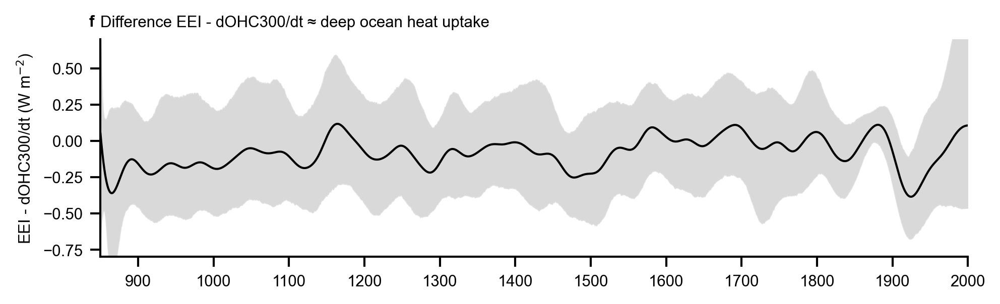

In [ ]:
def plot_ohc_eei_difference():
    fig, ax = plt.subplots(figsize=(figsize_overwidth_inline[0], 1.9))

    x = posterior_global_means_gens.copy()#.isel(time=slice(5, None))
    x["eei"] = anomalize(x["eei"], (1850, 1900)) + 0.07
    # J/m^2 -> (J/yr)/m^2 -> (J/s)/m^2 = W/m^2
    x["ddtohc300"] = x["ohc300"].differentiate("time") / SECONDS_PER_YEAR * OCEAN_FRACTION

    diff = lowpass_filter((x["eei"] - x["ddtohc300"]), 50).sel(time=slice(850, None))

    ax.plot(diff.time, diff.mean("ens"), c="black")
    shade_ci(ax, diff, c="black")

    ax.set_xlim(850, 2000)
    ax.set_xticks(np.arange(900, 2001, 100))
    ax.set_ylim([-0.8, 0.7])
    ax.set_ylabel(f"EEI - dOHC300/dt ({get_field_unit('eei')})")
    # ax.set_xlabel("Year")
    ax.set_title("Difference EEI - dOHC300/dt ≈ deep ocean heat uptake")
    add_panel_label(ax, 5)

    save_plot(plot_folder_si, "parts/ohc_eei_difference")

plot_ohc_eei_difference()

In [ ]:
def print_eei_ohc_std():
    x = posterior_global_means_gens.mean("ens")[["ohc300", "eei"]]
    x["ddtohc300"] = x["ohc300"].differentiate("time") / SECONDS_PER_YEAR * OCEAN_FRACTION

    print("EEI seasonal:", x["eei"].std("time").compute().item())
    print("d/dt OHC seasonal:", x["ddtohc300"].std("time").compute().item())

    print("EEI annual:", average_annually(x["eei"]).std("time").compute().item())
    print("d/dt OHC annual:", average_annually(x["ddtohc300"]).std("time").compute().item())

print_eei_ohc_std()

EEI seasonal: 0.26805710792541504
d/dt OHC seasonal: 0.42036423087120056
EEI annual: 0.23666015810310034
d/dt OHC annual: 0.26772902799768833


TtestResult(statistic=np.float64(277.2342597211261), pvalue=np.float64(0.0), df=np.int64(30328))
TtestResult(statistic=np.float64(277.2342597211261), pvalue=np.float64(0.0), df=np.int64(30328))
TtestResult(statistic=np.float64(106.45567899828337), pvalue=np.float64(0.0), df=np.int64(7570))
TtestResult(statistic=np.float64(106.45567899828337), pvalue=np.float64(0.0), df=np.int64(7570))


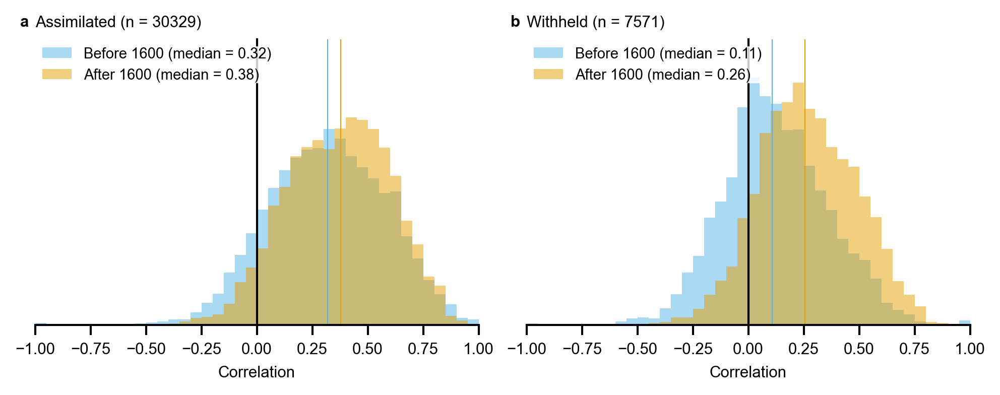

In [87]:
def plot_independent_verification_histogram():
    def _plot(ax, seasonal, annual):
        split = 1600
        seasonal = seasonal.stack(sample=["model", "iteration", "pid"])
        annual = annual.stack(sample=["model", "iteration", "pid"])
        corrs_pre = np.concatenate([
            xr.corr(
                seasonal["true_anoms"].sel(time=slice(None, split)),
                seasonal["estimated_anoms"].sel(time=slice(None, split)),
                "time").values,
            xr.corr(
                annual["true"].sel(time=slice(None, split)),
                annual["estimated"].sel(time=slice(None, split)),
                "time").values,
        ])
        corrs_post = np.concatenate([
            xr.corr(
                seasonal["true_anoms"].sel(time=slice(split, None)),
                seasonal["estimated_anoms"].sel(time=slice(split, None)),
                "time").values,
            xr.corr(
                annual["true"].sel(time=slice(split, None)),
                annual["estimated"].sel(time=slice(split, None)),
                "time").values,
        ])

        # p-value that correlation mean is different from zero
        p_post = scipy.stats.ttest_1samp(corrs_post, 0, nan_policy="omit", alternative="greater")
        print(p_post)
        p_pre = scipy.stats.ttest_1samp(corrs_pre, 0, nan_policy="omit", alternative="greater")
        print(p_post)

        bins = np.arange(-1, 1.01, 0.05)
        ax.hist(corrs_pre, bins=bins, density=True, edgecolor="none",
                color="C1", alpha=0.5,
                label=f"Before {split} (median = {np.nanmedian(corrs_pre):.2f})")
        ax.hist(corrs_post, bins=bins, density=True, edgecolor="none",
                color="C0", alpha=0.5,
                label=f"After {split} (median = {np.nanmedian(corrs_post):.2f})")
        ax.axvline(np.nanmedian(corrs_pre), c="C1", lw=0.5)
        ax.axvline(np.nanmedian(corrs_post), c="C0", lw=0.5)
        ax.spines["left"].set_position('zero')

        return np.sum(~np.isnan(corrs_post))

    fig, axs = plt.subplots(1, 2, figsize=figsize_overwidth_inline, sharey=True, sharex=True)
    n_assimilated = _plot(axs[0], verification_proxies_gens[0], verification_proxies_gens[1])
    n_withheld = _plot(axs[1], verification_proxies_gens[2], verification_proxies_gens[3])

    axs[0].legend(loc="upper left", frameon=True, edgecolor="#FFFF")
    axs[1].legend(loc="upper left", frameon=True, edgecolor="#FFFF")
    axs[0].set_title(f"Assimilated (n = {n_assimilated})")
    axs[1].set_title(f"Withheld (n = {n_withheld})")

    axs[0].set_xlabel("Correlation")
    axs[1].set_xlabel("Correlation")

    vmax = axs[0].get_ylim()[1] * 1.1

    axs[0].set_xticks(np.arange(-1, 1.1, 0.25))
    axs[0].set_yticks(np.linspace(0, vmax, 6))
    axs[0].set_ylim(0, vmax)
    axs[0].set_xlim(-1, 1)
    axs[0].set_yticklabels([])
    axs[1].set_yticklabels([])
    axs[0].tick_params(left=False)
    axs[1].tick_params(left=False)

    add_panel_label(axs[0], 0)
    add_panel_label(axs[1], 1)

    # format_plot(major_grid=True)
    save_plot(plot_folder_si, "parts/independent_verification_histogram")

plot_independent_verification_histogram()

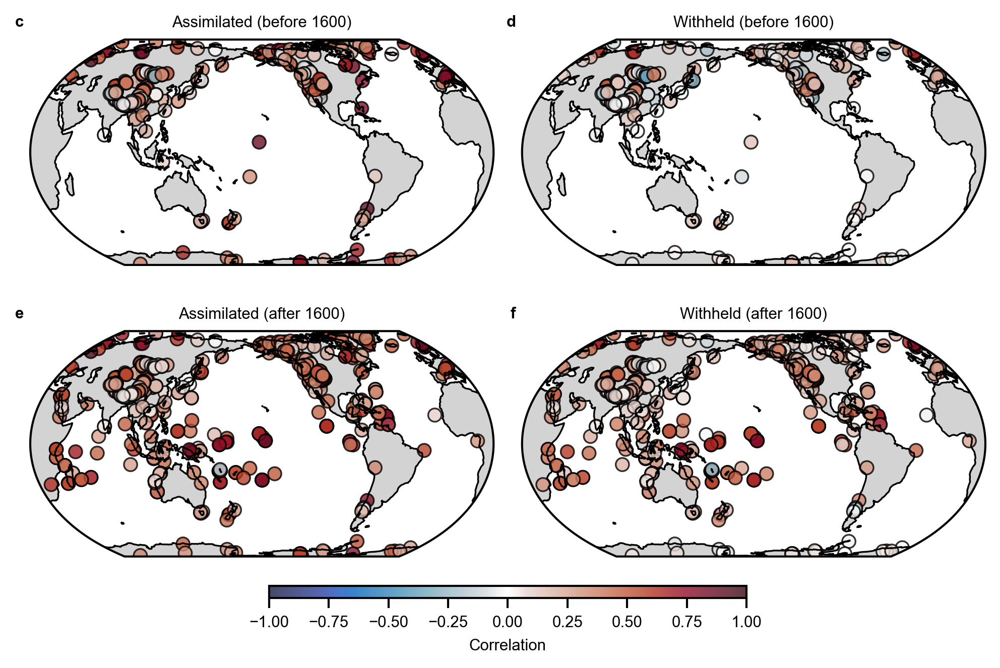

In [88]:
def plot_independent_verification_map():
    split = 1600
    def _plot(axs, seasonal, annual):
        corrs_pre = xr.concat([
            xr.corr(
                seasonal["true_anoms"].sel(time=slice(None, split)),
                seasonal["estimated_anoms"].sel(time=slice(None, split)),
                "time").mean(["iteration", "model"]),
            xr.corr(
                annual["true"].sel(time=slice(None, split)),
                annual["estimated"].sel(time=slice(None, split)),
                "time").mean(["iteration", "model"]),
        ], dim="pid").dropna("pid")
        corrs_post = xr.concat([
            xr.corr(
                seasonal["true_anoms"].sel(time=slice(split, None)),
                seasonal["estimated_anoms"].sel(time=slice(split, None)),
                "time").mean(["iteration", "model"]),
            xr.corr(
                annual["true"].sel(time=slice(split, None)),
                annual["estimated"].sel(time=slice(split, None)),
                "time").mean(["iteration", "model"]),
        ], dim="pid").dropna("pid")
    
        lats_pre, lons_pre = [], []
        for pid in corrs_pre.pid:
            lats_pre.append(pdb[pid.item()].lat)
            lons_pre.append(pdb[pid.item()].lon)

        lats_post, lons_post = [], []
        for pid in corrs_post.pid:
            lats_post.append(pdb[pid.item()].lat)
            lons_post.append(pdb[pid.item()].lon)
        
        axs[0].scatter(lons_pre, lats_pre, c=corrs_pre,
                cmap="balancew", s=40, edgecolors="black", alpha=0.8,
                transform=ccrs.PlateCarree(), vmin=-1, vmax=1)
        return axs[1].scatter(lons_post, lats_post, c=corrs_post,
                cmap="balancew", s=40, edgecolors="black", alpha=0.8,
                transform=ccrs.PlateCarree(), vmin=-1, vmax=1)

    fig, axs = subplots_cartopy(2, 2, figsize=(figsize_overwidth_inline[0], 4.5))
    _plot(axs[:, 0], verification_proxies_gens[0], verification_proxies_gens[1])
    cs = _plot(axs[:, 1], verification_proxies_gens[2], verification_proxies_gens[3])

    fig.colorbar(cs, ax=axs, orientation='horizontal',
                 fraction=0.03, pad=0.05, aspect=40, shrink=0.5, label="Correlation")

    axs[0, 0].set_title(f"Assimilated (before {split})", loc="center")
    axs[1, 0].set_title(f"Assimilated (after {split})", loc="center")
    axs[0, 1].set_title(f"Withheld (before {split})", loc="center")
    axs[1, 1].set_title(f"Withheld (after {split})", loc="center")

    add_panel_label(axs[0, 0], 2)
    add_panel_label(axs[0, 1], 3)
    add_panel_label(axs[1, 0], 4)
    add_panel_label(axs[1, 1], 5)

    for ax in axs.flat:
        ax.set_global()
        ax.add_feature(cartopy.feature.LAND, color="lightgrey")
        ax.coastlines()
    
    save_plot(plot_folder_si, "parts/independent_verification_map")

plot_independent_verification_map()

# Not included

/Users/dstiller/dev/lmrecon/.pixi/envs/default/lib/python3.12/site-packages/xrscipy/signal/filters.py:332: FilteringNaNWarning: data contains NaNs, filter will propagate them
  return frequency_filter(darray, f_cutoff, *args, **kwargs)
/Users/dstiller/dev/lmrecon/.pixi/envs/default/lib/python3.12/site-packages/xrscipy/signal/filters.py:332: FilteringNaNWarning: data contains NaNs, filter will propagate them
  return frequency_filter(darray, f_cutoff, *args, **kwargs)


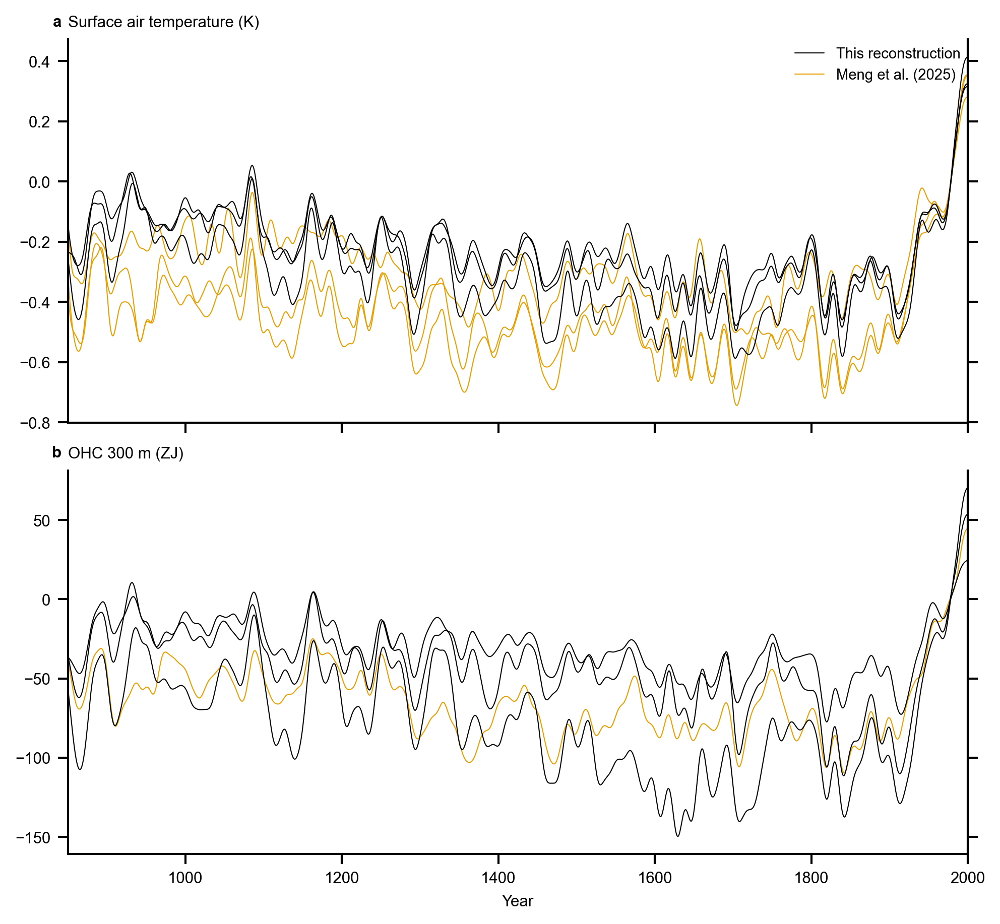

In [ ]:
def plot_global_mean_vs_meng():
    fig, axs = plt.subplots(2, 1, figsize=(figsize_overwidth_inline[0], 6), sharex=True)

    year_start = 850
    year_end = 2000

    for i, (field, ax) in enumerate(zip(["tas", "ohc300_total"], axs)):
        scaling = get_field_scaling(field)

        gens = posterior_global_means_gens
        gens["ohc300_total"] = convert_ohc_per_ocean_area_to_total_ohc(gens["ohc300"])
        gens = average_annually(gens[field]).sel(time=slice(year_start, year_end)) / scaling

        for j, prior in enumerate(posterior_global_means):
            prior["ohc300_total"] = convert_ohc_per_ocean_area_to_total_ohc(prior["ohc300"])
            prior = prior[field].sel(time=slice(year_start, year_end)) / scaling
            prior = lowpass_filter(prior, 20)
            ax.plot(prior.time, prior.mean("ens"), lw=0.5, c="black", label="This reconstruction" if j == 0 else None, zorder=3)

        for j, ens in enumerate(ds_meng25.ens):
            prior = ds_meng25.sel(ens=ens)
            prior["ohc300_total"] = convert_ohc_per_ocean_area_to_total_ohc(prior["ohc300"])
            prior = area_weighted_mean(prior[field]).sel(time=slice(year_start, year_end)) / scaling
            prior = lowpass_filter(prior, 20)
            ax.plot(prior.time, prior, lw=0.5, c="C0", label="Meng et al. (2025)" if j == 0 else None)

        # shade_ci(ax, gens, c="black")

        ax.set_title(get_field_label(field, True, scaling=scaling))

        ax.spines.right.set_visible(True)
        ax.yaxis.set_ticks_position('both')
        ax.yaxis.set_tick_params(right=True)

        add_panel_label(ax, i)
    
    axs[0].legend()

    ax = axs[-1]
    ax.set_xlabel("Year")
    ax.set_xlim(year_start, year_end)

    format_plot()
    # save_plot(plot_folder_si, "timeseries_gm_vs_meng")
    plt.show()

plot_global_mean_vs_meng()

season           
DJF     ddtohc300    0.382438
JJA     ddtohc300    0.526443
MAM     ddtohc300    0.312730
SON     ddtohc300    0.502445
Name: eei, dtype: float64


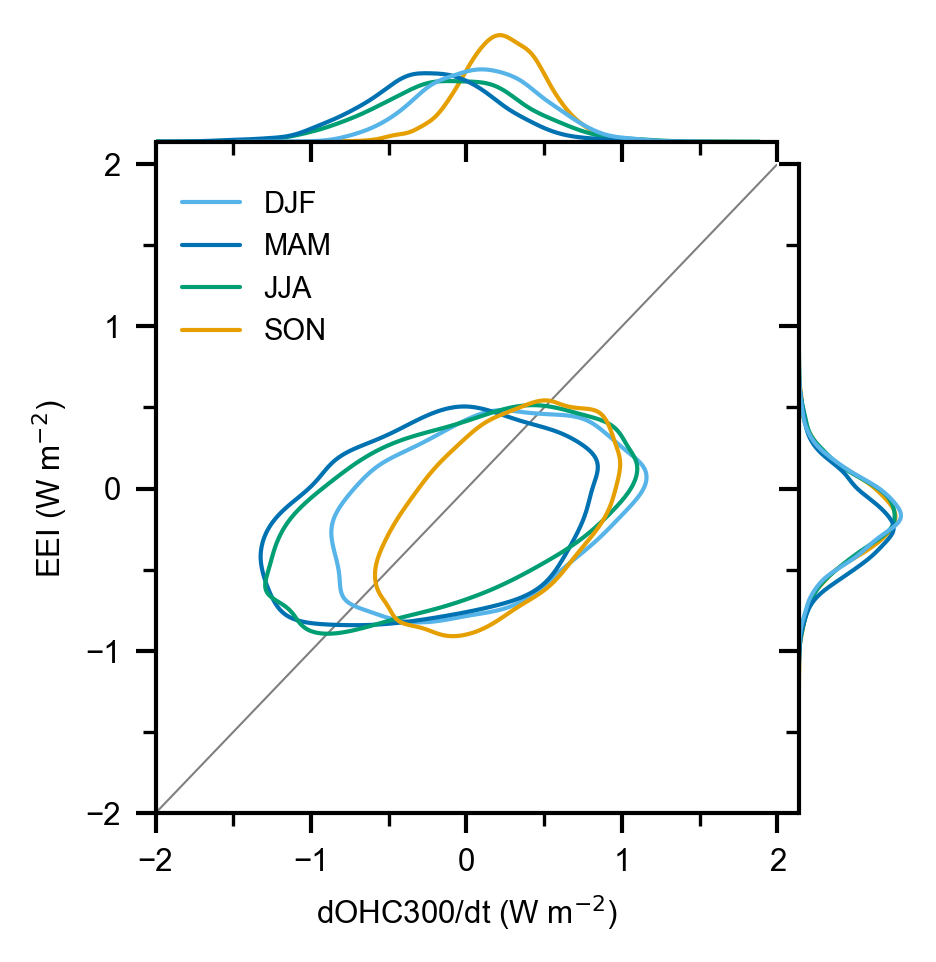

In [ ]:
def plot_ohc_eei_scatter_by_season():
    x = posterior_global_means_gens.mean("ens")
    x["ddtohc300"] = x["ohc300"].differentiate("time") / SECONDS_PER_YEAR * OCEAN_FRACTION
    # x = anomalize(x, (1800, 1900))
    x = x.sel(time=slice(850, 1850))
    # x = x.sel(time=slice(1850, 2000))
    # x = x.sel(time=slice(1970, 2000))
    # x = x.sel(time=slice(1850, 1950))
    # x = x.sel(time=slice(1850, 1900))
    # x = x.sel(time=slice(1900, 1950))
    # x = x.sel(time=slice(1950, 2000))
    x = use_tuple_time_coords(x)
    
    df = pd.DataFrame({
        "ddtohc300": np.concatenate([
            x.sel(season=Season.DJF)["ddtohc300"].values,
            x.sel(season=Season.MAM)["ddtohc300"].values,
            x.sel(season=Season.JJA)["ddtohc300"].values,
            x.sel(season=Season.SON)["ddtohc300"].values,
        ]),
        "eei": np.concatenate([
            x.sel(season=Season.DJF)["eei"].values,
            x.sel(season=Season.MAM)["eei"].values,
            x.sel(season=Season.JJA)["eei"].values,
            x.sel(season=Season.SON)["eei"].values,
        ]),
        "season": (["DJF"] * (len(x.sel(season=Season.DJF)["ddtohc300"].values)) +
                ["MAM"] * (len(x.sel(season=Season.MAM)["ddtohc300"].values)) +
                ["JJA"] * (len(x.sel(season=Season.JJA)["ddtohc300"].values)) +
                ["SON"] * (len(x.sel(season=Season.SON)["ddtohc300"].values)))
    })
    print(df.groupby("season").corr().iloc[0::2,-1])

    vmax = 2
    with mpl.rc_context({'legend.borderpad': 0.4}):
        g = sns.jointplot(data=df, x="ddtohc300", y="eei", hue="season", kind="kde",
                        joint_kws={"levels": 2},
                        xlim=(-vmax, vmax), ylim=(-vmax, vmax),
                        palette=["C1", "C3", "C2", "C0"],
                        height=figsize_halfwidth_inline[0], bw_adjust=1.5)
    
    ax = g.ax_joint
    # ax.set_aspect("equal")
    ax.get_legend().set_title(None)
    ax.plot([-vmax, vmax], [-vmax, vmax], c="black", lw=0.5, alpha=0.5, zorder=-3)
    ax.set_ylabel(f"EEI ({get_field_unit('eei')})")
    ax.set_xlabel(f"dOHC300/dt ({get_field_unit('eei')})")
    ax.tick_params(which="both", left=True, bottom=True)
    ax.set_xticks(np.arange(-vmax, vmax+0.1, 1))
    ax.set_yticks(np.arange(-vmax, vmax+0.1, 1))
    ax.set_xticks(np.arange(-vmax, vmax+0.1, 0.5), minor=True)
    ax.set_yticks(np.arange(-vmax, vmax+0.1, 0.5), minor=True)

    ax = g.ax_marg_x
    ax.tick_params(which="both", bottom=True)
    ax.set_xticks(np.arange(-vmax, vmax+0.1, 0.5), minor=True)

    ax = g.ax_marg_y
    ax.tick_params(which="both", left=True)
    ax.set_yticks(np.arange(-vmax, vmax+0.1, 0.5), minor=True)

    # save_plot(plot_folder_si, "ohc_eei_scatter_by_season")
    plt.show()

plot_ohc_eei_scatter_by_season()

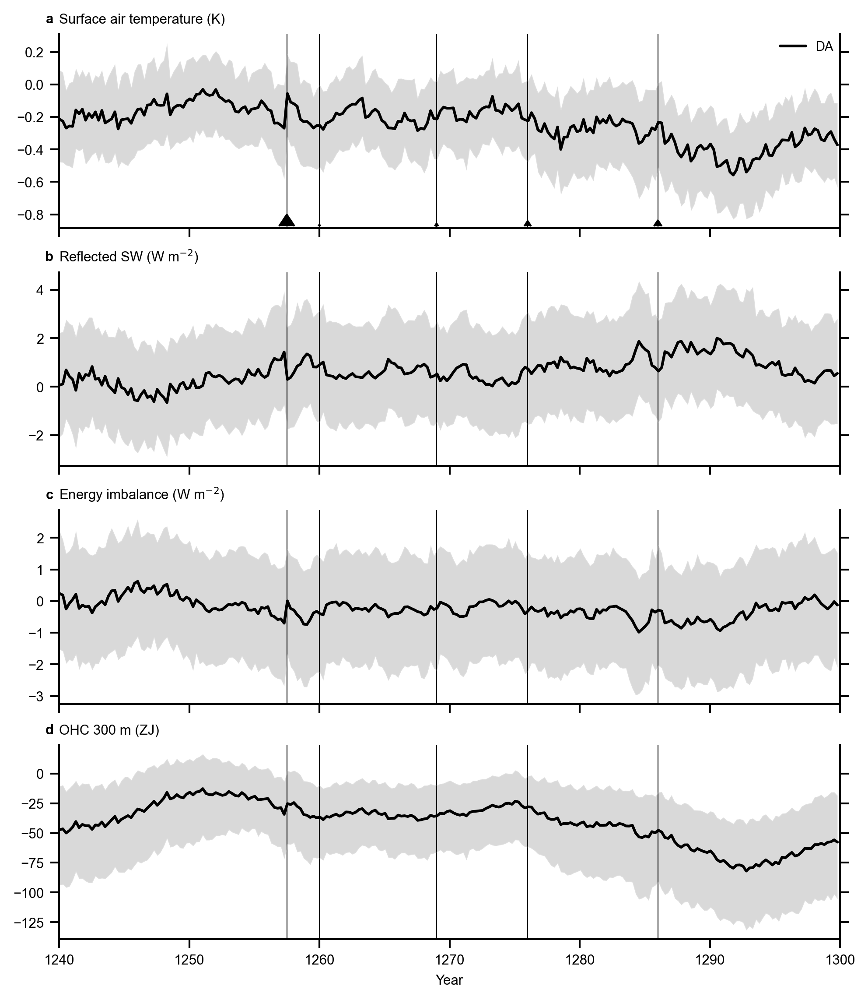

In [ ]:
def plot_global_mean_samalas():
    fig, axs = plt.subplots(4, 1, figsize=(figsize_overwidth_inline[0], 7.5), sharex=True)

    year_start = 1240
    year_end = 1300

    for i, (field, ax) in enumerate(zip(["tas", "rsut", "eei", "ohc300_total"], axs)):
        scaling = get_field_scaling(field)
        
        gens = posterior_global_means_gens
        gens["ohc300_total"] = convert_ohc_per_ocean_area_to_total_ohc(gens["ohc300"])
        gens = gens[field].sel(time=slice(year_start, year_end)) / scaling
        ax.plot(gens.time, gens.mean("ens"), linewidth=1.5, c="black", label="DA", zorder=3)

        shade_ci(ax, gens, c="black")

        if field == "tas":
            trans = mpl.transforms.blended_transform_factory(
                ax.transData, ax.transAxes)
            ax.scatter(ds_eruptions.time, 0.01 * np.ones(len(ds_eruptions.time)), transform=trans,
                       s=ds_eruptions.vssi*1.2, c="black", marker=mpl.markers.CARETUPBASE)
        for t in ds_eruptions.time:
            ax.axvline(t, c="black", zorder=-2, lw=0.5)

        # for x in sims_models:
        #     x = area_weighted_mean(x["ohc300"])
        #     x["ohc300_total"] = convert_ohc_per_ocean_area_to_total_ohc(x["ohc300"])
        #     x = x[field].sel(time=slice(year_start, year_end)) / scaling
        #     ax.plot(x.time, x, c="C0", zorder=-1, lw=0.75)

        ax.set_title(get_field_label(field, True, scaling))

        ax.spines.right.set_visible(True)
        ax.yaxis.set_ticks_position('both')
        ax.yaxis.set_tick_params(right=True)

        add_panel_label(ax, i)

    ax = axs[0]
    ax.legend(ncol=2)

    ax = axs[-1]
    ax.set_xlabel("Year")
    ax.set_xlim(year_start, year_end)

    format_plot()
    save_plot(plot_folder_si, "timeseries_gm_samalas")
    plt.show()

plot_global_mean_samalas()

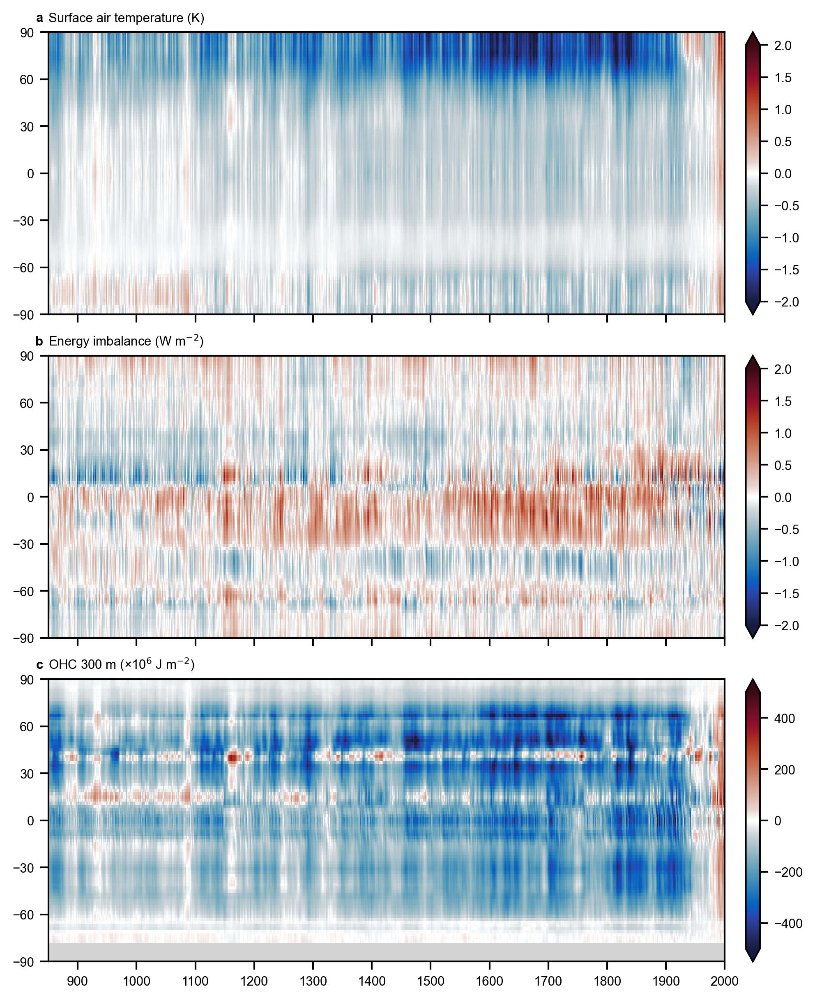

In [ ]:
def plot_zonal_mean(fields, vmaxs):
    fig, axs = plt.subplots(len(fields), 1, figsize=figsize_overwidth_fullpage, sharex=True)

    for i, (ax, field, vmax) in enumerate(zip(axs, fields, vmaxs)):
        x = posterior_zonal_means_gens[field].mean("ens").transpose("lat", "time")#.isel(time=slice(30))
        x = average_annually(x)

        scaling = 1e6 if field == "ohc300" else 1
        plot_hovmoeller(ax, x / scaling, vmin=-vmax, vmax=vmax,
                        cbar_kwargs={"pad": 0.01})
        ax.pcolormesh(x.time, x.lat, np.isnan(x),
                      cmap=mpl.colors.ListedColormap(["#0000", "#D3D3D3FF"]))
        ax.spines.right.set_visible(True)
        ax.spines.top.set_visible(True)
        ax.set_yticks(np.arange(-90, 91, 30))
        ax.set_title(get_field_label(field, True, scaling))
        # ax.text(0.015, 0.965, get_field_label(field, True, scaling),
        #     transform=ax.transAxes, ha='left', va='top',
        #     bbox=dict(fc='white', alpha=0.7),
        #     fontweight='bold')

        add_panel_label(ax, i)

    ax.set_xlim(850, 2000)
    ax.set_xticks(np.arange(900, 2001, 100))

    # save_plot(plot_folder_si, f"timeseries_zm_{"-".join(fields)}")

plot_zonal_mean(["tas", "eei", "ohc300"], [2, 2, 500])
# plot_zonal_mean(["rsut", "rlut"], [3, 3])

<xarray.DataArray 'time' (time: 19)> Size: 152B
array([(1028, <Season.DJF: 0>), (1108, <Season.DJF: 0>),
       (1171, <Season.DJF: 0>), (1191, <Season.DJF: 0>),
       (1230, <Season.DJF: 0>), (1257, <Season.JJA: 2>),
       (1276, <Season.DJF: 0>), (1286, <Season.DJF: 0>),
       (1345, <Season.DJF: 0>), (1458, <Season.DJF: 0>),
       (1585, <Season.DJF: 0>), (1595, <Season.DJF: 0>),
       (1600, <Season.DJF: 0>), (1640, <Season.DJF: 0>),
       (1695, <Season.DJF: 0>), (1809, <Season.DJF: 0>),
       (1815, <Season.MAM: 1>), (1835, <Season.DJF: 0>),
       (1883, <Season.JJA: 2>)], dtype=object)
Coordinates:
  * time     (time) object 152B MultiIndex
  * year     (time) int64 152B 1028 1108 1171 1191 1230 ... 1809 1815 1835 1883
  * season   (time) object 152B Season.DJF Season.DJF ... Season.DJF Season.JJA
    region   <U6 24B 'global'


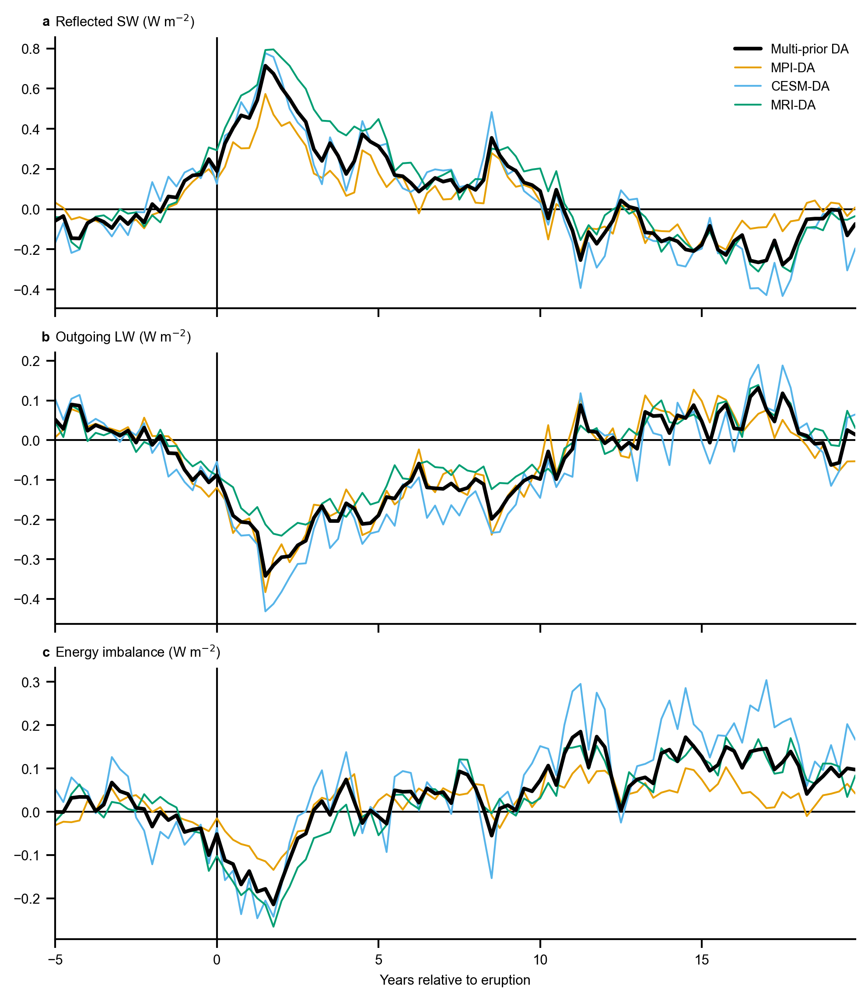

In [145]:
def plot_volcano_composite_supplement2(vssi_min=7.5, lat_max=30, n_before=20, n_after=80, n_climo=20):
    eruptions = use_tuple_time_coords(ds_evolv2k.sel(time=ds_evolv2k["vssi"] >= vssi_min), True).drop_duplicates(dim="time")
    eruptions = eruptions.sel(time=((eruptions.lat >= -lat_max) & (eruptions.lat < lat_max)))

    recon = xr.concat(posterior_global_means, dim="model").mean("ens")
    recon = use_tuple_time_coords(recon)

    eruption_times, eruptions = xr.align(recon.time, eruptions, join="inner")
    recon_sel = []
    for i, (eruption_time, eruption_time_next) in enumerate(list(pairwise(eruption_times)) + [(eruption_times[-1], None)]):
        idx = recon.get_index("time").get_loc(eruption_time.item())
        # Trim if there is another eruption within the window
        recon_eruption = use_decimal_year_time_coords(
            recon.isel(time=slice(idx-n_before, idx+n_after)).sel(time=slice(None, eruption_time_next))
        )
        climo = recon.isel(time=slice(idx-n_climo, idx)).groupby("season").mean("time").compute()
        recon_sel.append(
            (add_season_coords(recon_eruption).groupby("season") - climo)
            .assign_coords(eruption=i, time=np.arange(-n_before, -n_before + len(recon_eruption.time)))
        )
    recon_sel = xr.concat(recon_sel, dim="eruption").mean("eruption")
    print(eruption_times)

    fig, axs = plt.subplots(3, 1, figsize=(figsize_overwidth_inline[0], 7.5), sharex=True)

    for i, (field, ax) in enumerate(zip(["rsut", "rlut", "eei"], axs.flat)):
        ax.axvline(0, c="black")
        # ax.axvline(1, c="black")
        # ax.axvline(2, c="black")
        # ax.axvline(3, c="black")
        # ax.axvline(4, c="black")
        ax.axhline(0, c="black")

        ax.plot(recon_sel.time / 4, recon_sel[field].mean("model"),
                c="black", lw=2, label="Multi-prior DA", zorder=3)

        for model in recon_sel.model:
            ax.plot(recon_sel.time / 4, recon_sel[field].sel(model=model),
                    label=labels[model.item()])

        ax.set_xlim(-n_before/4, (n_after-1)/4)
        ax.set_title(f"{get_field_label(field, True)}")
        add_panel_label(ax, i)
        if field.startswith("siarea"):
            ax.set_ylim([-0.4, 0.6])

    axs[-1].set_xlabel("Years relative to eruption")
    axs[0].legend()
    
    format_plot()
    # save_plot(plot_folder_si, "composite_volcano_supplement2")


plot_volcano_composite_supplement2()

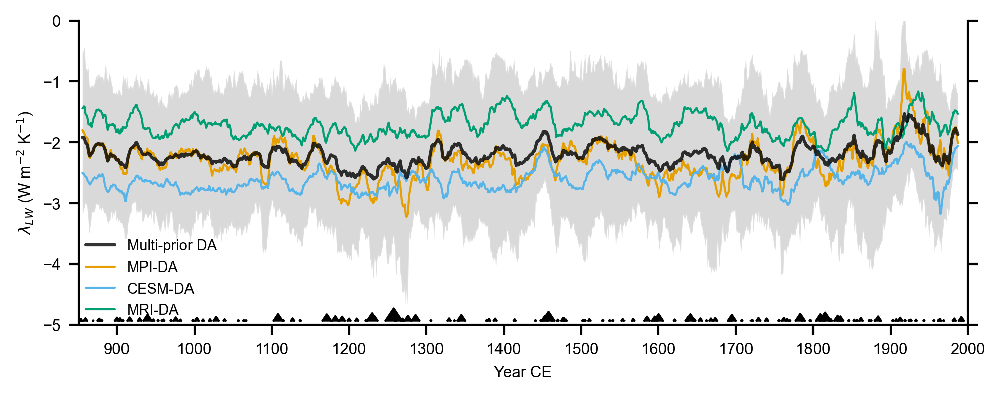

In [ ]:
def _estimate_feedback(dN, dT, window):
    anoms = anomalize(xr.merge([
        average_annually(dN).rename("N"), average_annually(dT).rename("T")
    ]).compute(), (1835, 1866))
    windows = anoms.rolling(time=window, center=True).construct("window").dropna("time").compute()
    lmbda = xr.apply_ufunc(
        lambda N, T: np.polyfit(T, N, 1)[0],
        windows["N"],
        windows["T"],
        input_core_dims=[["window"], ["window"]],
        vectorize=True,
        dask="parallelized",
        output_dtypes=[dN.dtype],
    )
    return lmbda

def _select_feedback_field(ftype):
    return {
        "lambda_lw": "rlut",
        "lambda_sw": "rsut",
        "lambda": "eei",
    }[ftype]

def _select_feedback_sign(ftype):
    return {
        "lambda_lw": -1,
        "lambda_sw": -1,
        "lambda": 1,
    }[ftype]

def _select_feedback_title(ftype):
    return {
        "lambda_lw": r"$\lambda_{LW}$",
        "lambda_sw": r"$\lambda_{SW}$",
        "lambda": r"$\lambda$",
    }[ftype]

def estimate_feedback_seasonal(ftype="lambda"):
    fig, ax = plt.subplots(figsize=figsize_overwidth_inline)

    rad_field = _select_feedback_field(ftype)
    sign = _select_feedback_sign(ftype)
    title = _select_feedback_title(ftype)

    lmbdas = {}
    lmbdas_gens = []
    for ds, model in zip(posterior_global_means, labels):
        subens = subsample_ensemble(ds, 25)#.sel(time=slice(850, 1050))

        lmbdas_prior = []
        for ens in subens.ens:
            lmbda = sign * _estimate_feedback(
                subens.sel(ens=ens)[rad_field],
                subens.sel(ens=ens)["tas"],
                30
            )
            lmbdas_prior.append(lmbda.drop_vars("ens"))
            # ax.plot(lmbda.time, lmbda, c="black", alpha=0.4, lw=0.5, zorder=-1)

        lmbdas[model] = xr.concat(lmbdas_prior, dim="ens").mean("ens")
        lmbdas_gens.extend(lmbdas_prior)
    
    lmbda_gens = xr.concat(lmbdas_gens, dim="ens")
    ax.plot(lmbda_gens.time, lmbda_gens.mean("ens"), c="black", lw=1.5,
            label="Multi-prior DA", alpha=0.8, zorder=3)
    shade_ci(ax, lmbda_gens, c="black")

    for model, lmbda in lmbdas.items():
        ax.plot(lmbda.time, lmbda, label=model)

    ax.spines.right.set_visible(True)
    ax.yaxis.set_ticks_position('both')
    ax.yaxis.set_tick_params(right=True)

    ax.set_xlabel("Year CE")
    ax.set_ylabel(title + r" (W m$^{-2}$ K$^{-1}$)")
    # ax.set_title(f"{title} (30-year window)")

    ax.set_xlim(850, 2000)
    ax.set_xticks(np.arange(900, 2001, 100))

    ax.set_ylim([-5, 0])
    ax.legend()

    trans = mpl.transforms.blended_transform_factory(
                ax.transData, ax.transAxes)
    ax.scatter(ds_eruptions.time, 0.01 * np.ones(len(ds_eruptions.time)), transform=trans,
                s=ds_eruptions.vssi*1.2, c="black", marker=mpl.markers.CARETUPBASE)

    # save_plot(plot_folder_si, f"timeseries_{ftype}")
    plt.show()
    
# estimate_feedback_seasonal("lambda")
# estimate_feedback_seasonal("lambda_sw")
estimate_feedback_seasonal("lambda_lw")

eei 0.414863828200788 -0.854824260090755
eei_inferred 1.1263832782610477 -0.47181162214810246
rsut 3.4126390960149973 1.0845616359158607
rlut -1.9816456393716315 -1.4718394038603158


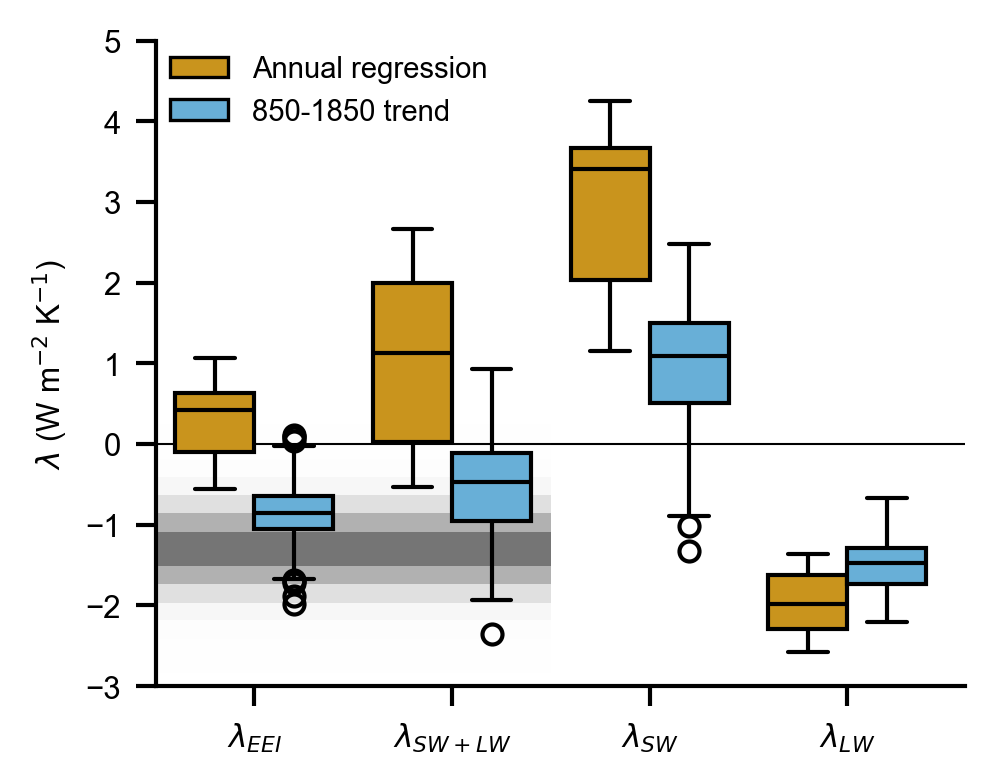

In [ ]:
def plot_lambda():
    def get_reg(tas, eei):
        tas = average_annually(tas)
        eei = average_annually(eei)
        tas = tas.transpose(..., "ens").values
        eei = eei.transpose(..., "ens").values
        return np.array([np.polyfit(tas[:, i], eei[:, i], 1)[0] for i in range(tas.shape[-1])])

    def get_trend(tas, eei):
        trend_tas = tas.polyfit("time", 1)["polyfit_coefficients"].values[0]
        trend_eei = eei.polyfit("time", 1)["polyfit_coefficients"].values[0]
        return trend_eei / trend_tas

    lambda_reg = []
    lambda_trend = []

    ds = posterior_global_means_gens
    # ds = anomalize(ds, (1835, 1875))
    ds = ds.compute().sel(time=slice(850, 1850))
    for type in ["eei", "eei_inferred", "rsut", "rlut"]:
        tas = ds["tas"]
        match type:
            case "eei": eei = ds["eei"]
            case "eei_inferred": eei = -(ds["rsut"] + ds["rlut"])
            case "rsut": eei = -ds["rsut"]
            case "rlut": eei = -ds["rlut"]
        
        lambda_reg.append(get_reg(tas, eei))
        lambda_trend.append(get_trend(tas, eei))
        print(type, np.median(lambda_reg[-1]), np.median(lambda_trend[-1]))
    
    da = xr.DataArray(np.array([np.array(lambda_reg), 
                     np.array(lambda_trend)]).squeeze(), dims=["method", "type", "ens"])
    da = da.assign_coords(type=[r"$\lambda_{EEI}$", r"$\lambda_{SW+LW}$", r"$\lambda_{SW}$", r"$\lambda_{LW}$"],
                          method=["Annual regression", "850-1850 trend"])
    df = da.to_dataframe(name="lambda").reset_index()

    fig, ax = plt.subplots(figsize=figsize_halfwidth_inline)
    sns.boxplot(data=df, x="type", y="lambda", hue="method", orient="v", ax=ax, linecolor="black")
    ax.legend_.set_title(None)
    ax.legend(loc="upper left")
    ax.set_ylabel(r"$\lambda$ (W m$^{-2}$ K$^{-1}$)")
    ax.set_xlabel(None)
    ax.set_ylim(-3, 5)
    ax.axhline(0, lw=0.5, c="black", zorder=-3)
    # ax.grid(which="major", axis="y")
    ax.set_yticks(np.arange(-3, 6))

    yy = np.linspace(-3, 5)
    lambda_sherwood = scipy.stats.norm.pdf(yy, loc=-1.3, scale=0.44)
    levels = scipy.stats.norm.pdf(np.arange(5, 0, -0.5)) / 0.44
    ax.contourf([-0.5, 1.5], yy, np.vstack([lambda_sherwood, lambda_sherwood]).T, levels=np.concat([levels, [1]]),
                cmap=mpl.colors.LinearSegmentedColormap.from_list("", ["#FFF0", "#000A"]))

    save_plot(plot_folder_pub, "lambda_summary")

plot_lambda()

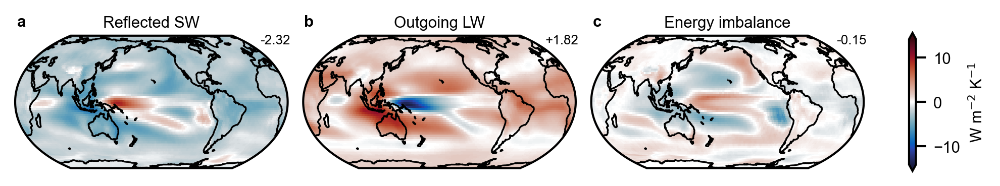

In [ ]:
def plot_tas_toa_regression():
    fields = ["rsut", "rlut", "eei"]
    fig, axs = subplots_cartopy(1, len(fields), figsize=(figsize_overwidth_inline[0], 1.3))

    tas = area_weighted_mean(posterior_mean_gens["tas"])
    regs = [
        regress_field(posterior_mean_gens[f], tas)
        # regress_field(posterior_mean_gens[f], area_weighted_mean(posterior_mean_gens["tas"])) / posterior_mean_gens[f].std("time")
        for f in fields
    ]
    plot_field(axs, regs, cbar_orientation="vertical",
               cbar_kwargs={"shrink": 0.75}, cbar_label=r"W m$^{-2}$ K$^{-1}$")
    
    for i, (ax, field, reg) in enumerate(zip(axs, fields, regs)):
        ax.set_title(get_field_label(field), loc="center", pad=4)
        add_panel_label(ax, i, xytext=(5, 4.5))
        ax.text(
            1.01, 1.01, f"{area_weighted_mean(reg).compute().item():+.2f}",
            transform=ax.transAxes,
            ha="right", va="top",
            fontsize="small",
        )
    
    # save_plot(plot_folder_si, "map_tas_toa_regression")

plot_tas_toa_regression()

Mean of corr: 0.7081387228957898
Corr of mean: 0.8925612007571065


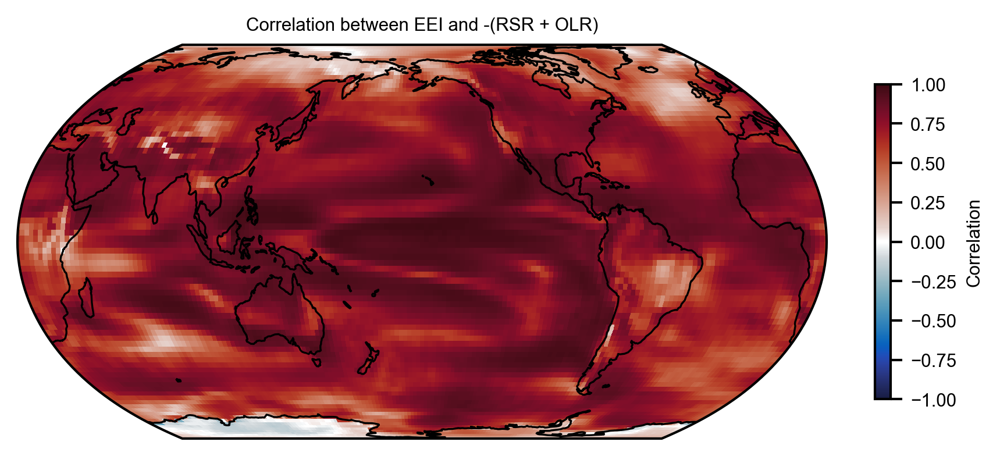

In [ ]:
def plot_eei_rsut_rlut_consistency():
    eei = posterior_mean_gens["eei_direct"]
    eei_inf = posterior_mean_gens["eei"]
    corr = xr.corr(eei, eei_inf, "time")

    print("Mean of corr:", area_weighted_mean(corr).compute().item())
    print("Corr of mean:", xr.corr(
        area_weighted_mean(eei), area_weighted_mean(eei_inf), "time"
    ).compute().item())

    fig, ax = subplots_cartopy(figsize=(figsize_overwidth_inline))
    plot_field(ax, corr, vmin=-1, vmax=1, cbar_kwargs={"shrink": 0.8},
               extend="neither", cbar_orientation="vertical", cbar_label="Correlation")
    ax.set_title("Correlation between EEI and -(RSR + OLR)", loc="center")

    # Only test significance for regions with corr < 0.15 to accelerate the MC computation
    # p = compute_correlation_significance(eei, eei_inf, n_surr=200, corr_threshold=0.15)
    # cs = ax.contourf(corr.lon, corr.lat, (p >= 0.05) | (corr < 0),
    #                  hatches=[None, "..."], colors="none", edgecolor="black",
    #                 transform=ccrs.PlateCarree())
    # cs._hatch_color = (0.0, 0.0, 0.0, 1.0)
    
    # save_plot(plot_folder_si, "map_eei_rsut_rlut_consistency")

plot_eei_rsut_rlut_consistency()